# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](https://github.com/xlnwel/deep-learning/blob/master/dcgan-svhn/assets/SVHN_examples.png?raw=1)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [0]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
!pip install tqdm
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

    100% |████████████████████████████████| 51kB 4.8MB/s 


SVHN Training Set: 182MB [00:13, 13.9MB/s]                           
SVHN Testing Set: 64.3MB [00:06, 10.2MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [0]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

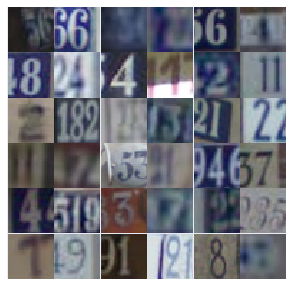

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [0]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [0]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [0]:
def model_inputs(real_dim, z_dim):
    with tf.device('/cpu:0'):
        inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
        inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](https://github.com/xlnwel/deep-learning/blob/master/dcgan-svhn/assets/dcgan.png?raw=1)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [0]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse), tf.device('/gpu:0'):
        # First fully connected layer
        x = tf.layers.dense(z, 4 * 4 * 1024)
        x = tf.reshape(x, [-1, 4, 4, 1024])
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha * x, x)
        
        for i in range(2):
            x = tf.layers.conv2d_transpose(x, 512 // 2**i, 5, 2, padding='same')
            x = tf.layers.batch_normalization(x, training=training)
            x = tf.maximum(alpha * x, x)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x, output_dim, 5, 2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [0]:
def discriminator(x, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('discriminator', reuse=reuse), tf.device('/gpu:0'):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, 5, 2, padding='same')
        x = tf.maximum(alpha * x, x)
        
        for i in range(2):
            x = tf.layers.conv2d(x, 128 * 2**i, 5, 2, padding='same')
            x = tf.layers.batch_normalization(x, training=training)
            x = tf.maximum(alpha * x, x)
        
        x = tf.reshape(x, [-1, 4 * 4 * 256])
        logits = tf.layers.dense(x, 1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [0]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    with tf.device('/gpu:0'):
        g_model = generator(input_z, output_dim, alpha=alpha)
        d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
        d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

        d_loss_real = tf.reduce_mean(
            tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
        d_loss_fake = tf.reduce_mean(
            tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
        g_loss = tf.reduce_mean(
            tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

        d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [0]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    with tf.device('/gpu:0'):
        # Get weights and bias to update
        t_vars = tf.trainable_variables()
        d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
        g_vars = [var for var in t_vars if var.name.startswith('generator')]

        # Optimize
        with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
            d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
            g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [0]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [0]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [0]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [0]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.001
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.0043... Generator Loss: 12.2958
Epoch 1/25... Discriminator Loss: 0.0030... Generator Loss: 17.5247
Epoch 1/25... Discriminator Loss: 0.0602... Generator Loss: 9.7625
Epoch 1/25... Discriminator Loss: 0.1390... Generator Loss: 5.1396
Epoch 1/25... Discriminator Loss: 0.1292... Generator Loss: 6.2911
Epoch 1/25... Discriminator Loss: 4.6385... Generator Loss: 7.7971
Epoch 1/25... Discriminator Loss: 0.5710... Generator Loss: 1.7097
Epoch 1/25... Discriminator Loss: 0.7202... Generator Loss: 1.3793
Epoch 1/25... Discriminator Loss: 0.3167... Generator Loss: 2.0422
Epoch 1/25... Discriminator Loss: 1.4486... Generator Loss: 0.7297


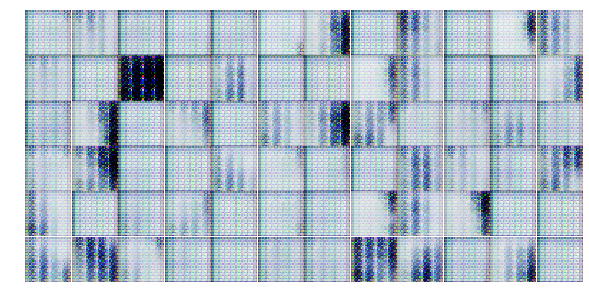

Epoch 1/25... Discriminator Loss: 0.2634... Generator Loss: 2.1902
Epoch 1/25... Discriminator Loss: 0.2113... Generator Loss: 2.9595
Epoch 1/25... Discriminator Loss: 0.8986... Generator Loss: 0.6456
Epoch 1/25... Discriminator Loss: 0.4192... Generator Loss: 2.4561
Epoch 1/25... Discriminator Loss: 4.1085... Generator Loss: 8.6688
Epoch 1/25... Discriminator Loss: 0.8517... Generator Loss: 3.5186
Epoch 1/25... Discriminator Loss: 0.3230... Generator Loss: 1.8141
Epoch 1/25... Discriminator Loss: 0.4389... Generator Loss: 1.4096
Epoch 1/25... Discriminator Loss: 0.7084... Generator Loss: 2.7122
Epoch 1/25... Discriminator Loss: 1.9963... Generator Loss: 5.8488


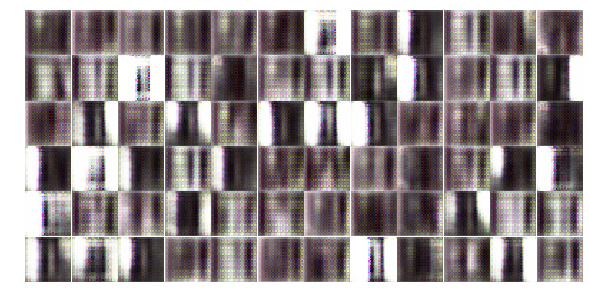

Epoch 1/25... Discriminator Loss: 3.0586... Generator Loss: 0.1234
Epoch 1/25... Discriminator Loss: 0.4329... Generator Loss: 1.3808
Epoch 1/25... Discriminator Loss: 0.1950... Generator Loss: 2.3775
Epoch 1/25... Discriminator Loss: 2.4528... Generator Loss: 4.5080
Epoch 1/25... Discriminator Loss: 0.4836... Generator Loss: 1.8874
Epoch 1/25... Discriminator Loss: 0.9074... Generator Loss: 1.9094
Epoch 1/25... Discriminator Loss: 1.2513... Generator Loss: 3.0852
Epoch 1/25... Discriminator Loss: 1.1432... Generator Loss: 0.8650
Epoch 1/25... Discriminator Loss: 0.5970... Generator Loss: 2.0363
Epoch 1/25... Discriminator Loss: 1.6299... Generator Loss: 0.6031


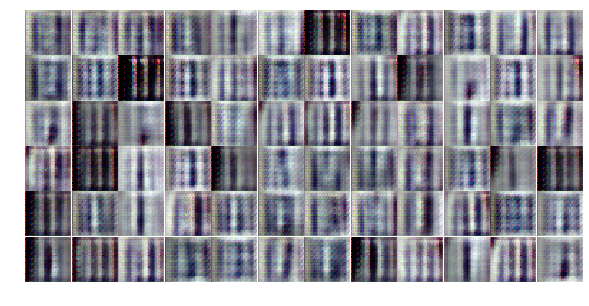

Epoch 1/25... Discriminator Loss: 0.6214... Generator Loss: 1.0184
Epoch 1/25... Discriminator Loss: 0.4442... Generator Loss: 1.4277
Epoch 1/25... Discriminator Loss: 0.7937... Generator Loss: 2.1552
Epoch 1/25... Discriminator Loss: 0.3051... Generator Loss: 1.9931
Epoch 1/25... Discriminator Loss: 0.4440... Generator Loss: 3.1639
Epoch 1/25... Discriminator Loss: 0.6410... Generator Loss: 2.3618
Epoch 1/25... Discriminator Loss: 2.4235... Generator Loss: 3.3066
Epoch 1/25... Discriminator Loss: 1.2409... Generator Loss: 0.6294
Epoch 1/25... Discriminator Loss: 0.6244... Generator Loss: 1.0998
Epoch 1/25... Discriminator Loss: 0.1572... Generator Loss: 2.6825


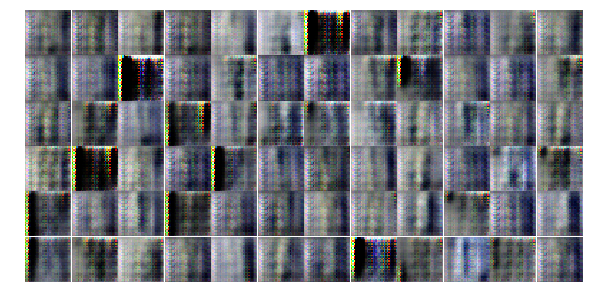

Epoch 1/25... Discriminator Loss: 0.9900... Generator Loss: 3.2107
Epoch 1/25... Discriminator Loss: 1.0603... Generator Loss: 1.1670
Epoch 1/25... Discriminator Loss: 0.5520... Generator Loss: 1.3736
Epoch 1/25... Discriminator Loss: 0.9224... Generator Loss: 2.3636
Epoch 1/25... Discriminator Loss: 1.1004... Generator Loss: 0.7613
Epoch 1/25... Discriminator Loss: 0.9492... Generator Loss: 0.9536
Epoch 1/25... Discriminator Loss: 1.5016... Generator Loss: 1.4522
Epoch 1/25... Discriminator Loss: 2.1233... Generator Loss: 4.0015
Epoch 1/25... Discriminator Loss: 0.8164... Generator Loss: 0.8266
Epoch 1/25... Discriminator Loss: 1.7148... Generator Loss: 0.2648


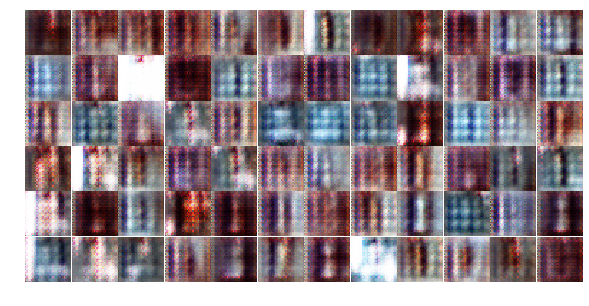

Epoch 1/25... Discriminator Loss: 0.7787... Generator Loss: 1.0186
Epoch 1/25... Discriminator Loss: 0.7452... Generator Loss: 2.2806
Epoch 1/25... Discriminator Loss: 4.2304... Generator Loss: 0.0575
Epoch 1/25... Discriminator Loss: 0.7826... Generator Loss: 1.3946
Epoch 1/25... Discriminator Loss: 0.7214... Generator Loss: 1.2285
Epoch 1/25... Discriminator Loss: 1.3889... Generator Loss: 0.4965
Epoch 1/25... Discriminator Loss: 0.1970... Generator Loss: 2.8607
Epoch 2/25... Discriminator Loss: 4.2978... Generator Loss: 0.1286
Epoch 2/25... Discriminator Loss: 0.3272... Generator Loss: 1.9591
Epoch 2/25... Discriminator Loss: 0.8686... Generator Loss: 0.8293


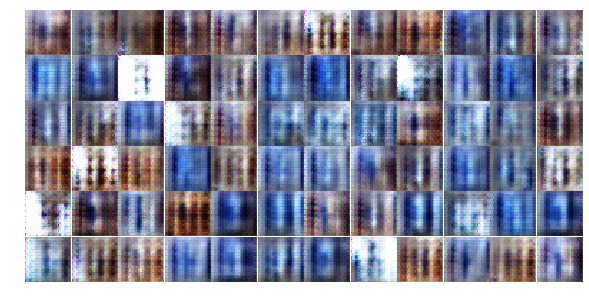

Epoch 2/25... Discriminator Loss: 1.2226... Generator Loss: 0.7995
Epoch 2/25... Discriminator Loss: 1.4449... Generator Loss: 1.8140
Epoch 2/25... Discriminator Loss: 0.5516... Generator Loss: 1.4132
Epoch 2/25... Discriminator Loss: 0.8439... Generator Loss: 1.2545
Epoch 2/25... Discriminator Loss: 2.1418... Generator Loss: 2.5974
Epoch 2/25... Discriminator Loss: 0.8693... Generator Loss: 1.3963
Epoch 2/25... Discriminator Loss: 1.0444... Generator Loss: 1.0153
Epoch 2/25... Discriminator Loss: 1.3411... Generator Loss: 0.4085
Epoch 2/25... Discriminator Loss: 0.5187... Generator Loss: 1.8595
Epoch 2/25... Discriminator Loss: 1.5208... Generator Loss: 0.7018


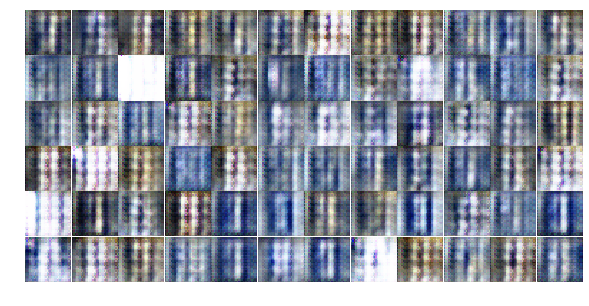

Epoch 2/25... Discriminator Loss: 1.2571... Generator Loss: 0.7917
Epoch 2/25... Discriminator Loss: 1.0765... Generator Loss: 0.9472
Epoch 2/25... Discriminator Loss: 1.1696... Generator Loss: 0.8907
Epoch 2/25... Discriminator Loss: 1.2850... Generator Loss: 1.2125
Epoch 2/25... Discriminator Loss: 0.8724... Generator Loss: 0.8757
Epoch 2/25... Discriminator Loss: 1.9221... Generator Loss: 0.7253
Epoch 2/25... Discriminator Loss: 1.2682... Generator Loss: 0.7960
Epoch 2/25... Discriminator Loss: 1.0747... Generator Loss: 0.8383
Epoch 2/25... Discriminator Loss: 1.3363... Generator Loss: 0.8030
Epoch 2/25... Discriminator Loss: 1.1020... Generator Loss: 1.0835


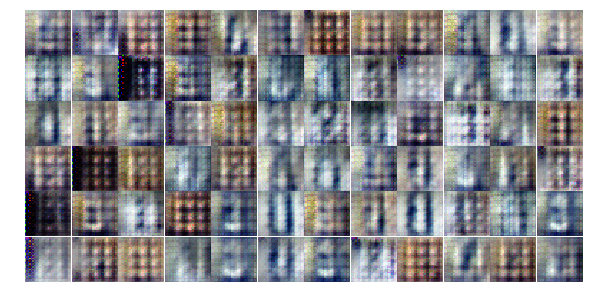

Epoch 2/25... Discriminator Loss: 1.3893... Generator Loss: 0.7410
Epoch 2/25... Discriminator Loss: 1.0348... Generator Loss: 1.0929
Epoch 2/25... Discriminator Loss: 0.9952... Generator Loss: 1.5396
Epoch 2/25... Discriminator Loss: 1.1884... Generator Loss: 1.4690
Epoch 2/25... Discriminator Loss: 0.9580... Generator Loss: 1.2589
Epoch 2/25... Discriminator Loss: 1.2199... Generator Loss: 1.9508
Epoch 2/25... Discriminator Loss: 0.8707... Generator Loss: 1.2835
Epoch 2/25... Discriminator Loss: 2.0679... Generator Loss: 0.1954
Epoch 2/25... Discriminator Loss: 1.1808... Generator Loss: 1.3285
Epoch 2/25... Discriminator Loss: 1.2716... Generator Loss: 0.4517


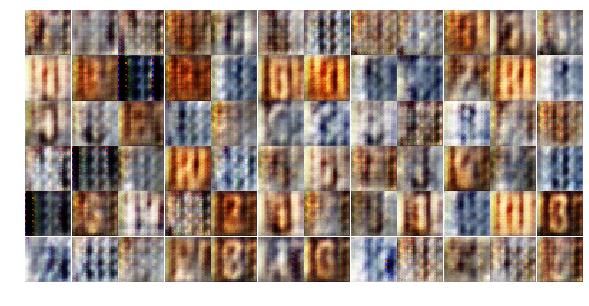

Epoch 2/25... Discriminator Loss: 2.2999... Generator Loss: 1.9337
Epoch 2/25... Discriminator Loss: 0.9316... Generator Loss: 0.9714
Epoch 2/25... Discriminator Loss: 0.6762... Generator Loss: 1.2941
Epoch 2/25... Discriminator Loss: 1.0543... Generator Loss: 0.9744
Epoch 2/25... Discriminator Loss: 0.5424... Generator Loss: 1.1388
Epoch 2/25... Discriminator Loss: 1.0336... Generator Loss: 0.8133
Epoch 2/25... Discriminator Loss: 0.6204... Generator Loss: 1.4567
Epoch 2/25... Discriminator Loss: 0.9101... Generator Loss: 1.4129
Epoch 2/25... Discriminator Loss: 1.1293... Generator Loss: 1.2952
Epoch 2/25... Discriminator Loss: 0.8438... Generator Loss: 1.2615


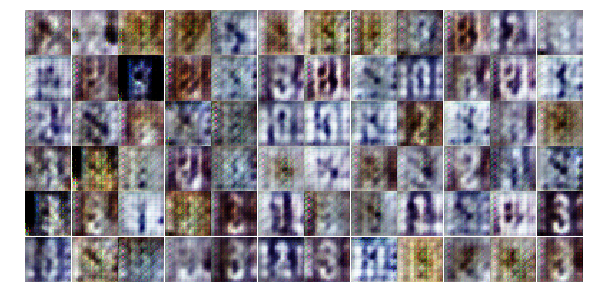

Epoch 2/25... Discriminator Loss: 1.1116... Generator Loss: 1.6925
Epoch 2/25... Discriminator Loss: 2.0806... Generator Loss: 0.1991
Epoch 2/25... Discriminator Loss: 1.0479... Generator Loss: 1.5776
Epoch 2/25... Discriminator Loss: 1.3005... Generator Loss: 0.7629
Epoch 2/25... Discriminator Loss: 1.5035... Generator Loss: 2.1436
Epoch 2/25... Discriminator Loss: 1.3028... Generator Loss: 1.4736
Epoch 2/25... Discriminator Loss: 1.1077... Generator Loss: 0.8769
Epoch 2/25... Discriminator Loss: 0.8471... Generator Loss: 2.3916
Epoch 2/25... Discriminator Loss: 1.3119... Generator Loss: 0.5388
Epoch 2/25... Discriminator Loss: 1.3059... Generator Loss: 0.5631


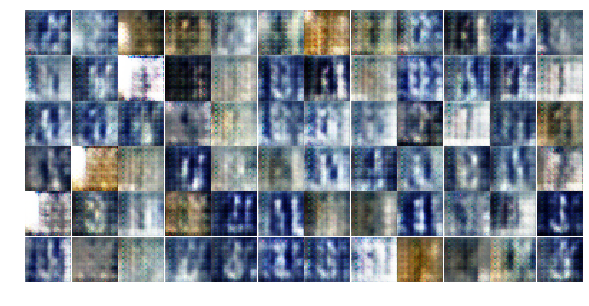

Epoch 2/25... Discriminator Loss: 1.1531... Generator Loss: 0.9626
Epoch 2/25... Discriminator Loss: 0.8086... Generator Loss: 1.0963
Epoch 2/25... Discriminator Loss: 1.3330... Generator Loss: 0.5963
Epoch 2/25... Discriminator Loss: 1.1767... Generator Loss: 0.7742
Epoch 3/25... Discriminator Loss: 1.2443... Generator Loss: 0.4684
Epoch 3/25... Discriminator Loss: 1.3385... Generator Loss: 0.6698
Epoch 3/25... Discriminator Loss: 0.5847... Generator Loss: 1.5484
Epoch 3/25... Discriminator Loss: 1.3856... Generator Loss: 0.8390
Epoch 3/25... Discriminator Loss: 1.6355... Generator Loss: 1.4951
Epoch 3/25... Discriminator Loss: 0.9760... Generator Loss: 0.8415


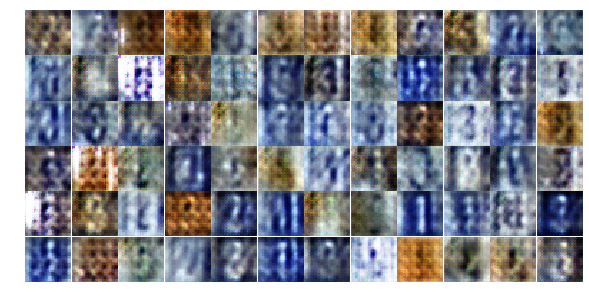

Epoch 3/25... Discriminator Loss: 1.5060... Generator Loss: 0.4079
Epoch 3/25... Discriminator Loss: 1.1366... Generator Loss: 1.3083
Epoch 3/25... Discriminator Loss: 0.9916... Generator Loss: 0.9739
Epoch 3/25... Discriminator Loss: 0.5423... Generator Loss: 1.2383
Epoch 3/25... Discriminator Loss: 1.7062... Generator Loss: 0.5552
Epoch 3/25... Discriminator Loss: 1.1898... Generator Loss: 0.7621
Epoch 3/25... Discriminator Loss: 1.3132... Generator Loss: 1.2286
Epoch 3/25... Discriminator Loss: 1.6319... Generator Loss: 0.3457
Epoch 3/25... Discriminator Loss: 1.1738... Generator Loss: 0.7411
Epoch 3/25... Discriminator Loss: 0.3085... Generator Loss: 1.8461


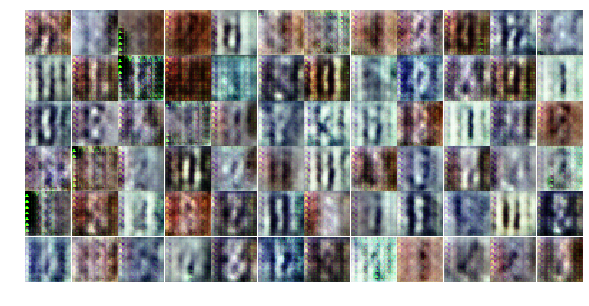

Epoch 3/25... Discriminator Loss: 0.6556... Generator Loss: 1.0404
Epoch 3/25... Discriminator Loss: 1.4374... Generator Loss: 0.6887
Epoch 3/25... Discriminator Loss: 1.3935... Generator Loss: 0.6792
Epoch 3/25... Discriminator Loss: 1.1180... Generator Loss: 0.9204
Epoch 3/25... Discriminator Loss: 1.3375... Generator Loss: 0.7224
Epoch 3/25... Discriminator Loss: 1.5184... Generator Loss: 0.7610
Epoch 3/25... Discriminator Loss: 1.2161... Generator Loss: 0.7592
Epoch 3/25... Discriminator Loss: 1.2597... Generator Loss: 0.8859
Epoch 3/25... Discriminator Loss: 1.3236... Generator Loss: 0.7760
Epoch 3/25... Discriminator Loss: 1.3287... Generator Loss: 0.8881


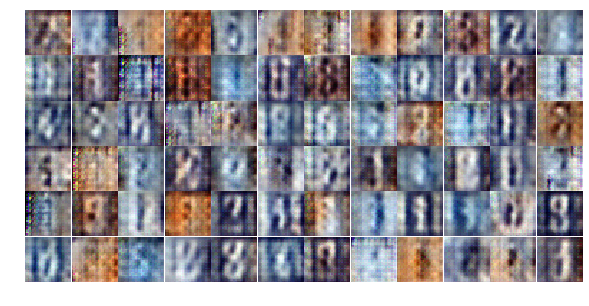

Epoch 3/25... Discriminator Loss: 1.2244... Generator Loss: 0.8012
Epoch 3/25... Discriminator Loss: 1.1174... Generator Loss: 0.8934
Epoch 3/25... Discriminator Loss: 1.2653... Generator Loss: 0.8368
Epoch 3/25... Discriminator Loss: 1.3845... Generator Loss: 0.6686
Epoch 3/25... Discriminator Loss: 1.0643... Generator Loss: 1.0297
Epoch 3/25... Discriminator Loss: 1.1561... Generator Loss: 0.8407
Epoch 3/25... Discriminator Loss: 0.9972... Generator Loss: 0.9525
Epoch 3/25... Discriminator Loss: 1.2364... Generator Loss: 0.7638
Epoch 3/25... Discriminator Loss: 1.0359... Generator Loss: 1.2213
Epoch 3/25... Discriminator Loss: 1.4759... Generator Loss: 0.4612


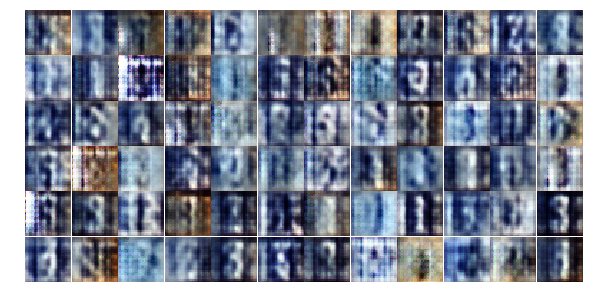

Epoch 3/25... Discriminator Loss: 2.2655... Generator Loss: 2.5170
Epoch 3/25... Discriminator Loss: 1.3393... Generator Loss: 0.7005
Epoch 3/25... Discriminator Loss: 1.2473... Generator Loss: 0.9015
Epoch 3/25... Discriminator Loss: 1.2675... Generator Loss: 0.7315
Epoch 3/25... Discriminator Loss: 1.3594... Generator Loss: 0.9204
Epoch 3/25... Discriminator Loss: 1.3324... Generator Loss: 0.8019
Epoch 3/25... Discriminator Loss: 1.2831... Generator Loss: 0.8030
Epoch 3/25... Discriminator Loss: 1.2788... Generator Loss: 0.8633
Epoch 3/25... Discriminator Loss: 1.3421... Generator Loss: 1.0502
Epoch 3/25... Discriminator Loss: 1.3805... Generator Loss: 0.7529


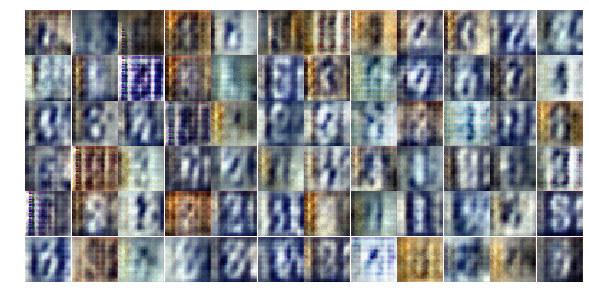

Epoch 3/25... Discriminator Loss: 1.4558... Generator Loss: 0.7716
Epoch 3/25... Discriminator Loss: 1.2763... Generator Loss: 0.7398
Epoch 3/25... Discriminator Loss: 1.5126... Generator Loss: 0.8149
Epoch 3/25... Discriminator Loss: 1.3233... Generator Loss: 1.0524
Epoch 3/25... Discriminator Loss: 1.4090... Generator Loss: 1.1306
Epoch 3/25... Discriminator Loss: 1.2796... Generator Loss: 0.7527
Epoch 3/25... Discriminator Loss: 1.3521... Generator Loss: 0.6690
Epoch 3/25... Discriminator Loss: 1.2456... Generator Loss: 0.8474
Epoch 3/25... Discriminator Loss: 1.2208... Generator Loss: 0.9632
Epoch 3/25... Discriminator Loss: 1.3614... Generator Loss: 0.7857


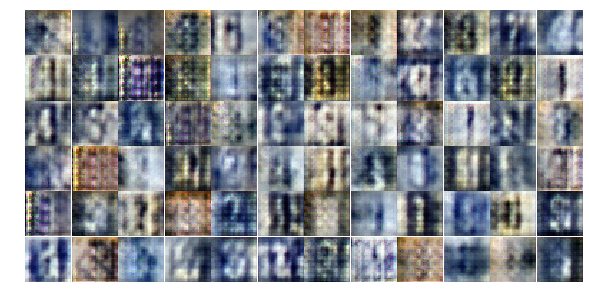

Epoch 3/25... Discriminator Loss: 1.3843... Generator Loss: 0.6452
Epoch 4/25... Discriminator Loss: 1.3844... Generator Loss: 0.7515
Epoch 4/25... Discriminator Loss: 1.2698... Generator Loss: 1.3046
Epoch 4/25... Discriminator Loss: 1.0603... Generator Loss: 1.0118
Epoch 4/25... Discriminator Loss: 1.1287... Generator Loss: 0.9709
Epoch 4/25... Discriminator Loss: 1.1344... Generator Loss: 0.9672
Epoch 4/25... Discriminator Loss: 1.2293... Generator Loss: 0.7897
Epoch 4/25... Discriminator Loss: 1.3180... Generator Loss: 1.1130
Epoch 4/25... Discriminator Loss: 1.3166... Generator Loss: 0.6509
Epoch 4/25... Discriminator Loss: 1.3102... Generator Loss: 0.6180


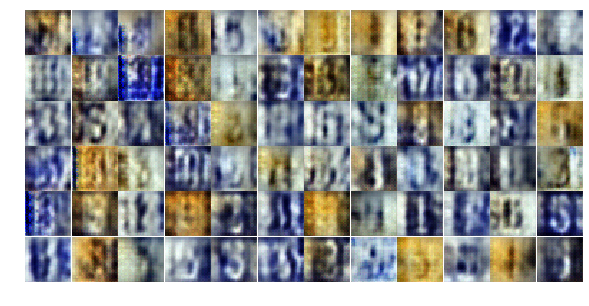

Epoch 4/25... Discriminator Loss: 0.7839... Generator Loss: 1.3529
Epoch 4/25... Discriminator Loss: 1.2162... Generator Loss: 0.6058
Epoch 4/25... Discriminator Loss: 1.1298... Generator Loss: 1.1294
Epoch 4/25... Discriminator Loss: 1.2335... Generator Loss: 0.6246
Epoch 4/25... Discriminator Loss: 0.8944... Generator Loss: 3.4634
Epoch 4/25... Discriminator Loss: 0.6960... Generator Loss: 1.0620
Epoch 4/25... Discriminator Loss: 1.5754... Generator Loss: 0.3487
Epoch 4/25... Discriminator Loss: 1.1016... Generator Loss: 1.1216
Epoch 4/25... Discriminator Loss: 1.4373... Generator Loss: 0.6502
Epoch 4/25... Discriminator Loss: 1.1230... Generator Loss: 0.8542


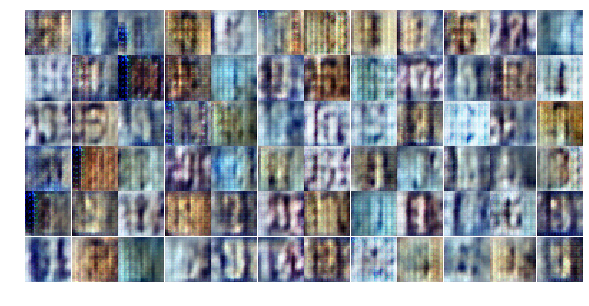

Epoch 4/25... Discriminator Loss: 1.5829... Generator Loss: 0.7609
Epoch 4/25... Discriminator Loss: 1.4661... Generator Loss: 0.7337
Epoch 4/25... Discriminator Loss: 1.3906... Generator Loss: 0.6933
Epoch 4/25... Discriminator Loss: 1.4020... Generator Loss: 0.9675
Epoch 4/25... Discriminator Loss: 1.0402... Generator Loss: 0.9403
Epoch 4/25... Discriminator Loss: 0.5149... Generator Loss: 1.6162
Epoch 4/25... Discriminator Loss: 1.1123... Generator Loss: 0.8099
Epoch 4/25... Discriminator Loss: 1.1151... Generator Loss: 0.7176
Epoch 4/25... Discriminator Loss: 1.0836... Generator Loss: 0.8941
Epoch 4/25... Discriminator Loss: 1.4530... Generator Loss: 0.9148


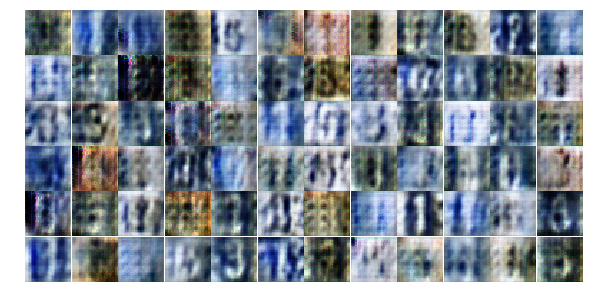

Epoch 4/25... Discriminator Loss: 1.2044... Generator Loss: 0.8014
Epoch 4/25... Discriminator Loss: 1.1900... Generator Loss: 0.8972
Epoch 4/25... Discriminator Loss: 1.4493... Generator Loss: 0.7529
Epoch 4/25... Discriminator Loss: 1.2987... Generator Loss: 0.8349
Epoch 4/25... Discriminator Loss: 1.2904... Generator Loss: 0.8210
Epoch 4/25... Discriminator Loss: 1.3079... Generator Loss: 0.7910
Epoch 4/25... Discriminator Loss: 1.2834... Generator Loss: 0.7390
Epoch 4/25... Discriminator Loss: 1.2501... Generator Loss: 0.8013
Epoch 4/25... Discriminator Loss: 1.3784... Generator Loss: 0.7694
Epoch 4/25... Discriminator Loss: 1.1489... Generator Loss: 0.7715


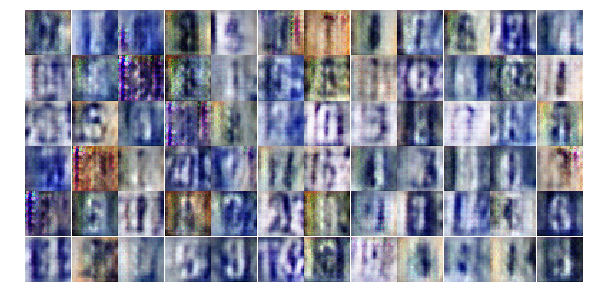

Epoch 4/25... Discriminator Loss: 1.1832... Generator Loss: 0.8964
Epoch 4/25... Discriminator Loss: 1.2382... Generator Loss: 0.8065
Epoch 4/25... Discriminator Loss: 1.2000... Generator Loss: 0.9266
Epoch 4/25... Discriminator Loss: 1.1532... Generator Loss: 0.8902
Epoch 4/25... Discriminator Loss: 1.0924... Generator Loss: 0.9564
Epoch 4/25... Discriminator Loss: 1.1349... Generator Loss: 0.8888
Epoch 4/25... Discriminator Loss: 1.1524... Generator Loss: 1.0226
Epoch 4/25... Discriminator Loss: 1.1091... Generator Loss: 1.0167
Epoch 4/25... Discriminator Loss: 1.1099... Generator Loss: 0.8941
Epoch 4/25... Discriminator Loss: 0.9710... Generator Loss: 0.9332


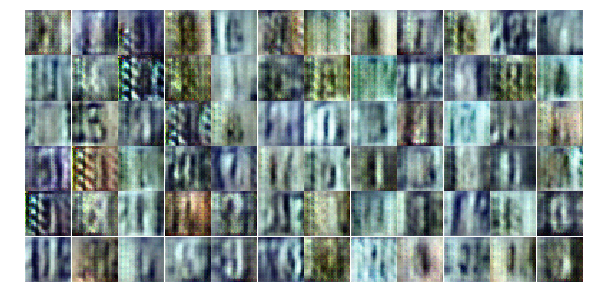

Epoch 4/25... Discriminator Loss: 1.1553... Generator Loss: 1.0534
Epoch 4/25... Discriminator Loss: 1.2977... Generator Loss: 0.8539
Epoch 4/25... Discriminator Loss: 1.5858... Generator Loss: 0.7059
Epoch 4/25... Discriminator Loss: 0.9304... Generator Loss: 1.2918
Epoch 4/25... Discriminator Loss: 1.1655... Generator Loss: 0.9370
Epoch 4/25... Discriminator Loss: 1.2343... Generator Loss: 0.8226
Epoch 4/25... Discriminator Loss: 1.1733... Generator Loss: 1.1468
Epoch 4/25... Discriminator Loss: 1.2690... Generator Loss: 0.9401
Epoch 4/25... Discriminator Loss: 1.2150... Generator Loss: 0.9401
Epoch 5/25... Discriminator Loss: 1.3868... Generator Loss: 0.7948


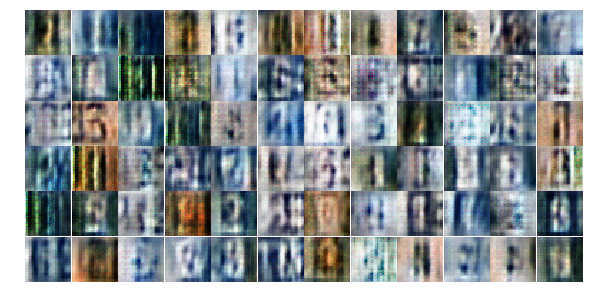

Epoch 5/25... Discriminator Loss: 1.1427... Generator Loss: 0.9408
Epoch 5/25... Discriminator Loss: 1.0373... Generator Loss: 1.0882
Epoch 5/25... Discriminator Loss: 1.1786... Generator Loss: 0.7247
Epoch 5/25... Discriminator Loss: 1.9211... Generator Loss: 3.3110
Epoch 5/25... Discriminator Loss: 1.1106... Generator Loss: 1.0745
Epoch 5/25... Discriminator Loss: 0.8999... Generator Loss: 0.9539
Epoch 5/25... Discriminator Loss: 1.1123... Generator Loss: 0.7393
Epoch 5/25... Discriminator Loss: 1.2027... Generator Loss: 1.2521
Epoch 5/25... Discriminator Loss: 1.1539... Generator Loss: 1.0862
Epoch 5/25... Discriminator Loss: 1.3195... Generator Loss: 0.6921


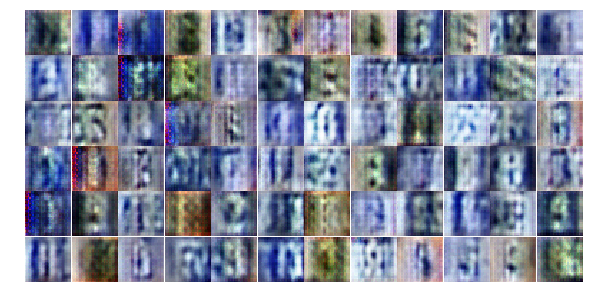

Epoch 5/25... Discriminator Loss: 1.6615... Generator Loss: 2.0565
Epoch 5/25... Discriminator Loss: 1.2850... Generator Loss: 0.6368
Epoch 5/25... Discriminator Loss: 1.3446... Generator Loss: 0.6902
Epoch 5/25... Discriminator Loss: 1.2103... Generator Loss: 0.6953
Epoch 5/25... Discriminator Loss: 1.0903... Generator Loss: 0.8954
Epoch 5/25... Discriminator Loss: 1.1849... Generator Loss: 1.1226
Epoch 5/25... Discriminator Loss: 1.5269... Generator Loss: 0.5218
Epoch 5/25... Discriminator Loss: 1.3335... Generator Loss: 0.8169
Epoch 5/25... Discriminator Loss: 0.9712... Generator Loss: 1.2385
Epoch 5/25... Discriminator Loss: 0.5853... Generator Loss: 1.3033


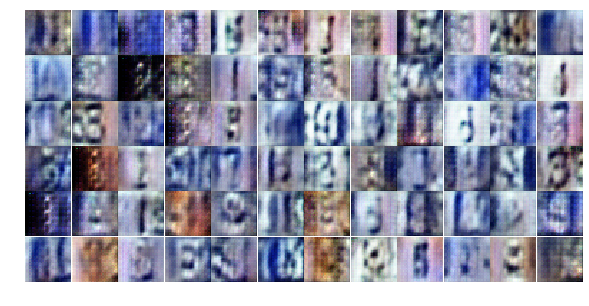

Epoch 5/25... Discriminator Loss: 1.2589... Generator Loss: 0.8206
Epoch 5/25... Discriminator Loss: 1.2349... Generator Loss: 0.8098
Epoch 5/25... Discriminator Loss: 1.0329... Generator Loss: 0.9786
Epoch 5/25... Discriminator Loss: 1.2768... Generator Loss: 0.6828
Epoch 5/25... Discriminator Loss: 1.1627... Generator Loss: 0.5707
Epoch 5/25... Discriminator Loss: 1.3399... Generator Loss: 0.5312
Epoch 5/25... Discriminator Loss: 1.4700... Generator Loss: 1.5118
Epoch 5/25... Discriminator Loss: 1.2080... Generator Loss: 0.7133
Epoch 5/25... Discriminator Loss: 1.3353... Generator Loss: 0.9345
Epoch 5/25... Discriminator Loss: 1.0017... Generator Loss: 1.0012


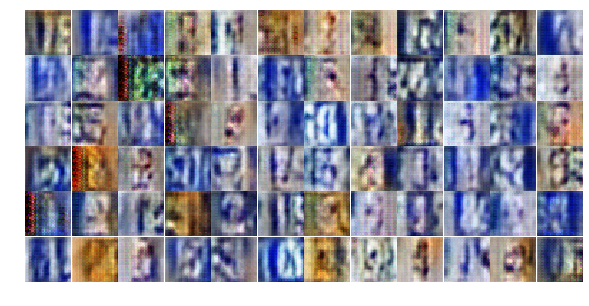

Epoch 5/25... Discriminator Loss: 1.4370... Generator Loss: 0.6306
Epoch 5/25... Discriminator Loss: 1.2370... Generator Loss: 0.7057
Epoch 5/25... Discriminator Loss: 0.4772... Generator Loss: 1.8077
Epoch 5/25... Discriminator Loss: 1.2722... Generator Loss: 0.6229
Epoch 5/25... Discriminator Loss: 1.1484... Generator Loss: 0.9188
Epoch 5/25... Discriminator Loss: 1.1473... Generator Loss: 1.0032
Epoch 5/25... Discriminator Loss: 1.1010... Generator Loss: 0.6987
Epoch 5/25... Discriminator Loss: 1.0115... Generator Loss: 1.2196
Epoch 5/25... Discriminator Loss: 1.2896... Generator Loss: 0.6231
Epoch 5/25... Discriminator Loss: 1.0439... Generator Loss: 0.6450


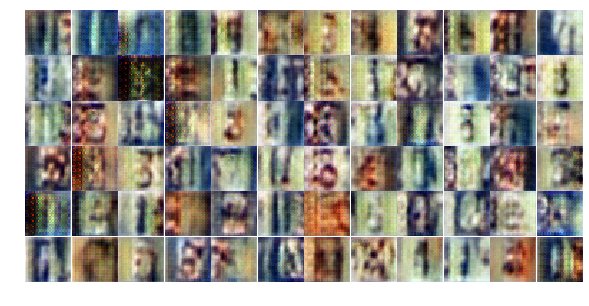

Epoch 5/25... Discriminator Loss: 1.4534... Generator Loss: 0.4657
Epoch 5/25... Discriminator Loss: 0.9207... Generator Loss: 0.9327
Epoch 5/25... Discriminator Loss: 1.4324... Generator Loss: 0.5019
Epoch 5/25... Discriminator Loss: 1.1281... Generator Loss: 0.9869
Epoch 5/25... Discriminator Loss: 0.3989... Generator Loss: 1.8510
Epoch 5/25... Discriminator Loss: 1.6131... Generator Loss: 0.4498
Epoch 5/25... Discriminator Loss: 2.0850... Generator Loss: 0.2758
Epoch 5/25... Discriminator Loss: 1.3658... Generator Loss: 0.8469
Epoch 5/25... Discriminator Loss: 1.3125... Generator Loss: 0.6696
Epoch 5/25... Discriminator Loss: 1.2938... Generator Loss: 0.9723


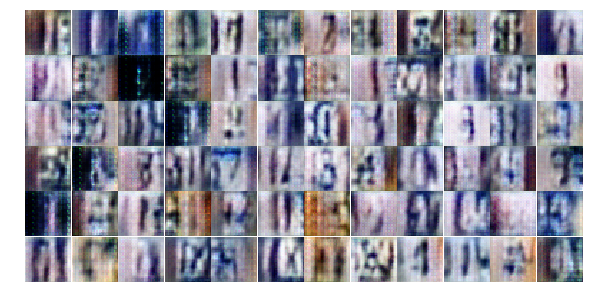

Epoch 5/25... Discriminator Loss: 1.2529... Generator Loss: 0.7356
Epoch 5/25... Discriminator Loss: 1.4338... Generator Loss: 0.4177
Epoch 5/25... Discriminator Loss: 1.2192... Generator Loss: 0.5232
Epoch 5/25... Discriminator Loss: 1.2017... Generator Loss: 0.6773
Epoch 5/25... Discriminator Loss: 1.4235... Generator Loss: 0.8411
Epoch 5/25... Discriminator Loss: 1.1859... Generator Loss: 0.7739
Epoch 6/25... Discriminator Loss: 1.3552... Generator Loss: 0.6648
Epoch 6/25... Discriminator Loss: 1.1170... Generator Loss: 0.7907
Epoch 6/25... Discriminator Loss: 1.1278... Generator Loss: 0.8531
Epoch 6/25... Discriminator Loss: 1.3503... Generator Loss: 0.6928


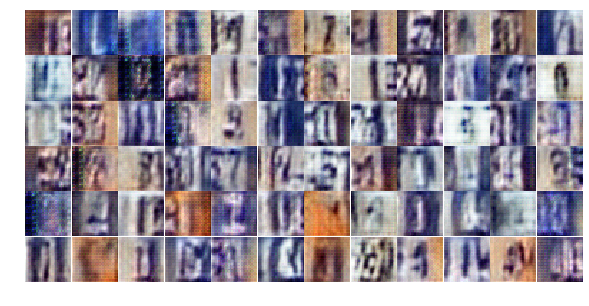

Epoch 6/25... Discriminator Loss: 1.4189... Generator Loss: 0.7213
Epoch 6/25... Discriminator Loss: 1.2707... Generator Loss: 0.6190
Epoch 6/25... Discriminator Loss: 1.2990... Generator Loss: 1.1049
Epoch 6/25... Discriminator Loss: 1.4584... Generator Loss: 1.1343
Epoch 6/25... Discriminator Loss: 1.2106... Generator Loss: 0.6824
Epoch 6/25... Discriminator Loss: 1.3716... Generator Loss: 0.4276
Epoch 6/25... Discriminator Loss: 1.2614... Generator Loss: 0.7077
Epoch 6/25... Discriminator Loss: 1.4185... Generator Loss: 0.4732
Epoch 6/25... Discriminator Loss: 1.4293... Generator Loss: 0.4252
Epoch 6/25... Discriminator Loss: 1.1500... Generator Loss: 1.2426


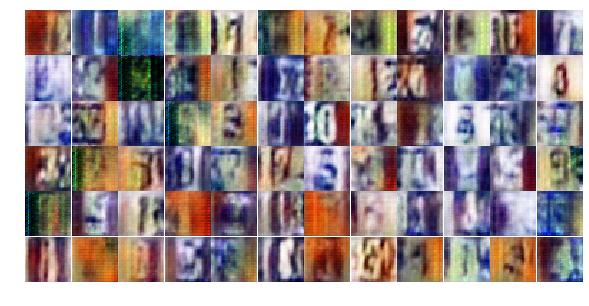

Epoch 6/25... Discriminator Loss: 1.1575... Generator Loss: 0.8702
Epoch 6/25... Discriminator Loss: 1.1557... Generator Loss: 0.9122
Epoch 6/25... Discriminator Loss: 1.1923... Generator Loss: 0.6402
Epoch 6/25... Discriminator Loss: 0.9229... Generator Loss: 0.9400
Epoch 6/25... Discriminator Loss: 1.0964... Generator Loss: 1.1256
Epoch 6/25... Discriminator Loss: 1.2817... Generator Loss: 0.7048
Epoch 6/25... Discriminator Loss: 1.3839... Generator Loss: 0.8695
Epoch 6/25... Discriminator Loss: 1.2381... Generator Loss: 0.8722
Epoch 6/25... Discriminator Loss: 1.2260... Generator Loss: 1.1118
Epoch 6/25... Discriminator Loss: 1.3703... Generator Loss: 0.6793


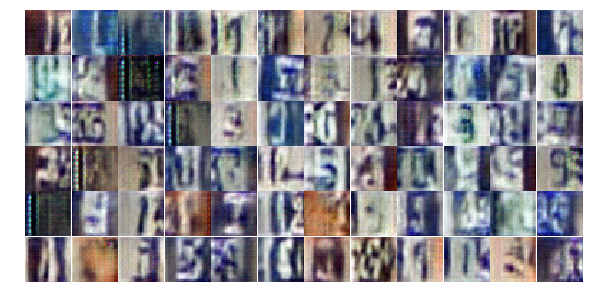

Epoch 6/25... Discriminator Loss: 1.1745... Generator Loss: 0.7060
Epoch 6/25... Discriminator Loss: 1.1173... Generator Loss: 0.7304
Epoch 6/25... Discriminator Loss: 1.3672... Generator Loss: 1.1398
Epoch 6/25... Discriminator Loss: 1.2025... Generator Loss: 0.6175
Epoch 6/25... Discriminator Loss: 1.2535... Generator Loss: 0.7677
Epoch 6/25... Discriminator Loss: 1.3803... Generator Loss: 0.6328
Epoch 6/25... Discriminator Loss: 1.2948... Generator Loss: 0.5923
Epoch 6/25... Discriminator Loss: 1.0845... Generator Loss: 1.0437
Epoch 6/25... Discriminator Loss: 1.2911... Generator Loss: 0.6214
Epoch 6/25... Discriminator Loss: 1.1601... Generator Loss: 0.8807


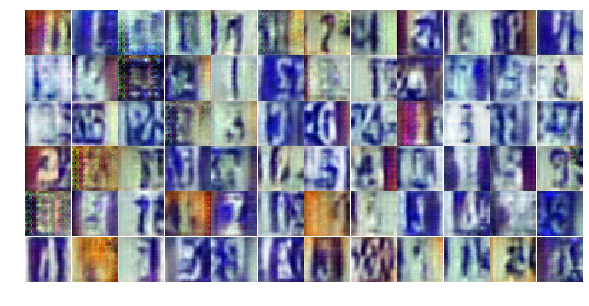

Epoch 6/25... Discriminator Loss: 1.5310... Generator Loss: 0.4218
Epoch 6/25... Discriminator Loss: 1.4518... Generator Loss: 0.4333
Epoch 6/25... Discriminator Loss: 1.3424... Generator Loss: 0.4431
Epoch 6/25... Discriminator Loss: 1.2298... Generator Loss: 0.6941
Epoch 6/25... Discriminator Loss: 1.1147... Generator Loss: 0.8015
Epoch 6/25... Discriminator Loss: 1.2538... Generator Loss: 0.6349
Epoch 6/25... Discriminator Loss: 1.2479... Generator Loss: 0.7397
Epoch 6/25... Discriminator Loss: 1.2274... Generator Loss: 0.8699
Epoch 6/25... Discriminator Loss: 1.2583... Generator Loss: 0.5321
Epoch 6/25... Discriminator Loss: 0.6237... Generator Loss: 2.7458


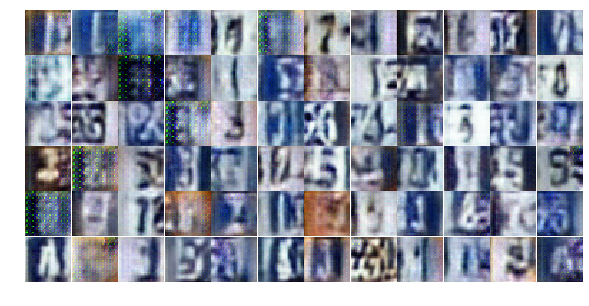

Epoch 6/25... Discriminator Loss: 1.1408... Generator Loss: 0.8468
Epoch 6/25... Discriminator Loss: 1.0329... Generator Loss: 0.7606
Epoch 6/25... Discriminator Loss: 1.3649... Generator Loss: 0.7359
Epoch 6/25... Discriminator Loss: 1.4546... Generator Loss: 0.6063
Epoch 6/25... Discriminator Loss: 1.0166... Generator Loss: 0.5275
Epoch 6/25... Discriminator Loss: 1.2958... Generator Loss: 1.3300
Epoch 6/25... Discriminator Loss: 1.0718... Generator Loss: 1.0578
Epoch 6/25... Discriminator Loss: 1.4529... Generator Loss: 0.3442
Epoch 6/25... Discriminator Loss: 1.2221... Generator Loss: 0.9294
Epoch 6/25... Discriminator Loss: 0.8500... Generator Loss: 0.6929


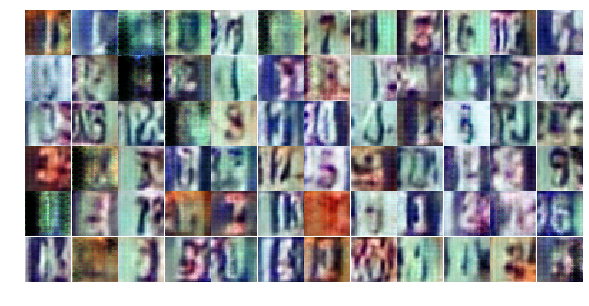

Epoch 6/25... Discriminator Loss: 0.9755... Generator Loss: 1.0980
Epoch 6/25... Discriminator Loss: 1.1983... Generator Loss: 1.3033
Epoch 6/25... Discriminator Loss: 1.3043... Generator Loss: 0.5497
Epoch 7/25... Discriminator Loss: 1.4266... Generator Loss: 0.7029
Epoch 7/25... Discriminator Loss: 1.1903... Generator Loss: 1.0596
Epoch 7/25... Discriminator Loss: 1.2443... Generator Loss: 0.8578
Epoch 7/25... Discriminator Loss: 1.2325... Generator Loss: 1.0056
Epoch 7/25... Discriminator Loss: 1.3363... Generator Loss: 0.8055
Epoch 7/25... Discriminator Loss: 1.2880... Generator Loss: 0.7832
Epoch 7/25... Discriminator Loss: 1.3377... Generator Loss: 0.7898


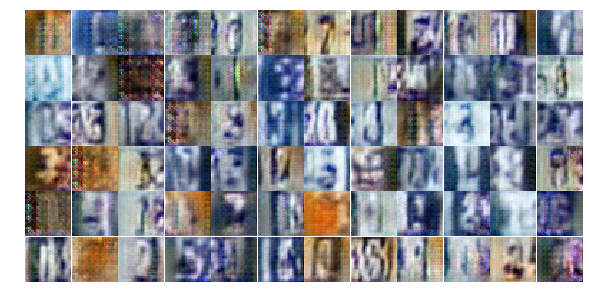

Epoch 7/25... Discriminator Loss: 1.2659... Generator Loss: 0.7497
Epoch 7/25... Discriminator Loss: 1.2844... Generator Loss: 0.8015
Epoch 7/25... Discriminator Loss: 1.1839... Generator Loss: 0.8900
Epoch 7/25... Discriminator Loss: 0.9113... Generator Loss: 0.7419
Epoch 7/25... Discriminator Loss: 2.0070... Generator Loss: 0.2757
Epoch 7/25... Discriminator Loss: 1.3580... Generator Loss: 0.6692
Epoch 7/25... Discriminator Loss: 1.2797... Generator Loss: 0.7216
Epoch 7/25... Discriminator Loss: 1.2585... Generator Loss: 0.8400
Epoch 7/25... Discriminator Loss: 1.4010... Generator Loss: 0.8793
Epoch 7/25... Discriminator Loss: 1.2190... Generator Loss: 0.8690


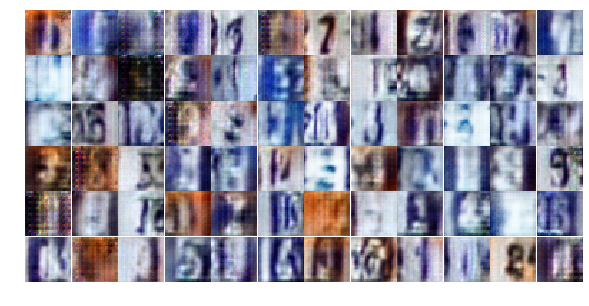

Epoch 7/25... Discriminator Loss: 1.2411... Generator Loss: 0.8089
Epoch 7/25... Discriminator Loss: 1.1875... Generator Loss: 0.6726
Epoch 7/25... Discriminator Loss: 0.5130... Generator Loss: 1.3072
Epoch 7/25... Discriminator Loss: 1.0362... Generator Loss: 1.8024
Epoch 7/25... Discriminator Loss: 1.3285... Generator Loss: 1.3424
Epoch 7/25... Discriminator Loss: 1.1726... Generator Loss: 0.7854
Epoch 7/25... Discriminator Loss: 1.2172... Generator Loss: 0.8193
Epoch 7/25... Discriminator Loss: 1.3346... Generator Loss: 0.6208
Epoch 7/25... Discriminator Loss: 1.1027... Generator Loss: 0.8857
Epoch 7/25... Discriminator Loss: 1.3330... Generator Loss: 0.9207


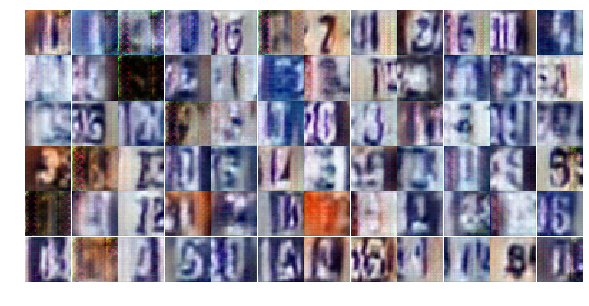

Epoch 7/25... Discriminator Loss: 1.2444... Generator Loss: 0.6115
Epoch 7/25... Discriminator Loss: 0.9400... Generator Loss: 0.8362
Epoch 7/25... Discriminator Loss: 1.3610... Generator Loss: 1.2578
Epoch 7/25... Discriminator Loss: 1.4641... Generator Loss: 0.5186
Epoch 7/25... Discriminator Loss: 1.4297... Generator Loss: 0.6672
Epoch 7/25... Discriminator Loss: 1.1237... Generator Loss: 0.8468
Epoch 7/25... Discriminator Loss: 0.9078... Generator Loss: 0.8422
Epoch 7/25... Discriminator Loss: 0.7154... Generator Loss: 1.2734
Epoch 7/25... Discriminator Loss: 2.0426... Generator Loss: 1.8324
Epoch 7/25... Discriminator Loss: 1.1033... Generator Loss: 0.5277


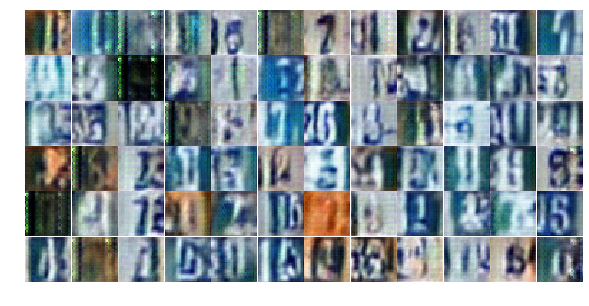

Epoch 7/25... Discriminator Loss: 1.1719... Generator Loss: 0.8464
Epoch 7/25... Discriminator Loss: 1.0563... Generator Loss: 0.8129
Epoch 7/25... Discriminator Loss: 1.2766... Generator Loss: 0.4818
Epoch 7/25... Discriminator Loss: 1.1633... Generator Loss: 1.1417
Epoch 7/25... Discriminator Loss: 1.0076... Generator Loss: 1.5518
Epoch 7/25... Discriminator Loss: 1.1631... Generator Loss: 0.8600
Epoch 7/25... Discriminator Loss: 1.4535... Generator Loss: 1.1489
Epoch 7/25... Discriminator Loss: 1.4530... Generator Loss: 0.5207
Epoch 7/25... Discriminator Loss: 1.1560... Generator Loss: 1.0467
Epoch 7/25... Discriminator Loss: 1.2302... Generator Loss: 0.8023


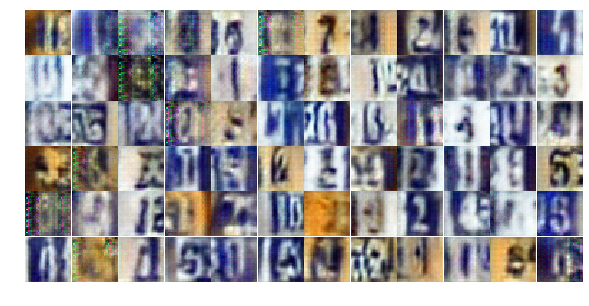

Epoch 7/25... Discriminator Loss: 1.1512... Generator Loss: 0.8992
Epoch 7/25... Discriminator Loss: 1.0788... Generator Loss: 1.1331
Epoch 7/25... Discriminator Loss: 1.1333... Generator Loss: 0.9152
Epoch 7/25... Discriminator Loss: 0.6661... Generator Loss: 1.3685
Epoch 7/25... Discriminator Loss: 1.3886... Generator Loss: 1.0020
Epoch 7/25... Discriminator Loss: 1.2763... Generator Loss: 1.0296
Epoch 7/25... Discriminator Loss: 1.1745... Generator Loss: 0.8345
Epoch 7/25... Discriminator Loss: 0.6378... Generator Loss: 1.4191
Epoch 7/25... Discriminator Loss: 1.4887... Generator Loss: 1.1175
Epoch 7/25... Discriminator Loss: 1.3869... Generator Loss: 0.7051


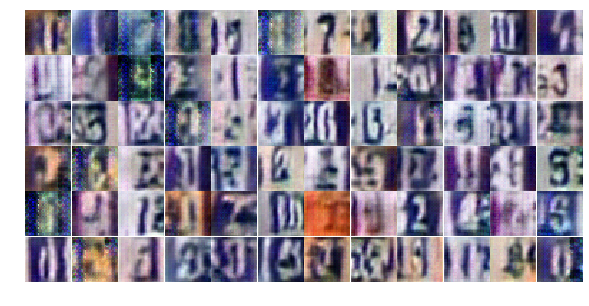

Epoch 7/25... Discriminator Loss: 1.3188... Generator Loss: 1.1682
Epoch 8/25... Discriminator Loss: 1.2825... Generator Loss: 0.5653
Epoch 8/25... Discriminator Loss: 0.9958... Generator Loss: 0.7352
Epoch 8/25... Discriminator Loss: 1.2273... Generator Loss: 1.8893
Epoch 8/25... Discriminator Loss: 1.2206... Generator Loss: 0.8995
Epoch 8/25... Discriminator Loss: 1.5909... Generator Loss: 0.5764
Epoch 8/25... Discriminator Loss: 1.4278... Generator Loss: 0.4863
Epoch 8/25... Discriminator Loss: 1.1826... Generator Loss: 1.0485
Epoch 8/25... Discriminator Loss: 1.3370... Generator Loss: 0.5910
Epoch 8/25... Discriminator Loss: 1.3023... Generator Loss: 0.7650


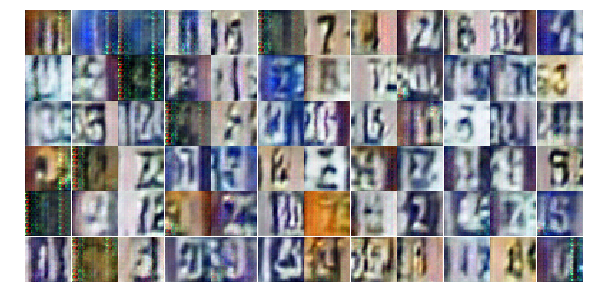

Epoch 8/25... Discriminator Loss: 1.2452... Generator Loss: 0.7971
Epoch 8/25... Discriminator Loss: 1.0683... Generator Loss: 0.8941
Epoch 8/25... Discriminator Loss: 1.2879... Generator Loss: 0.6916
Epoch 8/25... Discriminator Loss: 1.1949... Generator Loss: 1.0105
Epoch 8/25... Discriminator Loss: 1.3836... Generator Loss: 0.6363
Epoch 8/25... Discriminator Loss: 1.0838... Generator Loss: 0.8133
Epoch 8/25... Discriminator Loss: 1.3146... Generator Loss: 0.7195
Epoch 8/25... Discriminator Loss: 1.2304... Generator Loss: 0.8975
Epoch 8/25... Discriminator Loss: 1.2485... Generator Loss: 0.6892
Epoch 8/25... Discriminator Loss: 1.5223... Generator Loss: 0.4704


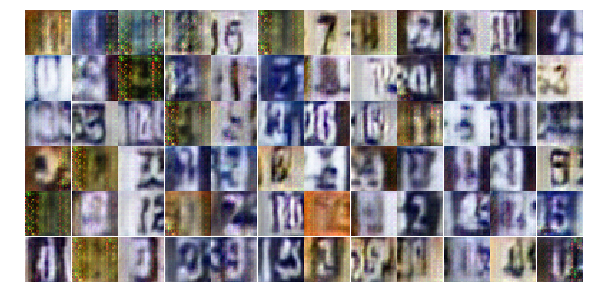

Epoch 8/25... Discriminator Loss: 1.1925... Generator Loss: 0.8105
Epoch 8/25... Discriminator Loss: 1.1397... Generator Loss: 0.6639
Epoch 8/25... Discriminator Loss: 1.3524... Generator Loss: 0.6279
Epoch 8/25... Discriminator Loss: 0.5965... Generator Loss: 1.1830
Epoch 8/25... Discriminator Loss: 0.8216... Generator Loss: 2.4900
Epoch 8/25... Discriminator Loss: 0.6853... Generator Loss: 1.0451
Epoch 8/25... Discriminator Loss: 0.9430... Generator Loss: 1.0468
Epoch 8/25... Discriminator Loss: 1.1710... Generator Loss: 0.5947
Epoch 8/25... Discriminator Loss: 0.9511... Generator Loss: 1.6266
Epoch 8/25... Discriminator Loss: 0.8249... Generator Loss: 0.7087


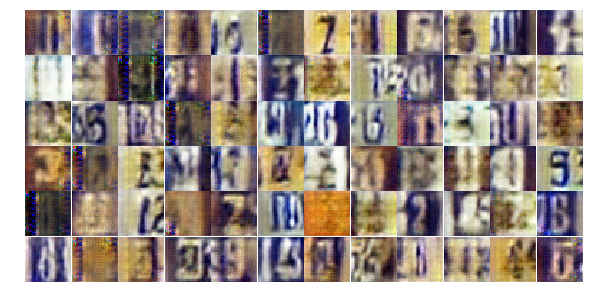

Epoch 8/25... Discriminator Loss: 1.3794... Generator Loss: 0.3757
Epoch 8/25... Discriminator Loss: 0.6655... Generator Loss: 2.2182
Epoch 8/25... Discriminator Loss: 0.5013... Generator Loss: 1.8864
Epoch 8/25... Discriminator Loss: 0.7801... Generator Loss: 0.7675
Epoch 8/25... Discriminator Loss: 0.0298... Generator Loss: 4.3913
Epoch 8/25... Discriminator Loss: 1.0851... Generator Loss: 1.0758
Epoch 8/25... Discriminator Loss: 1.0706... Generator Loss: 0.7415
Epoch 8/25... Discriminator Loss: 1.1863... Generator Loss: 0.8760
Epoch 8/25... Discriminator Loss: 0.3964... Generator Loss: 2.1075
Epoch 8/25... Discriminator Loss: 1.0750... Generator Loss: 0.7302


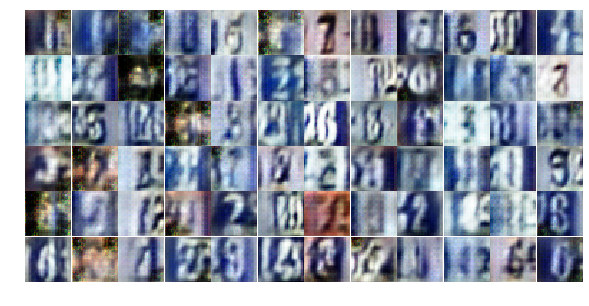

Epoch 8/25... Discriminator Loss: 0.6011... Generator Loss: 1.2744
Epoch 8/25... Discriminator Loss: 0.1905... Generator Loss: 3.9647
Epoch 8/25... Discriminator Loss: 0.3115... Generator Loss: 1.7605
Epoch 8/25... Discriminator Loss: 1.8629... Generator Loss: 1.3393
Epoch 8/25... Discriminator Loss: 1.4945... Generator Loss: 1.4944
Epoch 8/25... Discriminator Loss: 1.0343... Generator Loss: 0.8404
Epoch 8/25... Discriminator Loss: 0.9024... Generator Loss: 2.0813
Epoch 8/25... Discriminator Loss: 0.2521... Generator Loss: 2.4638
Epoch 8/25... Discriminator Loss: 1.3507... Generator Loss: 0.4585
Epoch 8/25... Discriminator Loss: 1.2391... Generator Loss: 0.7550


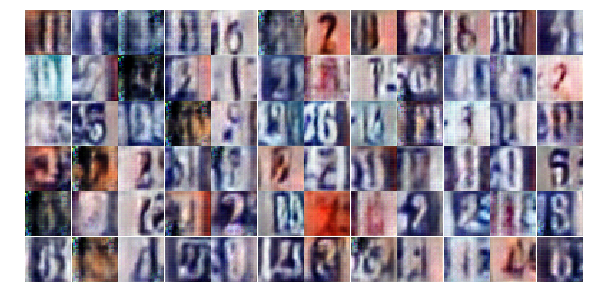

Epoch 8/25... Discriminator Loss: 0.8634... Generator Loss: 1.4769
Epoch 8/25... Discriminator Loss: 0.6521... Generator Loss: 0.9891
Epoch 8/25... Discriminator Loss: 2.2095... Generator Loss: 0.1453
Epoch 8/25... Discriminator Loss: 1.2291... Generator Loss: 0.9621
Epoch 8/25... Discriminator Loss: 1.1464... Generator Loss: 1.1898
Epoch 8/25... Discriminator Loss: 0.2551... Generator Loss: 2.5859
Epoch 8/25... Discriminator Loss: 1.1741... Generator Loss: 1.1832
Epoch 8/25... Discriminator Loss: 1.2282... Generator Loss: 0.7557
Epoch 9/25... Discriminator Loss: 1.2274... Generator Loss: 0.9807
Epoch 9/25... Discriminator Loss: 1.1952... Generator Loss: 0.6333


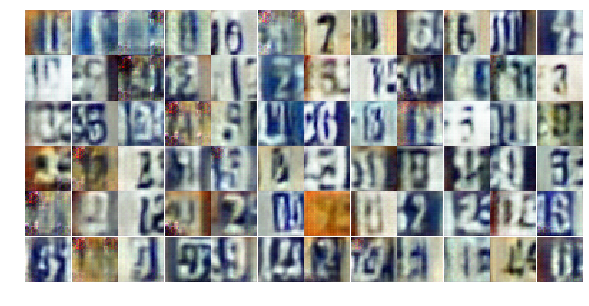

Epoch 9/25... Discriminator Loss: 1.3100... Generator Loss: 0.5058
Epoch 9/25... Discriminator Loss: 0.9514... Generator Loss: 0.9387
Epoch 9/25... Discriminator Loss: 1.1400... Generator Loss: 0.8248
Epoch 9/25... Discriminator Loss: 1.1950... Generator Loss: 0.6467
Epoch 9/25... Discriminator Loss: 1.0279... Generator Loss: 1.3317
Epoch 9/25... Discriminator Loss: 1.4732... Generator Loss: 0.3227
Epoch 9/25... Discriminator Loss: 1.3398... Generator Loss: 0.7526
Epoch 9/25... Discriminator Loss: 1.1459... Generator Loss: 0.8612
Epoch 9/25... Discriminator Loss: 1.3228... Generator Loss: 0.6070
Epoch 9/25... Discriminator Loss: 1.3905... Generator Loss: 0.6520


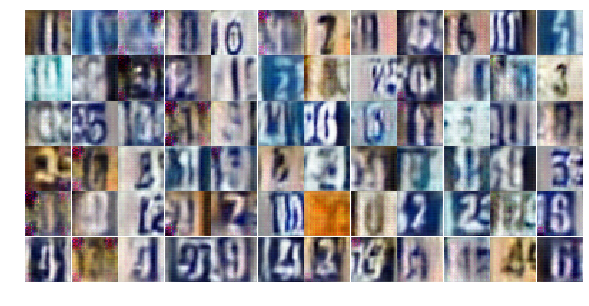

Epoch 9/25... Discriminator Loss: 1.0718... Generator Loss: 0.6391
Epoch 9/25... Discriminator Loss: 1.2216... Generator Loss: 0.6039
Epoch 9/25... Discriminator Loss: 1.2242... Generator Loss: 0.5412
Epoch 9/25... Discriminator Loss: 0.3729... Generator Loss: 2.0991
Epoch 9/25... Discriminator Loss: 1.2674... Generator Loss: 0.7123
Epoch 9/25... Discriminator Loss: 0.8122... Generator Loss: 1.0097
Epoch 9/25... Discriminator Loss: 1.1779... Generator Loss: 0.5802
Epoch 9/25... Discriminator Loss: 0.9944... Generator Loss: 0.5599
Epoch 9/25... Discriminator Loss: 1.2856... Generator Loss: 0.7097
Epoch 9/25... Discriminator Loss: 0.7835... Generator Loss: 1.5243


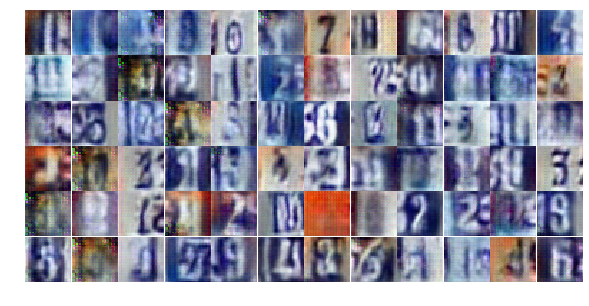

Epoch 9/25... Discriminator Loss: 1.2200... Generator Loss: 1.4037
Epoch 9/25... Discriminator Loss: 1.1391... Generator Loss: 0.5899
Epoch 9/25... Discriminator Loss: 0.3978... Generator Loss: 1.9101
Epoch 9/25... Discriminator Loss: 1.2835... Generator Loss: 0.5742
Epoch 9/25... Discriminator Loss: 1.2979... Generator Loss: 0.6830
Epoch 9/25... Discriminator Loss: 1.1925... Generator Loss: 0.8173
Epoch 9/25... Discriminator Loss: 1.2620... Generator Loss: 0.5923
Epoch 9/25... Discriminator Loss: 1.1240... Generator Loss: 0.8436
Epoch 9/25... Discriminator Loss: 0.9843... Generator Loss: 1.1166
Epoch 9/25... Discriminator Loss: 0.9471... Generator Loss: 0.7754


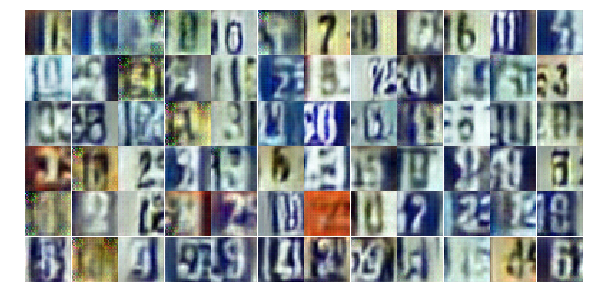

Epoch 9/25... Discriminator Loss: 1.2873... Generator Loss: 3.5267
Epoch 9/25... Discriminator Loss: 1.1068... Generator Loss: 0.8138
Epoch 9/25... Discriminator Loss: 1.2070... Generator Loss: 1.0923
Epoch 9/25... Discriminator Loss: 1.1319... Generator Loss: 0.8008
Epoch 9/25... Discriminator Loss: 1.2914... Generator Loss: 0.8273
Epoch 9/25... Discriminator Loss: 1.3343... Generator Loss: 0.6980
Epoch 9/25... Discriminator Loss: 1.3923... Generator Loss: 1.0928
Epoch 9/25... Discriminator Loss: 1.1643... Generator Loss: 0.8294
Epoch 9/25... Discriminator Loss: 1.4114... Generator Loss: 0.4888
Epoch 9/25... Discriminator Loss: 1.5441... Generator Loss: 0.3943


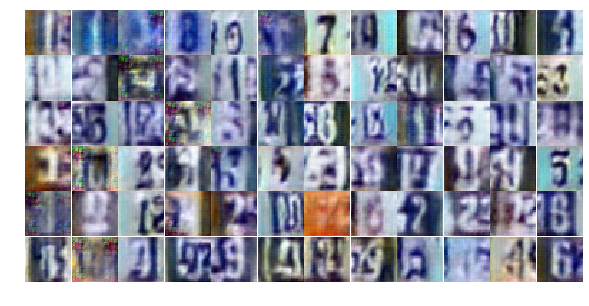

Epoch 9/25... Discriminator Loss: 1.0995... Generator Loss: 0.6774
Epoch 9/25... Discriminator Loss: 0.6900... Generator Loss: 0.9356
Epoch 9/25... Discriminator Loss: 0.6311... Generator Loss: 2.4333
Epoch 9/25... Discriminator Loss: 0.8906... Generator Loss: 1.0691
Epoch 9/25... Discriminator Loss: 1.3925... Generator Loss: 0.5112
Epoch 9/25... Discriminator Loss: 1.1540... Generator Loss: 0.7083
Epoch 9/25... Discriminator Loss: 1.2041... Generator Loss: 0.8815
Epoch 9/25... Discriminator Loss: 1.0532... Generator Loss: 0.7156
Epoch 9/25... Discriminator Loss: 1.1169... Generator Loss: 0.8610
Epoch 9/25... Discriminator Loss: 0.8029... Generator Loss: 1.5355


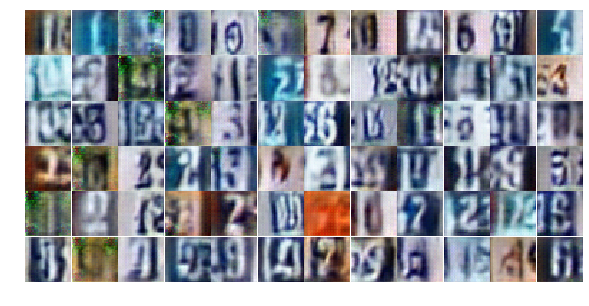

Epoch 9/25... Discriminator Loss: 0.2701... Generator Loss: 2.0168
Epoch 9/25... Discriminator Loss: 1.2083... Generator Loss: 1.0041
Epoch 9/25... Discriminator Loss: 1.6631... Generator Loss: 0.3492
Epoch 9/25... Discriminator Loss: 1.2677... Generator Loss: 0.5850
Epoch 9/25... Discriminator Loss: 0.9726... Generator Loss: 0.7483
Epoch 10/25... Discriminator Loss: 1.6621... Generator Loss: 1.8488
Epoch 10/25... Discriminator Loss: 1.3192... Generator Loss: 0.7145
Epoch 10/25... Discriminator Loss: 1.3118... Generator Loss: 0.6934
Epoch 10/25... Discriminator Loss: 1.3797... Generator Loss: 0.5430
Epoch 10/25... Discriminator Loss: 1.3491... Generator Loss: 0.5346


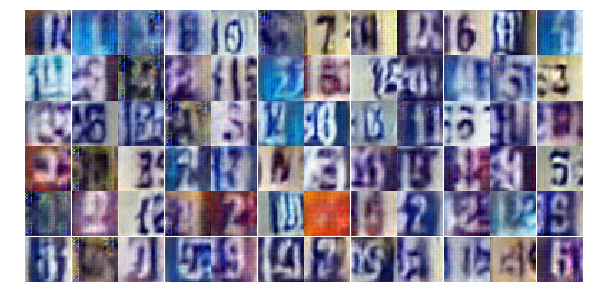

Epoch 10/25... Discriminator Loss: 1.2665... Generator Loss: 0.6413
Epoch 10/25... Discriminator Loss: 1.2373... Generator Loss: 0.7414
Epoch 10/25... Discriminator Loss: 1.2721... Generator Loss: 0.7919
Epoch 10/25... Discriminator Loss: 1.1282... Generator Loss: 0.7901
Epoch 10/25... Discriminator Loss: 1.0699... Generator Loss: 0.8888
Epoch 10/25... Discriminator Loss: 1.1908... Generator Loss: 0.7922
Epoch 10/25... Discriminator Loss: 1.0656... Generator Loss: 0.9415
Epoch 10/25... Discriminator Loss: 1.3456... Generator Loss: 0.6171
Epoch 10/25... Discriminator Loss: 1.2904... Generator Loss: 0.5961
Epoch 10/25... Discriminator Loss: 1.2060... Generator Loss: 0.7894


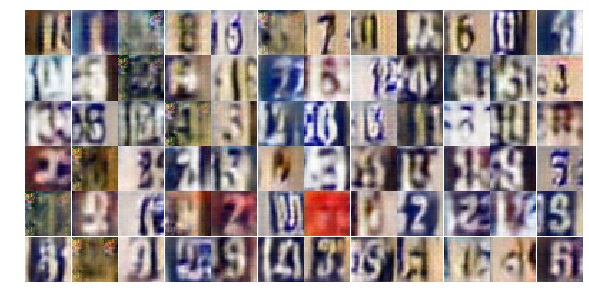

Epoch 10/25... Discriminator Loss: 1.1649... Generator Loss: 0.8453
Epoch 10/25... Discriminator Loss: 1.2914... Generator Loss: 0.7450
Epoch 10/25... Discriminator Loss: 1.0968... Generator Loss: 0.7978
Epoch 10/25... Discriminator Loss: 1.3194... Generator Loss: 0.5541
Epoch 10/25... Discriminator Loss: 1.2148... Generator Loss: 0.8304
Epoch 10/25... Discriminator Loss: 1.1431... Generator Loss: 0.7592
Epoch 10/25... Discriminator Loss: 1.2787... Generator Loss: 0.5733
Epoch 10/25... Discriminator Loss: 1.0980... Generator Loss: 1.0723
Epoch 10/25... Discriminator Loss: 1.2945... Generator Loss: 0.5972
Epoch 10/25... Discriminator Loss: 1.1293... Generator Loss: 0.8707


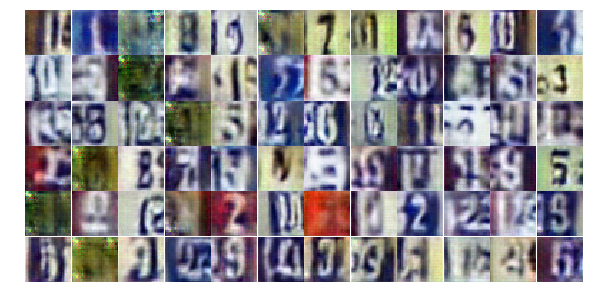

Epoch 10/25... Discriminator Loss: 1.0970... Generator Loss: 0.8359
Epoch 10/25... Discriminator Loss: 1.5508... Generator Loss: 0.8707
Epoch 10/25... Discriminator Loss: 1.0575... Generator Loss: 0.8232
Epoch 10/25... Discriminator Loss: 1.1364... Generator Loss: 0.7220
Epoch 10/25... Discriminator Loss: 1.2136... Generator Loss: 0.5904
Epoch 10/25... Discriminator Loss: 1.3183... Generator Loss: 0.6743
Epoch 10/25... Discriminator Loss: 1.1503... Generator Loss: 0.8017
Epoch 10/25... Discriminator Loss: 1.2973... Generator Loss: 0.7383
Epoch 10/25... Discriminator Loss: 1.1803... Generator Loss: 0.6801
Epoch 10/25... Discriminator Loss: 1.2565... Generator Loss: 0.5245


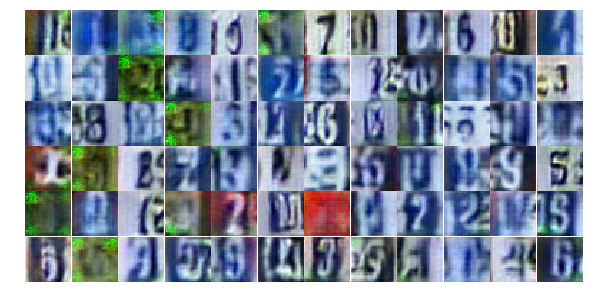

Epoch 10/25... Discriminator Loss: 1.3406... Generator Loss: 0.5247
Epoch 10/25... Discriminator Loss: 1.6739... Generator Loss: 0.6416
Epoch 10/25... Discriminator Loss: 1.2355... Generator Loss: 0.6499
Epoch 10/25... Discriminator Loss: 0.9415... Generator Loss: 0.7825
Epoch 10/25... Discriminator Loss: 0.6380... Generator Loss: 1.3190
Epoch 10/25... Discriminator Loss: 1.0360... Generator Loss: 0.6819
Epoch 10/25... Discriminator Loss: 0.2321... Generator Loss: 2.1633
Epoch 10/25... Discriminator Loss: 1.2551... Generator Loss: 0.4871
Epoch 10/25... Discriminator Loss: 1.0510... Generator Loss: 0.6382
Epoch 10/25... Discriminator Loss: 0.4444... Generator Loss: 1.4545


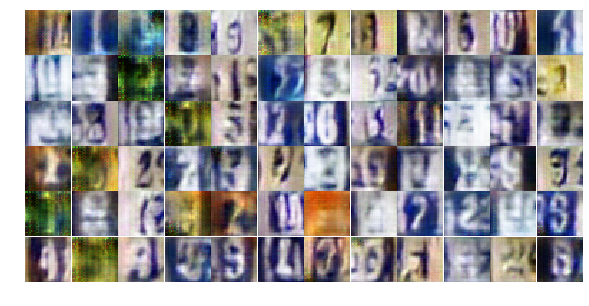

Epoch 10/25... Discriminator Loss: 1.8725... Generator Loss: 4.1513
Epoch 10/25... Discriminator Loss: 1.2561... Generator Loss: 0.6894
Epoch 10/25... Discriminator Loss: 1.2914... Generator Loss: 0.6870
Epoch 10/25... Discriminator Loss: 1.1563... Generator Loss: 0.7555
Epoch 10/25... Discriminator Loss: 1.2262... Generator Loss: 0.9571
Epoch 10/25... Discriminator Loss: 1.0016... Generator Loss: 1.0821
Epoch 10/25... Discriminator Loss: 1.2638... Generator Loss: 0.6923
Epoch 10/25... Discriminator Loss: 1.0636... Generator Loss: 0.8575
Epoch 10/25... Discriminator Loss: 1.1213... Generator Loss: 0.7516
Epoch 10/25... Discriminator Loss: 0.7361... Generator Loss: 1.1355


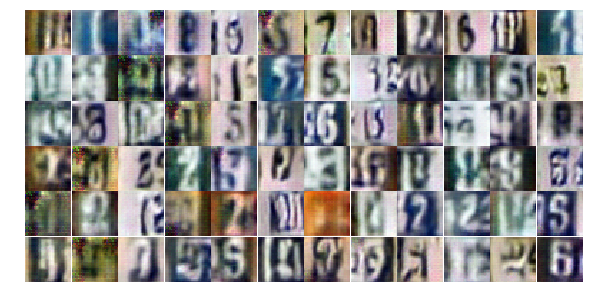

Epoch 10/25... Discriminator Loss: 1.6215... Generator Loss: 0.4655
Epoch 10/25... Discriminator Loss: 1.4826... Generator Loss: 0.4416
Epoch 10/25... Discriminator Loss: 0.9294... Generator Loss: 0.9409
Epoch 11/25... Discriminator Loss: 1.2513... Generator Loss: 0.7390
Epoch 11/25... Discriminator Loss: 1.1991... Generator Loss: 0.8439
Epoch 11/25... Discriminator Loss: 1.3334... Generator Loss: 0.4764
Epoch 11/25... Discriminator Loss: 1.2845... Generator Loss: 0.6117
Epoch 11/25... Discriminator Loss: 1.3430... Generator Loss: 0.6899
Epoch 11/25... Discriminator Loss: 1.6995... Generator Loss: 0.3255
Epoch 11/25... Discriminator Loss: 1.1240... Generator Loss: 0.7547


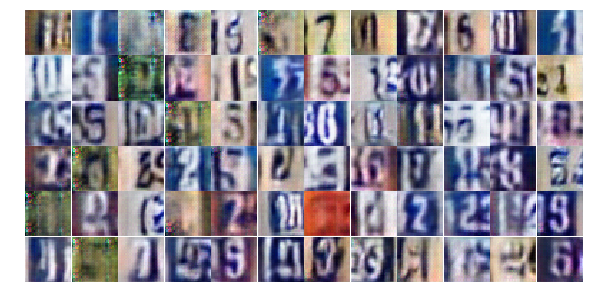

Epoch 11/25... Discriminator Loss: 1.2557... Generator Loss: 0.7697
Epoch 11/25... Discriminator Loss: 1.2769... Generator Loss: 0.7503
Epoch 11/25... Discriminator Loss: 1.2161... Generator Loss: 0.6351
Epoch 11/25... Discriminator Loss: 1.1348... Generator Loss: 0.6807
Epoch 11/25... Discriminator Loss: 1.2288... Generator Loss: 0.7628
Epoch 11/25... Discriminator Loss: 1.3320... Generator Loss: 0.5555
Epoch 11/25... Discriminator Loss: 1.1406... Generator Loss: 0.6231
Epoch 11/25... Discriminator Loss: 0.8446... Generator Loss: 1.0680
Epoch 11/25... Discriminator Loss: 1.1853... Generator Loss: 0.6514
Epoch 11/25... Discriminator Loss: 1.5788... Generator Loss: 0.3372


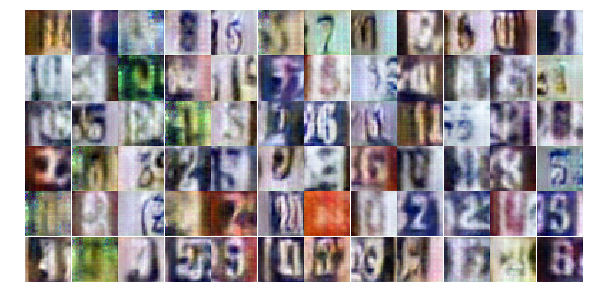

Epoch 11/25... Discriminator Loss: 1.3083... Generator Loss: 0.4831
Epoch 11/25... Discriminator Loss: 1.3497... Generator Loss: 0.8596
Epoch 11/25... Discriminator Loss: 1.2763... Generator Loss: 0.6148
Epoch 11/25... Discriminator Loss: 1.1692... Generator Loss: 0.7295
Epoch 11/25... Discriminator Loss: 0.7980... Generator Loss: 1.0684
Epoch 11/25... Discriminator Loss: 0.7773... Generator Loss: 1.3870
Epoch 11/25... Discriminator Loss: 1.2860... Generator Loss: 0.6536
Epoch 11/25... Discriminator Loss: 1.2530... Generator Loss: 0.6889
Epoch 11/25... Discriminator Loss: 1.1642... Generator Loss: 0.7256
Epoch 11/25... Discriminator Loss: 1.2552... Generator Loss: 0.5757


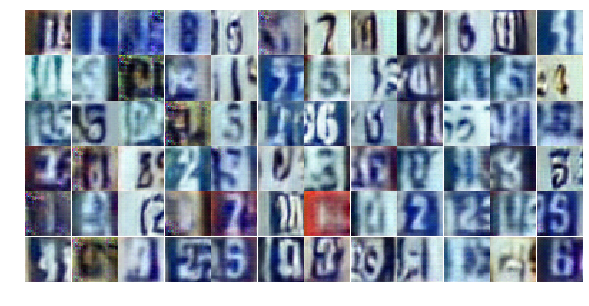

Epoch 11/25... Discriminator Loss: 1.3307... Generator Loss: 0.6212
Epoch 11/25... Discriminator Loss: 1.0759... Generator Loss: 0.7401
Epoch 11/25... Discriminator Loss: 1.1054... Generator Loss: 0.7262
Epoch 11/25... Discriminator Loss: 1.1143... Generator Loss: 0.8531
Epoch 11/25... Discriminator Loss: 1.2598... Generator Loss: 0.6182
Epoch 11/25... Discriminator Loss: 1.2627... Generator Loss: 0.6869
Epoch 11/25... Discriminator Loss: 1.3005... Generator Loss: 0.5453
Epoch 11/25... Discriminator Loss: 1.1662... Generator Loss: 0.7927
Epoch 11/25... Discriminator Loss: 0.4443... Generator Loss: 1.2206
Epoch 11/25... Discriminator Loss: 1.3775... Generator Loss: 0.3780


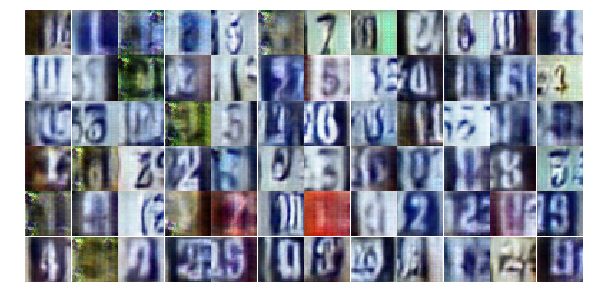

Epoch 11/25... Discriminator Loss: 1.7814... Generator Loss: 0.2881
Epoch 11/25... Discriminator Loss: 0.5461... Generator Loss: 3.1980
Epoch 11/25... Discriminator Loss: 1.0250... Generator Loss: 0.6233
Epoch 11/25... Discriminator Loss: 0.6320... Generator Loss: 1.4113
Epoch 11/25... Discriminator Loss: 1.3274... Generator Loss: 0.4764
Epoch 11/25... Discriminator Loss: 1.2251... Generator Loss: 0.9195
Epoch 11/25... Discriminator Loss: 0.9536... Generator Loss: 0.8722
Epoch 11/25... Discriminator Loss: 0.7874... Generator Loss: 0.9052
Epoch 11/25... Discriminator Loss: 0.4643... Generator Loss: 2.8536
Epoch 11/25... Discriminator Loss: 1.3174... Generator Loss: 1.1625


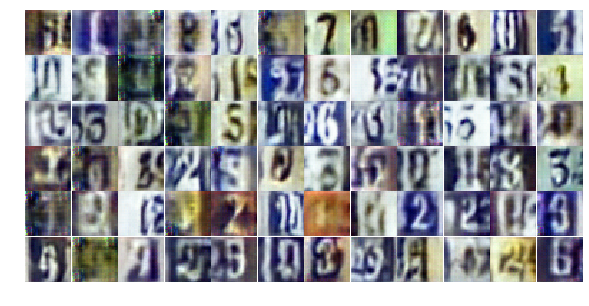

Epoch 11/25... Discriminator Loss: 1.2285... Generator Loss: 1.1804
Epoch 11/25... Discriminator Loss: 0.1309... Generator Loss: 3.7944
Epoch 11/25... Discriminator Loss: 1.3941... Generator Loss: 0.9447
Epoch 11/25... Discriminator Loss: 1.0712... Generator Loss: 0.7754
Epoch 11/25... Discriminator Loss: 1.2757... Generator Loss: 0.4562
Epoch 11/25... Discriminator Loss: 1.0234... Generator Loss: 0.9287
Epoch 11/25... Discriminator Loss: 1.1690... Generator Loss: 0.9158
Epoch 11/25... Discriminator Loss: 1.4001... Generator Loss: 0.8919
Epoch 11/25... Discriminator Loss: 1.1916... Generator Loss: 0.6521
Epoch 11/25... Discriminator Loss: 1.2765... Generator Loss: 0.6890


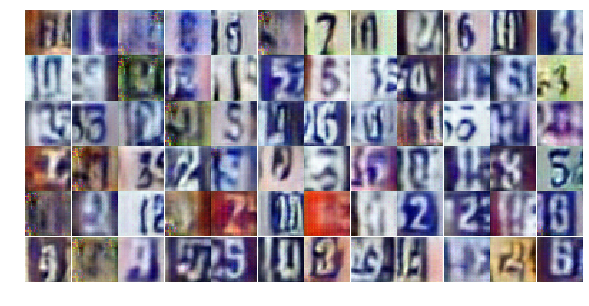

Epoch 12/25... Discriminator Loss: 1.4202... Generator Loss: 0.6774
Epoch 12/25... Discriminator Loss: 1.2472... Generator Loss: 0.6399
Epoch 12/25... Discriminator Loss: 1.3095... Generator Loss: 0.5495
Epoch 12/25... Discriminator Loss: 1.1352... Generator Loss: 0.7736
Epoch 12/25... Discriminator Loss: 1.2435... Generator Loss: 0.6706
Epoch 12/25... Discriminator Loss: 1.2961... Generator Loss: 0.6128
Epoch 12/25... Discriminator Loss: 1.2780... Generator Loss: 0.5732
Epoch 12/25... Discriminator Loss: 1.1209... Generator Loss: 0.8140
Epoch 12/25... Discriminator Loss: 1.2901... Generator Loss: 0.8510
Epoch 12/25... Discriminator Loss: 1.4962... Generator Loss: 0.5137


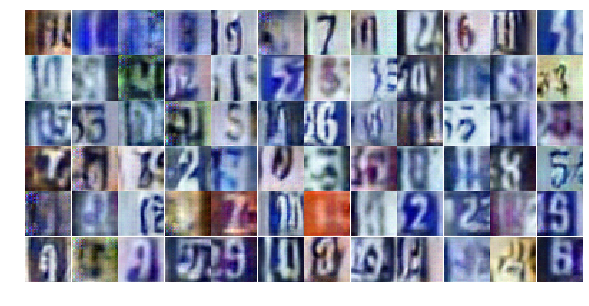

Epoch 12/25... Discriminator Loss: 1.0622... Generator Loss: 0.7815
Epoch 12/25... Discriminator Loss: 1.3547... Generator Loss: 0.6630
Epoch 12/25... Discriminator Loss: 1.1603... Generator Loss: 0.6849
Epoch 12/25... Discriminator Loss: 1.2317... Generator Loss: 0.7676
Epoch 12/25... Discriminator Loss: 1.1067... Generator Loss: 1.0775
Epoch 12/25... Discriminator Loss: 1.3771... Generator Loss: 0.5088
Epoch 12/25... Discriminator Loss: 1.5911... Generator Loss: 0.4038
Epoch 12/25... Discriminator Loss: 0.9911... Generator Loss: 0.8886
Epoch 12/25... Discriminator Loss: 1.0035... Generator Loss: 0.8838
Epoch 12/25... Discriminator Loss: 1.2208... Generator Loss: 0.6413


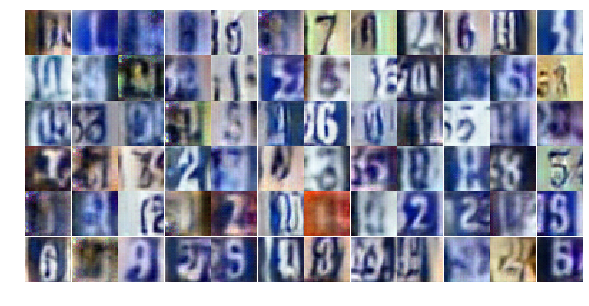

Epoch 12/25... Discriminator Loss: 1.0876... Generator Loss: 0.7750
Epoch 12/25... Discriminator Loss: 1.0150... Generator Loss: 0.8922
Epoch 12/25... Discriminator Loss: 1.2935... Generator Loss: 0.8342
Epoch 12/25... Discriminator Loss: 1.1289... Generator Loss: 1.0144
Epoch 12/25... Discriminator Loss: 1.0100... Generator Loss: 0.9899
Epoch 12/25... Discriminator Loss: 1.1049... Generator Loss: 0.6561
Epoch 12/25... Discriminator Loss: 1.0588... Generator Loss: 0.7588
Epoch 12/25... Discriminator Loss: 0.6814... Generator Loss: 1.4030
Epoch 12/25... Discriminator Loss: 1.0572... Generator Loss: 0.8874
Epoch 12/25... Discriminator Loss: 1.2127... Generator Loss: 0.6148


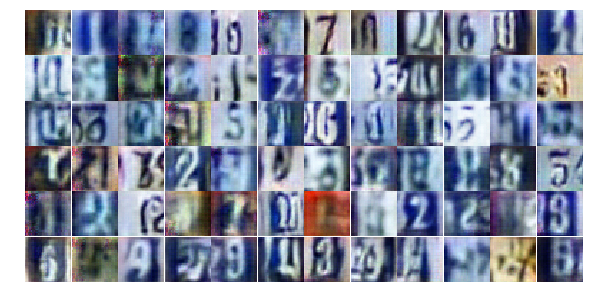

Epoch 12/25... Discriminator Loss: 1.2523... Generator Loss: 0.6558
Epoch 12/25... Discriminator Loss: 0.6372... Generator Loss: 3.6318
Epoch 12/25... Discriminator Loss: 0.2277... Generator Loss: 2.8783
Epoch 12/25... Discriminator Loss: 1.1591... Generator Loss: 0.6823
Epoch 12/25... Discriminator Loss: 1.1731... Generator Loss: 0.8285
Epoch 12/25... Discriminator Loss: 1.3429... Generator Loss: 0.5900
Epoch 12/25... Discriminator Loss: 1.2704... Generator Loss: 0.5552
Epoch 12/25... Discriminator Loss: 1.1655... Generator Loss: 0.7578
Epoch 12/25... Discriminator Loss: 1.1866... Generator Loss: 0.6734
Epoch 12/25... Discriminator Loss: 0.9795... Generator Loss: 1.0996


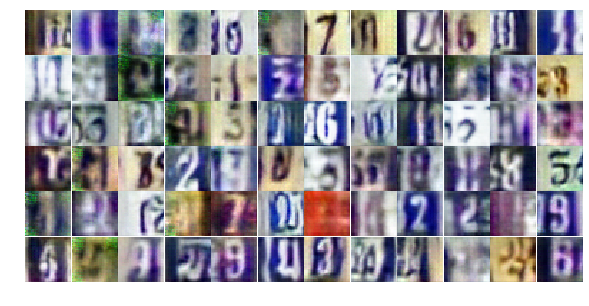

Epoch 12/25... Discriminator Loss: 1.3102... Generator Loss: 0.6670
Epoch 12/25... Discriminator Loss: 1.2099... Generator Loss: 0.7864
Epoch 12/25... Discriminator Loss: 0.6559... Generator Loss: 1.3601
Epoch 12/25... Discriminator Loss: 0.9569... Generator Loss: 0.6457
Epoch 12/25... Discriminator Loss: 0.7762... Generator Loss: 0.7404
Epoch 12/25... Discriminator Loss: 0.3401... Generator Loss: 1.5650
Epoch 12/25... Discriminator Loss: 1.7587... Generator Loss: 1.7005
Epoch 12/25... Discriminator Loss: 1.4289... Generator Loss: 1.2439
Epoch 12/25... Discriminator Loss: 1.5662... Generator Loss: 0.4435
Epoch 12/25... Discriminator Loss: 1.2248... Generator Loss: 0.7033


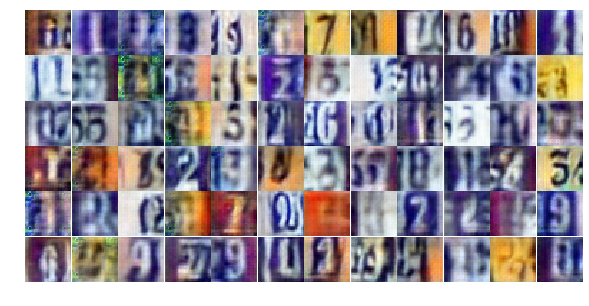

Epoch 12/25... Discriminator Loss: 0.9398... Generator Loss: 1.0293
Epoch 12/25... Discriminator Loss: 0.9990... Generator Loss: 0.7188
Epoch 12/25... Discriminator Loss: 0.8021... Generator Loss: 1.5335
Epoch 12/25... Discriminator Loss: 1.1571... Generator Loss: 2.8079
Epoch 12/25... Discriminator Loss: 0.7745... Generator Loss: 1.0470
Epoch 12/25... Discriminator Loss: 1.1910... Generator Loss: 1.2693
Epoch 12/25... Discriminator Loss: 0.3907... Generator Loss: 1.6602
Epoch 13/25... Discriminator Loss: 0.7546... Generator Loss: 0.8054
Epoch 13/25... Discriminator Loss: 0.5278... Generator Loss: 1.2758
Epoch 13/25... Discriminator Loss: 1.5092... Generator Loss: 0.3277


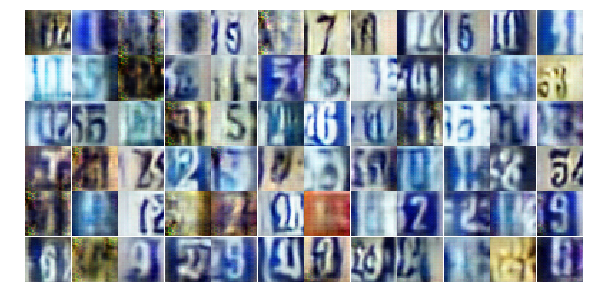

Epoch 13/25... Discriminator Loss: 0.5847... Generator Loss: 1.0806
Epoch 13/25... Discriminator Loss: 0.8041... Generator Loss: 2.6956
Epoch 13/25... Discriminator Loss: 1.2370... Generator Loss: 0.4203
Epoch 13/25... Discriminator Loss: 1.4285... Generator Loss: 0.4978
Epoch 13/25... Discriminator Loss: 0.4905... Generator Loss: 1.3019
Epoch 13/25... Discriminator Loss: 0.2229... Generator Loss: 2.1952
Epoch 13/25... Discriminator Loss: 1.2183... Generator Loss: 0.7843
Epoch 13/25... Discriminator Loss: 1.2722... Generator Loss: 0.5516
Epoch 13/25... Discriminator Loss: 1.0186... Generator Loss: 0.8368
Epoch 13/25... Discriminator Loss: 1.1098... Generator Loss: 0.7779


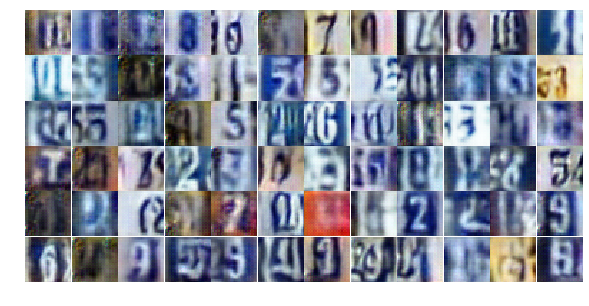

Epoch 13/25... Discriminator Loss: 1.2077... Generator Loss: 0.6730
Epoch 13/25... Discriminator Loss: 0.9854... Generator Loss: 0.8378
Epoch 13/25... Discriminator Loss: 1.2745... Generator Loss: 0.6061
Epoch 13/25... Discriminator Loss: 1.3796... Generator Loss: 0.6915
Epoch 13/25... Discriminator Loss: 1.2679... Generator Loss: 0.7487
Epoch 13/25... Discriminator Loss: 1.3439... Generator Loss: 0.9499
Epoch 13/25... Discriminator Loss: 1.2432... Generator Loss: 0.6417
Epoch 13/25... Discriminator Loss: 1.2887... Generator Loss: 0.5736
Epoch 13/25... Discriminator Loss: 1.2460... Generator Loss: 0.7173
Epoch 13/25... Discriminator Loss: 1.1449... Generator Loss: 0.5763


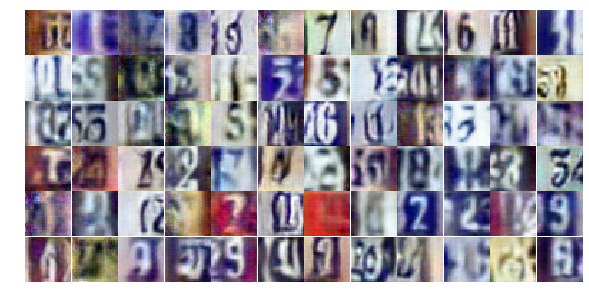

Epoch 13/25... Discriminator Loss: 1.1622... Generator Loss: 0.6314
Epoch 13/25... Discriminator Loss: 1.0314... Generator Loss: 0.7813
Epoch 13/25... Discriminator Loss: 1.1719... Generator Loss: 0.6341
Epoch 13/25... Discriminator Loss: 1.1132... Generator Loss: 0.7586
Epoch 13/25... Discriminator Loss: 1.1259... Generator Loss: 0.5408
Epoch 13/25... Discriminator Loss: 2.1938... Generator Loss: 2.7781
Epoch 13/25... Discriminator Loss: 4.1308... Generator Loss: 0.0229
Epoch 13/25... Discriminator Loss: 1.2319... Generator Loss: 0.9014
Epoch 13/25... Discriminator Loss: 1.0764... Generator Loss: 0.7923
Epoch 13/25... Discriminator Loss: 1.2560... Generator Loss: 0.7738


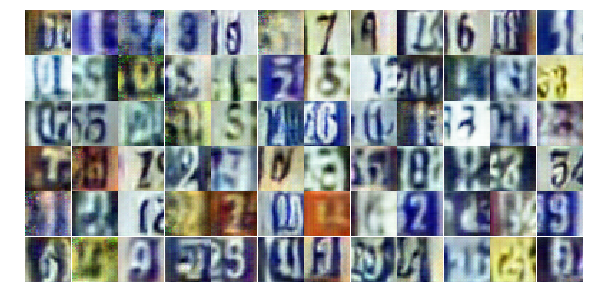

Epoch 13/25... Discriminator Loss: 1.2078... Generator Loss: 0.5683
Epoch 13/25... Discriminator Loss: 1.2148... Generator Loss: 0.8268
Epoch 13/25... Discriminator Loss: 1.3883... Generator Loss: 0.4185
Epoch 13/25... Discriminator Loss: 1.3307... Generator Loss: 0.6108
Epoch 13/25... Discriminator Loss: 1.1980... Generator Loss: 0.7049
Epoch 13/25... Discriminator Loss: 1.2555... Generator Loss: 0.6226
Epoch 13/25... Discriminator Loss: 1.0765... Generator Loss: 0.9548
Epoch 13/25... Discriminator Loss: 1.2095... Generator Loss: 0.6895
Epoch 13/25... Discriminator Loss: 1.1053... Generator Loss: 0.7238
Epoch 13/25... Discriminator Loss: 1.1363... Generator Loss: 0.6201


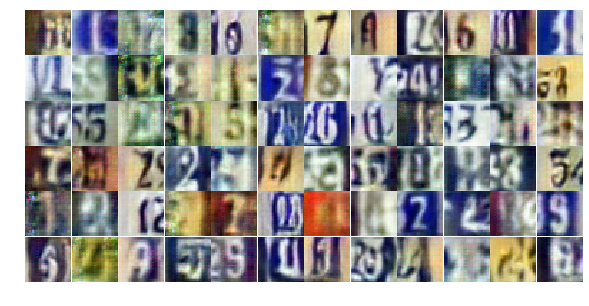

Epoch 13/25... Discriminator Loss: 0.9880... Generator Loss: 1.3146
Epoch 13/25... Discriminator Loss: 1.2064... Generator Loss: 0.5919
Epoch 13/25... Discriminator Loss: 1.2848... Generator Loss: 0.5603
Epoch 13/25... Discriminator Loss: 0.9817... Generator Loss: 1.1762
Epoch 13/25... Discriminator Loss: 1.0236... Generator Loss: 1.0351
Epoch 13/25... Discriminator Loss: 0.5830... Generator Loss: 1.0106
Epoch 13/25... Discriminator Loss: 3.2060... Generator Loss: 3.3110
Epoch 13/25... Discriminator Loss: 1.4352... Generator Loss: 1.0495
Epoch 13/25... Discriminator Loss: 1.5197... Generator Loss: 0.4270
Epoch 13/25... Discriminator Loss: 1.6257... Generator Loss: 0.3126


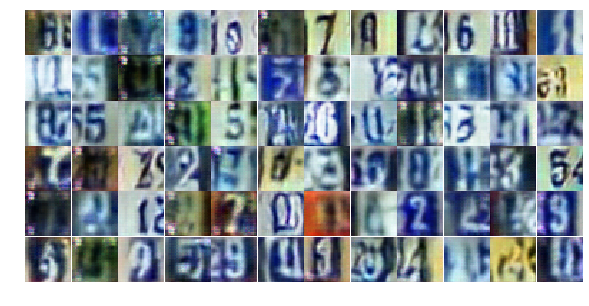

Epoch 13/25... Discriminator Loss: 0.9619... Generator Loss: 0.7327
Epoch 13/25... Discriminator Loss: 1.6967... Generator Loss: 0.2578
Epoch 13/25... Discriminator Loss: 0.5722... Generator Loss: 1.4005
Epoch 13/25... Discriminator Loss: 1.4536... Generator Loss: 3.5383
Epoch 14/25... Discriminator Loss: 1.6956... Generator Loss: 0.8001
Epoch 14/25... Discriminator Loss: 1.1879... Generator Loss: 0.8224
Epoch 14/25... Discriminator Loss: 1.3055... Generator Loss: 0.5844
Epoch 14/25... Discriminator Loss: 1.0662... Generator Loss: 1.0917
Epoch 14/25... Discriminator Loss: 1.1257... Generator Loss: 0.9218
Epoch 14/25... Discriminator Loss: 0.9446... Generator Loss: 0.8211


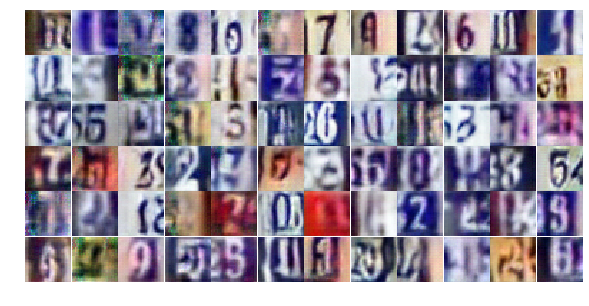

Epoch 14/25... Discriminator Loss: 1.4613... Generator Loss: 1.2897
Epoch 14/25... Discriminator Loss: 0.8114... Generator Loss: 1.3612
Epoch 14/25... Discriminator Loss: 0.2429... Generator Loss: 2.2624
Epoch 14/25... Discriminator Loss: 1.0748... Generator Loss: 0.5784
Epoch 14/25... Discriminator Loss: 1.6028... Generator Loss: 0.3099
Epoch 14/25... Discriminator Loss: 1.1438... Generator Loss: 0.6047
Epoch 14/25... Discriminator Loss: 1.0146... Generator Loss: 1.0012
Epoch 14/25... Discriminator Loss: 1.6748... Generator Loss: 0.3139
Epoch 14/25... Discriminator Loss: 0.8344... Generator Loss: 0.8534
Epoch 14/25... Discriminator Loss: 0.6505... Generator Loss: 1.0310


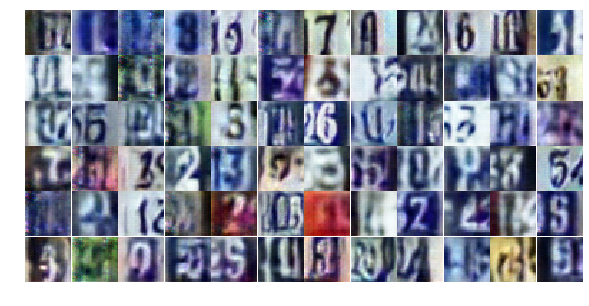

Epoch 14/25... Discriminator Loss: 0.3873... Generator Loss: 1.4954
Epoch 14/25... Discriminator Loss: 0.1015... Generator Loss: 3.9890
Epoch 14/25... Discriminator Loss: 0.0466... Generator Loss: 3.7274
Epoch 14/25... Discriminator Loss: 0.9414... Generator Loss: 1.6479
Epoch 14/25... Discriminator Loss: 0.9025... Generator Loss: 1.4846
Epoch 14/25... Discriminator Loss: 1.1155... Generator Loss: 0.7369
Epoch 14/25... Discriminator Loss: 1.2809... Generator Loss: 0.4852
Epoch 14/25... Discriminator Loss: 0.9464... Generator Loss: 0.9239
Epoch 14/25... Discriminator Loss: 1.0578... Generator Loss: 0.8255
Epoch 14/25... Discriminator Loss: 1.1041... Generator Loss: 0.7362


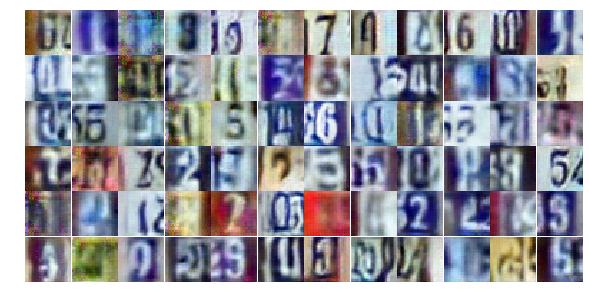

Epoch 14/25... Discriminator Loss: 1.4207... Generator Loss: 0.3803
Epoch 14/25... Discriminator Loss: 1.0872... Generator Loss: 0.7791
Epoch 14/25... Discriminator Loss: 0.9900... Generator Loss: 0.7842
Epoch 14/25... Discriminator Loss: 1.0368... Generator Loss: 0.9753
Epoch 14/25... Discriminator Loss: 1.0973... Generator Loss: 0.8538
Epoch 14/25... Discriminator Loss: 1.3445... Generator Loss: 0.5586
Epoch 14/25... Discriminator Loss: 1.1220... Generator Loss: 0.7483
Epoch 14/25... Discriminator Loss: 0.9135... Generator Loss: 1.1749
Epoch 14/25... Discriminator Loss: 0.8935... Generator Loss: 1.0666
Epoch 14/25... Discriminator Loss: 1.3371... Generator Loss: 0.5551


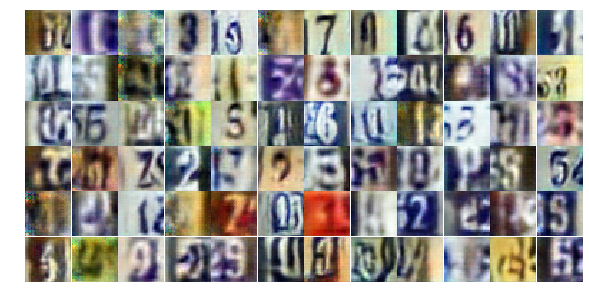

Epoch 14/25... Discriminator Loss: 1.4464... Generator Loss: 0.4624
Epoch 14/25... Discriminator Loss: 1.0187... Generator Loss: 0.8569
Epoch 14/25... Discriminator Loss: 1.8730... Generator Loss: 0.2785
Epoch 14/25... Discriminator Loss: 1.6405... Generator Loss: 0.3784
Epoch 14/25... Discriminator Loss: 1.2271... Generator Loss: 0.5262
Epoch 14/25... Discriminator Loss: 1.2154... Generator Loss: 0.9284
Epoch 14/25... Discriminator Loss: 1.2119... Generator Loss: 0.6405
Epoch 14/25... Discriminator Loss: 0.8680... Generator Loss: 0.9417
Epoch 14/25... Discriminator Loss: 1.3285... Generator Loss: 0.4628
Epoch 14/25... Discriminator Loss: 1.3396... Generator Loss: 0.4554


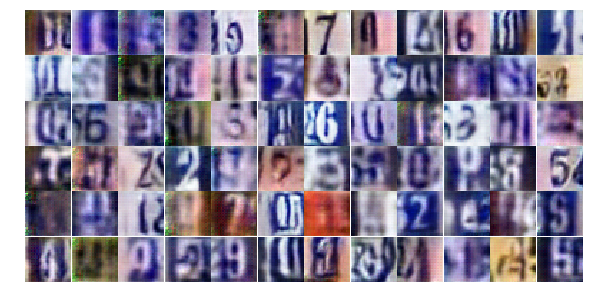

Epoch 14/25... Discriminator Loss: 1.2474... Generator Loss: 0.7679
Epoch 14/25... Discriminator Loss: 1.3695... Generator Loss: 0.4836
Epoch 14/25... Discriminator Loss: 1.1659... Generator Loss: 0.8254
Epoch 14/25... Discriminator Loss: 1.0960... Generator Loss: 0.7126
Epoch 14/25... Discriminator Loss: 1.2935... Generator Loss: 0.5048
Epoch 14/25... Discriminator Loss: 1.3696... Generator Loss: 0.5804
Epoch 14/25... Discriminator Loss: 1.3029... Generator Loss: 0.6157
Epoch 14/25... Discriminator Loss: 1.2037... Generator Loss: 0.6580
Epoch 14/25... Discriminator Loss: 1.0714... Generator Loss: 0.7844
Epoch 14/25... Discriminator Loss: 1.1069... Generator Loss: 0.6962


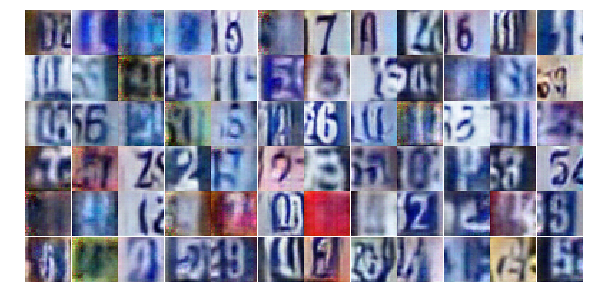

Epoch 14/25... Discriminator Loss: 1.1462... Generator Loss: 0.8860
Epoch 14/25... Discriminator Loss: 1.2501... Generator Loss: 0.5607
Epoch 15/25... Discriminator Loss: 1.0398... Generator Loss: 1.1441
Epoch 15/25... Discriminator Loss: 1.1036... Generator Loss: 0.8494
Epoch 15/25... Discriminator Loss: 1.1537... Generator Loss: 0.6723
Epoch 15/25... Discriminator Loss: 1.1556... Generator Loss: 0.6928
Epoch 15/25... Discriminator Loss: 1.1797... Generator Loss: 0.5645
Epoch 15/25... Discriminator Loss: 1.0309... Generator Loss: 0.8640
Epoch 15/25... Discriminator Loss: 1.4123... Generator Loss: 0.7612
Epoch 15/25... Discriminator Loss: 1.1272... Generator Loss: 0.7100


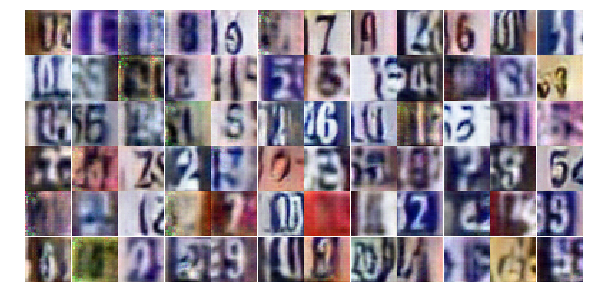

Epoch 15/25... Discriminator Loss: 1.1676... Generator Loss: 0.7324
Epoch 15/25... Discriminator Loss: 1.0061... Generator Loss: 0.8117
Epoch 15/25... Discriminator Loss: 1.3444... Generator Loss: 0.7618
Epoch 15/25... Discriminator Loss: 1.2774... Generator Loss: 0.5780
Epoch 15/25... Discriminator Loss: 1.1481... Generator Loss: 1.0101
Epoch 15/25... Discriminator Loss: 0.7277... Generator Loss: 1.1139
Epoch 15/25... Discriminator Loss: 0.7429... Generator Loss: 2.6497
Epoch 15/25... Discriminator Loss: 1.4254... Generator Loss: 0.4195
Epoch 15/25... Discriminator Loss: 1.0846... Generator Loss: 1.0820
Epoch 15/25... Discriminator Loss: 1.5996... Generator Loss: 0.3153


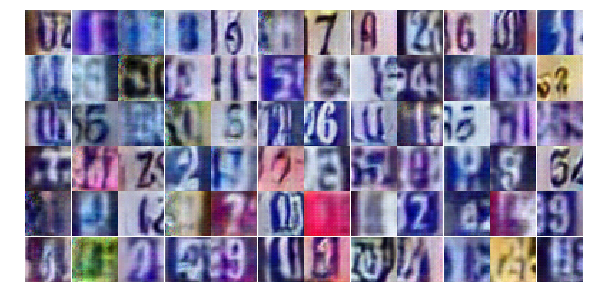

Epoch 15/25... Discriminator Loss: 1.3380... Generator Loss: 0.6400
Epoch 15/25... Discriminator Loss: 1.1233... Generator Loss: 0.7842
Epoch 15/25... Discriminator Loss: 1.3459... Generator Loss: 0.5192
Epoch 15/25... Discriminator Loss: 1.0756... Generator Loss: 0.8454
Epoch 15/25... Discriminator Loss: 1.9049... Generator Loss: 1.9899
Epoch 15/25... Discriminator Loss: 1.3983... Generator Loss: 0.7476
Epoch 15/25... Discriminator Loss: 1.4922... Generator Loss: 0.5235
Epoch 15/25... Discriminator Loss: 1.2335... Generator Loss: 0.5739
Epoch 15/25... Discriminator Loss: 0.9028... Generator Loss: 1.3169
Epoch 15/25... Discriminator Loss: 1.3199... Generator Loss: 0.4652


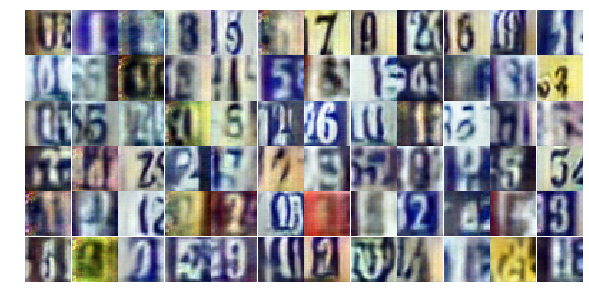

Epoch 15/25... Discriminator Loss: 1.0931... Generator Loss: 0.7876
Epoch 15/25... Discriminator Loss: 1.2368... Generator Loss: 0.6860
Epoch 15/25... Discriminator Loss: 0.9864... Generator Loss: 0.8861
Epoch 15/25... Discriminator Loss: 0.7402... Generator Loss: 1.0458
Epoch 15/25... Discriminator Loss: 1.5281... Generator Loss: 0.3445
Epoch 15/25... Discriminator Loss: 1.3233... Generator Loss: 1.3352
Epoch 15/25... Discriminator Loss: 1.3930... Generator Loss: 0.5038
Epoch 15/25... Discriminator Loss: 1.2294... Generator Loss: 0.5833
Epoch 15/25... Discriminator Loss: 1.0330... Generator Loss: 1.1771
Epoch 15/25... Discriminator Loss: 1.0445... Generator Loss: 0.7908


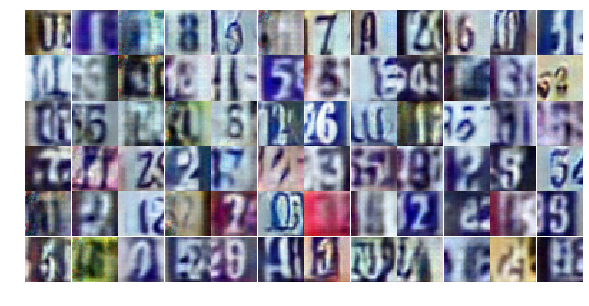

Epoch 15/25... Discriminator Loss: 1.1838... Generator Loss: 0.6171
Epoch 15/25... Discriminator Loss: 1.6556... Generator Loss: 0.3325
Epoch 15/25... Discriminator Loss: 0.8595... Generator Loss: 1.2467
Epoch 15/25... Discriminator Loss: 0.3440... Generator Loss: 1.6872
Epoch 15/25... Discriminator Loss: 1.1816... Generator Loss: 0.6980
Epoch 15/25... Discriminator Loss: 1.6688... Generator Loss: 0.3201
Epoch 15/25... Discriminator Loss: 1.0328... Generator Loss: 0.6473
Epoch 15/25... Discriminator Loss: 3.1187... Generator Loss: 0.0762
Epoch 15/25... Discriminator Loss: 1.4563... Generator Loss: 0.6076
Epoch 15/25... Discriminator Loss: 1.3170... Generator Loss: 0.7711


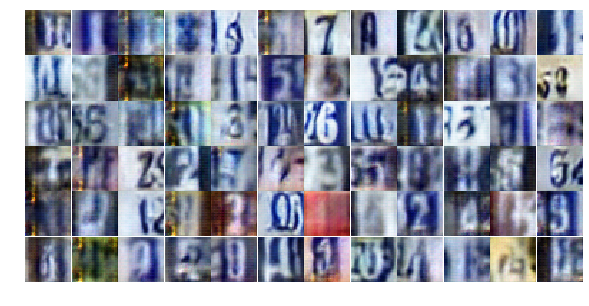

Epoch 15/25... Discriminator Loss: 1.3164... Generator Loss: 1.1463
Epoch 15/25... Discriminator Loss: 1.3476... Generator Loss: 0.4741
Epoch 15/25... Discriminator Loss: 0.9670... Generator Loss: 0.8796
Epoch 15/25... Discriminator Loss: 1.2854... Generator Loss: 0.5632
Epoch 15/25... Discriminator Loss: 1.2682... Generator Loss: 0.6244
Epoch 15/25... Discriminator Loss: 1.1982... Generator Loss: 0.6522
Epoch 15/25... Discriminator Loss: 1.1137... Generator Loss: 0.6373
Epoch 15/25... Discriminator Loss: 0.9475... Generator Loss: 0.8794
Epoch 15/25... Discriminator Loss: 1.4691... Generator Loss: 0.4553
Epoch 16/25... Discriminator Loss: 1.2214... Generator Loss: 0.6085


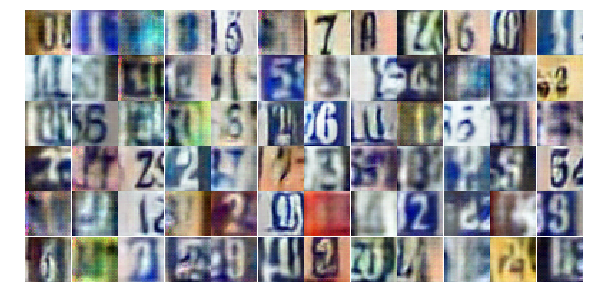

Epoch 16/25... Discriminator Loss: 1.0501... Generator Loss: 0.7775
Epoch 16/25... Discriminator Loss: 1.2041... Generator Loss: 0.6526
Epoch 16/25... Discriminator Loss: 1.1793... Generator Loss: 0.6542
Epoch 16/25... Discriminator Loss: 1.1087... Generator Loss: 0.7699
Epoch 16/25... Discriminator Loss: 1.1714... Generator Loss: 0.6816
Epoch 16/25... Discriminator Loss: 1.0416... Generator Loss: 0.9517
Epoch 16/25... Discriminator Loss: 1.3437... Generator Loss: 0.4893
Epoch 16/25... Discriminator Loss: 1.3648... Generator Loss: 0.5612
Epoch 16/25... Discriminator Loss: 1.2542... Generator Loss: 0.5233
Epoch 16/25... Discriminator Loss: 1.0188... Generator Loss: 0.7522


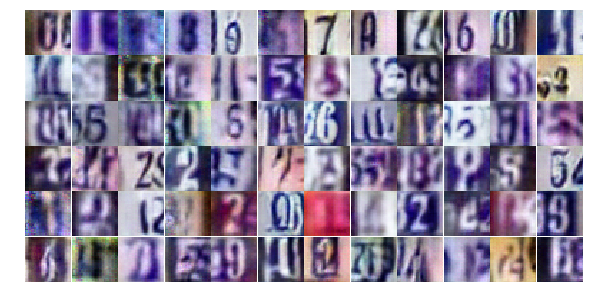

Epoch 16/25... Discriminator Loss: 1.6068... Generator Loss: 0.3385
Epoch 16/25... Discriminator Loss: 0.3299... Generator Loss: 3.4645
Epoch 16/25... Discriminator Loss: 0.8328... Generator Loss: 1.9197
Epoch 16/25... Discriminator Loss: 1.1068... Generator Loss: 2.5414
Epoch 16/25... Discriminator Loss: 0.3376... Generator Loss: 1.7522
Epoch 16/25... Discriminator Loss: 0.4685... Generator Loss: 1.2298
Epoch 16/25... Discriminator Loss: 0.0493... Generator Loss: 3.8006
Epoch 16/25... Discriminator Loss: 0.9368... Generator Loss: 0.6995
Epoch 16/25... Discriminator Loss: 0.7204... Generator Loss: 5.4863
Epoch 16/25... Discriminator Loss: 1.4691... Generator Loss: 0.7175


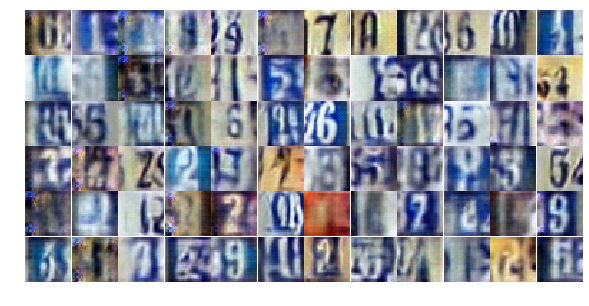

Epoch 16/25... Discriminator Loss: 0.3162... Generator Loss: 1.9081
Epoch 16/25... Discriminator Loss: 1.1234... Generator Loss: 1.1130
Epoch 16/25... Discriminator Loss: 1.0474... Generator Loss: 0.6929
Epoch 16/25... Discriminator Loss: 1.3147... Generator Loss: 0.6408
Epoch 16/25... Discriminator Loss: 1.3337... Generator Loss: 0.5077
Epoch 16/25... Discriminator Loss: 1.0523... Generator Loss: 0.8337
Epoch 16/25... Discriminator Loss: 0.7652... Generator Loss: 0.8901
Epoch 16/25... Discriminator Loss: 1.0487... Generator Loss: 0.7268
Epoch 16/25... Discriminator Loss: 1.6482... Generator Loss: 0.3412
Epoch 16/25... Discriminator Loss: 1.3343... Generator Loss: 0.5364


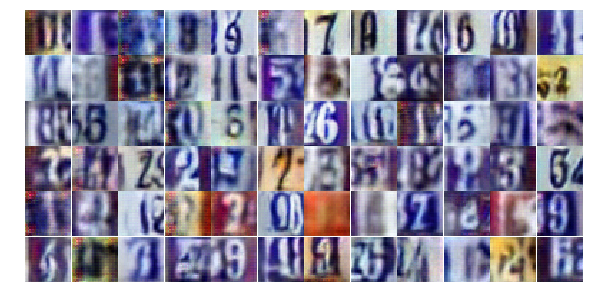

Epoch 16/25... Discriminator Loss: 1.0197... Generator Loss: 0.7348
Epoch 16/25... Discriminator Loss: 0.9780... Generator Loss: 0.8504
Epoch 16/25... Discriminator Loss: 0.9755... Generator Loss: 1.3223
Epoch 16/25... Discriminator Loss: 1.2500... Generator Loss: 0.5964
Epoch 16/25... Discriminator Loss: 1.0579... Generator Loss: 0.9128
Epoch 16/25... Discriminator Loss: 0.9617... Generator Loss: 0.8087
Epoch 16/25... Discriminator Loss: 1.0082... Generator Loss: 0.7924
Epoch 16/25... Discriminator Loss: 1.2757... Generator Loss: 0.4850
Epoch 16/25... Discriminator Loss: 1.3906... Generator Loss: 0.5168
Epoch 16/25... Discriminator Loss: 1.0160... Generator Loss: 0.9041


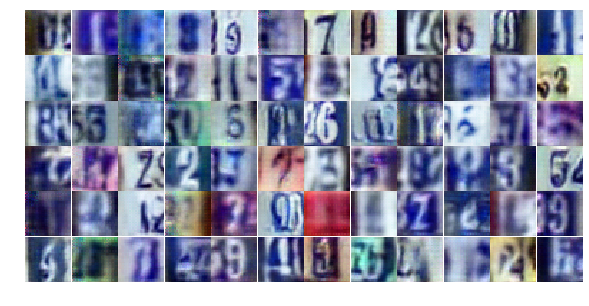

Epoch 16/25... Discriminator Loss: 0.2237... Generator Loss: 2.0243
Epoch 16/25... Discriminator Loss: 0.4086... Generator Loss: 1.4943
Epoch 16/25... Discriminator Loss: 0.4982... Generator Loss: 1.1947
Epoch 16/25... Discriminator Loss: 1.1749... Generator Loss: 1.2813
Epoch 16/25... Discriminator Loss: 1.0740... Generator Loss: 0.9290
Epoch 16/25... Discriminator Loss: 1.1695... Generator Loss: 0.6458
Epoch 16/25... Discriminator Loss: 1.0261... Generator Loss: 0.8188
Epoch 16/25... Discriminator Loss: 1.5077... Generator Loss: 0.4418
Epoch 16/25... Discriminator Loss: 0.9414... Generator Loss: 1.0095
Epoch 16/25... Discriminator Loss: 0.7917... Generator Loss: 1.0973


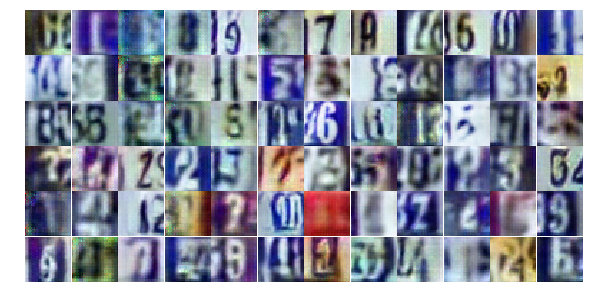

Epoch 16/25... Discriminator Loss: 1.3875... Generator Loss: 0.5707
Epoch 16/25... Discriminator Loss: 1.1224... Generator Loss: 0.8615
Epoch 16/25... Discriminator Loss: 1.4043... Generator Loss: 0.3926
Epoch 16/25... Discriminator Loss: 0.1508... Generator Loss: 2.8831
Epoch 16/25... Discriminator Loss: 0.4859... Generator Loss: 1.4416
Epoch 16/25... Discriminator Loss: 2.6183... Generator Loss: 3.3994
Epoch 17/25... Discriminator Loss: 1.3102... Generator Loss: 0.5469
Epoch 17/25... Discriminator Loss: 1.1954... Generator Loss: 0.6592
Epoch 17/25... Discriminator Loss: 0.9749... Generator Loss: 1.1191
Epoch 17/25... Discriminator Loss: 1.1764... Generator Loss: 0.7790


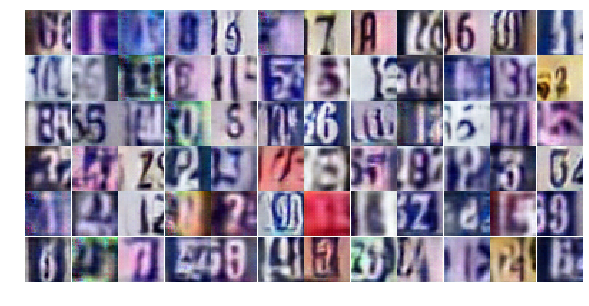

Epoch 17/25... Discriminator Loss: 0.8423... Generator Loss: 1.1254
Epoch 17/25... Discriminator Loss: 1.0730... Generator Loss: 0.6628
Epoch 17/25... Discriminator Loss: 1.1571... Generator Loss: 0.6962
Epoch 17/25... Discriminator Loss: 0.9770... Generator Loss: 0.8884
Epoch 17/25... Discriminator Loss: 0.7049... Generator Loss: 1.2842
Epoch 17/25... Discriminator Loss: 1.1716... Generator Loss: 0.8503
Epoch 17/25... Discriminator Loss: 1.0273... Generator Loss: 0.8915
Epoch 17/25... Discriminator Loss: 0.9377... Generator Loss: 0.6562
Epoch 17/25... Discriminator Loss: 1.1146... Generator Loss: 1.4742
Epoch 17/25... Discriminator Loss: 1.1554... Generator Loss: 0.9472


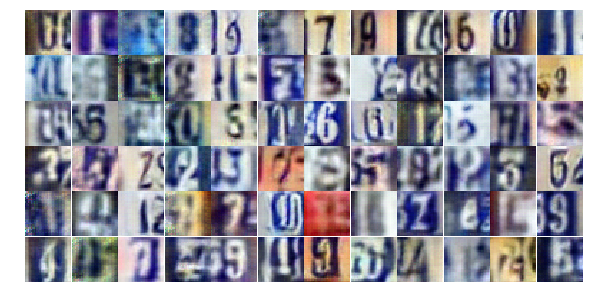

Epoch 17/25... Discriminator Loss: 1.1098... Generator Loss: 0.8558
Epoch 17/25... Discriminator Loss: 1.5164... Generator Loss: 0.3901
Epoch 17/25... Discriminator Loss: 1.0730... Generator Loss: 0.7082
Epoch 17/25... Discriminator Loss: 0.8598... Generator Loss: 0.9392
Epoch 17/25... Discriminator Loss: 1.2433... Generator Loss: 0.5484
Epoch 17/25... Discriminator Loss: 0.5139... Generator Loss: 1.1952
Epoch 17/25... Discriminator Loss: 0.8851... Generator Loss: 0.8738
Epoch 17/25... Discriminator Loss: 0.5493... Generator Loss: 3.6758
Epoch 17/25... Discriminator Loss: 1.0222... Generator Loss: 1.1031
Epoch 17/25... Discriminator Loss: 0.4155... Generator Loss: 1.4734


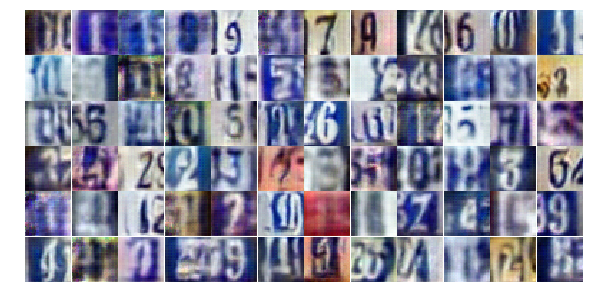

Epoch 17/25... Discriminator Loss: 1.1677... Generator Loss: 0.5123
Epoch 17/25... Discriminator Loss: 1.2076... Generator Loss: 0.8974
Epoch 17/25... Discriminator Loss: 1.0735... Generator Loss: 1.4271
Epoch 17/25... Discriminator Loss: 1.7356... Generator Loss: 0.3756
Epoch 17/25... Discriminator Loss: 1.4715... Generator Loss: 0.4199
Epoch 17/25... Discriminator Loss: 0.9840... Generator Loss: 0.7762
Epoch 17/25... Discriminator Loss: 1.1630... Generator Loss: 0.6842
Epoch 17/25... Discriminator Loss: 1.3033... Generator Loss: 0.4794
Epoch 17/25... Discriminator Loss: 1.3794... Generator Loss: 0.4670
Epoch 17/25... Discriminator Loss: 0.9525... Generator Loss: 0.8469


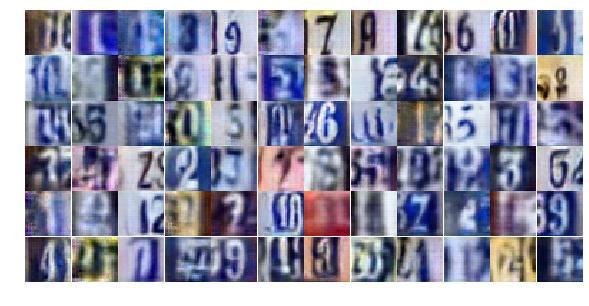

Epoch 17/25... Discriminator Loss: 1.0898... Generator Loss: 0.7745
Epoch 17/25... Discriminator Loss: 1.3612... Generator Loss: 0.4826
Epoch 17/25... Discriminator Loss: 1.0292... Generator Loss: 0.9805
Epoch 17/25... Discriminator Loss: 1.3503... Generator Loss: 0.5627
Epoch 17/25... Discriminator Loss: 1.3089... Generator Loss: 0.5288
Epoch 17/25... Discriminator Loss: 1.0739... Generator Loss: 0.7929
Epoch 17/25... Discriminator Loss: 1.3551... Generator Loss: 0.4907
Epoch 17/25... Discriminator Loss: 0.8285... Generator Loss: 1.0707
Epoch 17/25... Discriminator Loss: 0.6446... Generator Loss: 1.3174
Epoch 17/25... Discriminator Loss: 1.4078... Generator Loss: 0.3936


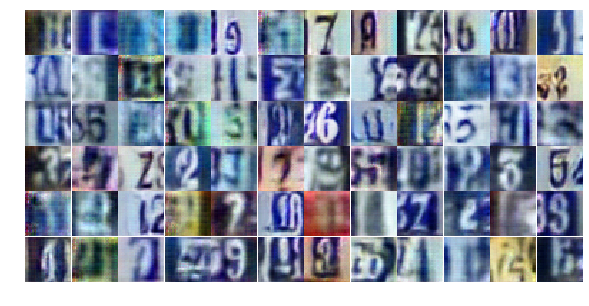

Epoch 17/25... Discriminator Loss: 1.5393... Generator Loss: 1.0496
Epoch 17/25... Discriminator Loss: 0.8890... Generator Loss: 1.5463
Epoch 17/25... Discriminator Loss: 0.3714... Generator Loss: 1.3866
Epoch 17/25... Discriminator Loss: 0.1849... Generator Loss: 4.1371
Epoch 17/25... Discriminator Loss: 1.4774... Generator Loss: 1.4374
Epoch 17/25... Discriminator Loss: 1.2633... Generator Loss: 0.8445
Epoch 17/25... Discriminator Loss: 1.2599... Generator Loss: 0.5393
Epoch 17/25... Discriminator Loss: 0.9778... Generator Loss: 0.7953
Epoch 17/25... Discriminator Loss: 1.0545... Generator Loss: 0.7967
Epoch 17/25... Discriminator Loss: 1.5814... Generator Loss: 0.3606


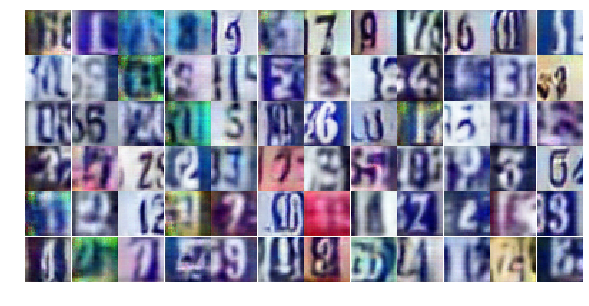

Epoch 17/25... Discriminator Loss: 1.0598... Generator Loss: 0.7448
Epoch 17/25... Discriminator Loss: 1.2920... Generator Loss: 0.5825
Epoch 17/25... Discriminator Loss: 1.0804... Generator Loss: 1.1479
Epoch 17/25... Discriminator Loss: 0.9939... Generator Loss: 0.8280
Epoch 18/25... Discriminator Loss: 1.5437... Generator Loss: 0.5833
Epoch 18/25... Discriminator Loss: 1.5945... Generator Loss: 0.3220
Epoch 18/25... Discriminator Loss: 0.7164... Generator Loss: 1.5127
Epoch 18/25... Discriminator Loss: 1.0696... Generator Loss: 0.7176
Epoch 18/25... Discriminator Loss: 1.3248... Generator Loss: 0.5142
Epoch 18/25... Discriminator Loss: 0.9602... Generator Loss: 0.8711


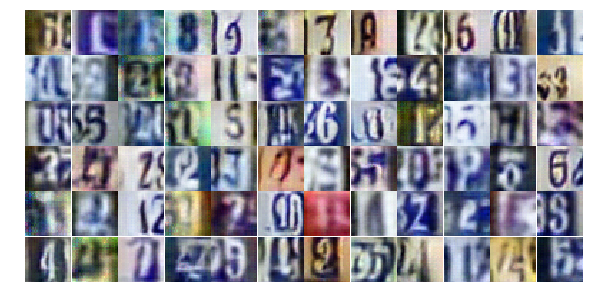

Epoch 18/25... Discriminator Loss: 0.1410... Generator Loss: 2.5729
Epoch 18/25... Discriminator Loss: 0.5902... Generator Loss: 0.9291
Epoch 18/25... Discriminator Loss: 0.2223... Generator Loss: 2.0100
Epoch 18/25... Discriminator Loss: 0.0503... Generator Loss: 4.1619
Epoch 18/25... Discriminator Loss: 0.0549... Generator Loss: 4.8451
Epoch 18/25... Discriminator Loss: 1.6885... Generator Loss: 1.0879
Epoch 18/25... Discriminator Loss: 0.7497... Generator Loss: 1.3428
Epoch 18/25... Discriminator Loss: 1.0611... Generator Loss: 0.7109
Epoch 18/25... Discriminator Loss: 1.1491... Generator Loss: 0.6315
Epoch 18/25... Discriminator Loss: 0.7288... Generator Loss: 1.1680


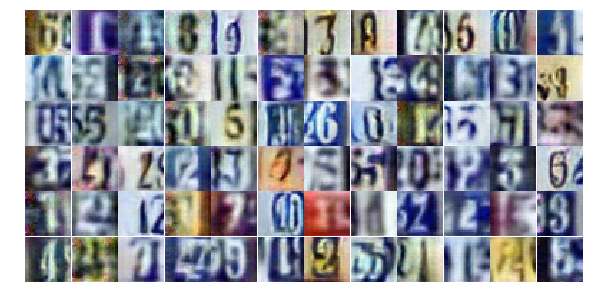

Epoch 18/25... Discriminator Loss: 1.0676... Generator Loss: 0.7270
Epoch 18/25... Discriminator Loss: 1.1264... Generator Loss: 0.8234
Epoch 18/25... Discriminator Loss: 1.2495... Generator Loss: 0.6044
Epoch 18/25... Discriminator Loss: 0.9115... Generator Loss: 1.1822
Epoch 18/25... Discriminator Loss: 1.0575... Generator Loss: 0.7477
Epoch 18/25... Discriminator Loss: 0.9403... Generator Loss: 0.9336
Epoch 18/25... Discriminator Loss: 1.4849... Generator Loss: 0.4246
Epoch 18/25... Discriminator Loss: 1.4795... Generator Loss: 0.4112
Epoch 18/25... Discriminator Loss: 1.0999... Generator Loss: 0.8696
Epoch 18/25... Discriminator Loss: 1.1506... Generator Loss: 0.6295


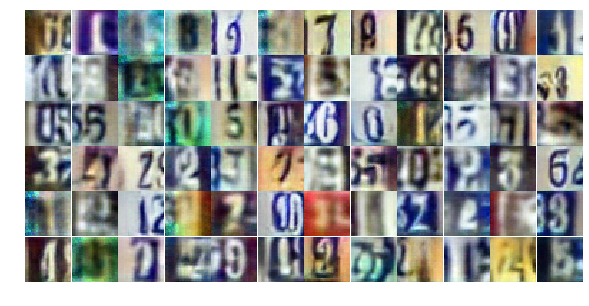

Epoch 18/25... Discriminator Loss: 0.8417... Generator Loss: 1.2757
Epoch 18/25... Discriminator Loss: 1.1058... Generator Loss: 0.7008
Epoch 18/25... Discriminator Loss: 1.2669... Generator Loss: 0.5644
Epoch 18/25... Discriminator Loss: 1.2816... Generator Loss: 0.4934
Epoch 18/25... Discriminator Loss: 1.2042... Generator Loss: 0.5867
Epoch 18/25... Discriminator Loss: 1.0270... Generator Loss: 1.1551
Epoch 18/25... Discriminator Loss: 1.0605... Generator Loss: 0.7052
Epoch 18/25... Discriminator Loss: 0.6973... Generator Loss: 1.2696
Epoch 18/25... Discriminator Loss: 1.0510... Generator Loss: 0.7114
Epoch 18/25... Discriminator Loss: 1.2521... Generator Loss: 0.5939


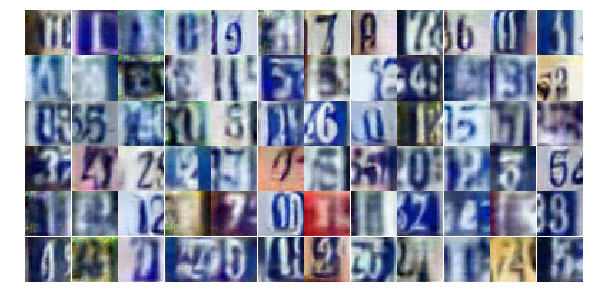

Epoch 18/25... Discriminator Loss: 0.7094... Generator Loss: 1.1687
Epoch 18/25... Discriminator Loss: 2.1059... Generator Loss: 3.2250
Epoch 18/25... Discriminator Loss: 1.1105... Generator Loss: 0.6945
Epoch 18/25... Discriminator Loss: 1.0039... Generator Loss: 0.7752
Epoch 18/25... Discriminator Loss: 1.1441... Generator Loss: 0.8112
Epoch 18/25... Discriminator Loss: 1.4245... Generator Loss: 0.4233
Epoch 18/25... Discriminator Loss: 1.4806... Generator Loss: 0.3924
Epoch 18/25... Discriminator Loss: 1.1465... Generator Loss: 0.9293
Epoch 18/25... Discriminator Loss: 1.3416... Generator Loss: 0.5070
Epoch 18/25... Discriminator Loss: 0.5757... Generator Loss: 3.4230


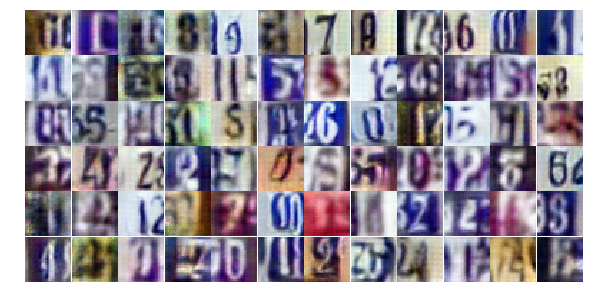

Epoch 18/25... Discriminator Loss: 1.1393... Generator Loss: 0.6883
Epoch 18/25... Discriminator Loss: 1.1328... Generator Loss: 0.5864
Epoch 18/25... Discriminator Loss: 1.0937... Generator Loss: 0.7555
Epoch 18/25... Discriminator Loss: 1.5133... Generator Loss: 0.3698
Epoch 18/25... Discriminator Loss: 1.2916... Generator Loss: 0.5739
Epoch 18/25... Discriminator Loss: 0.9512... Generator Loss: 1.3221
Epoch 18/25... Discriminator Loss: 0.8849... Generator Loss: 0.9257
Epoch 18/25... Discriminator Loss: 0.7324... Generator Loss: 1.0852
Epoch 18/25... Discriminator Loss: 0.4451... Generator Loss: 3.4250
Epoch 18/25... Discriminator Loss: 3.2237... Generator Loss: 4.6710


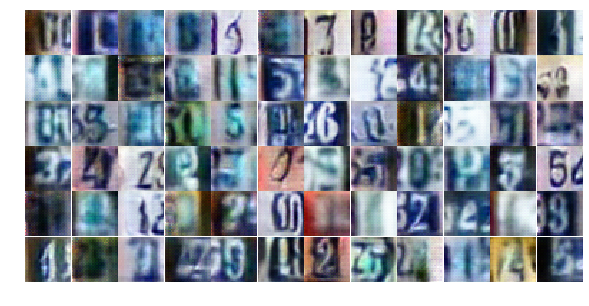

Epoch 18/25... Discriminator Loss: 1.1152... Generator Loss: 1.4482
Epoch 19/25... Discriminator Loss: 1.1973... Generator Loss: 1.3283
Epoch 19/25... Discriminator Loss: 1.3641... Generator Loss: 0.4475
Epoch 19/25... Discriminator Loss: 1.3208... Generator Loss: 0.4793
Epoch 19/25... Discriminator Loss: 0.9770... Generator Loss: 1.4373
Epoch 19/25... Discriminator Loss: 1.2707... Generator Loss: 0.5969
Epoch 19/25... Discriminator Loss: 0.1008... Generator Loss: 3.6177
Epoch 19/25... Discriminator Loss: 0.8277... Generator Loss: 0.7407
Epoch 19/25... Discriminator Loss: 0.7769... Generator Loss: 1.2205
Epoch 19/25... Discriminator Loss: 1.1972... Generator Loss: 0.6159


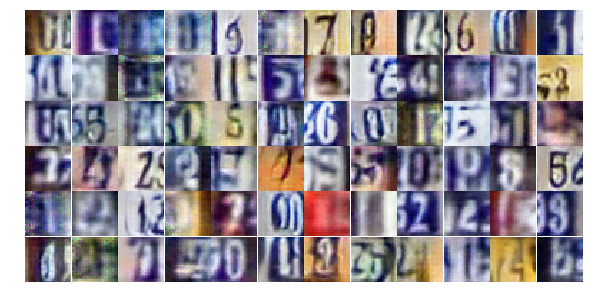

Epoch 19/25... Discriminator Loss: 1.0553... Generator Loss: 0.7629
Epoch 19/25... Discriminator Loss: 1.0327... Generator Loss: 0.9171
Epoch 19/25... Discriminator Loss: 1.1104... Generator Loss: 0.6315
Epoch 19/25... Discriminator Loss: 1.7944... Generator Loss: 0.2579
Epoch 19/25... Discriminator Loss: 1.2270... Generator Loss: 0.5222
Epoch 19/25... Discriminator Loss: 0.9471... Generator Loss: 0.8521
Epoch 19/25... Discriminator Loss: 0.9106... Generator Loss: 0.6725
Epoch 19/25... Discriminator Loss: 1.8871... Generator Loss: 0.2526
Epoch 19/25... Discriminator Loss: 1.6405... Generator Loss: 0.3142
Epoch 19/25... Discriminator Loss: 1.3710... Generator Loss: 0.4903


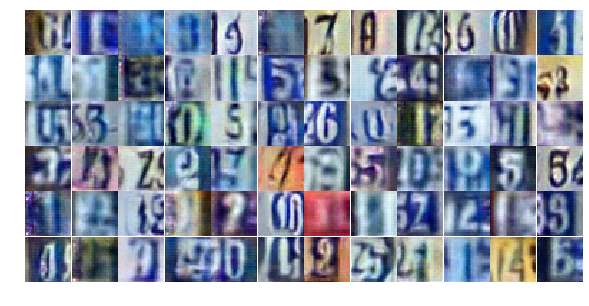

Epoch 19/25... Discriminator Loss: 1.4040... Generator Loss: 0.4315
Epoch 19/25... Discriminator Loss: 1.4138... Generator Loss: 0.4555
Epoch 19/25... Discriminator Loss: 1.2488... Generator Loss: 0.5661
Epoch 19/25... Discriminator Loss: 1.3026... Generator Loss: 0.6622
Epoch 19/25... Discriminator Loss: 1.3511... Generator Loss: 0.4704
Epoch 19/25... Discriminator Loss: 0.9871... Generator Loss: 0.7599
Epoch 19/25... Discriminator Loss: 1.0943... Generator Loss: 0.6832
Epoch 19/25... Discriminator Loss: 0.6969... Generator Loss: 1.0509
Epoch 19/25... Discriminator Loss: 0.1230... Generator Loss: 3.0260
Epoch 19/25... Discriminator Loss: 1.4510... Generator Loss: 1.2484


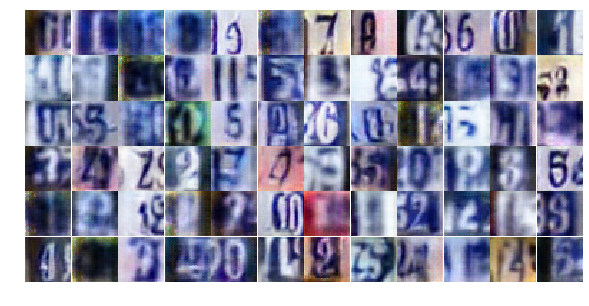

Epoch 19/25... Discriminator Loss: 1.6169... Generator Loss: 1.0268
Epoch 19/25... Discriminator Loss: 0.8944... Generator Loss: 1.1148
Epoch 19/25... Discriminator Loss: 1.2074... Generator Loss: 0.5342
Epoch 19/25... Discriminator Loss: 0.9872... Generator Loss: 1.3958
Epoch 19/25... Discriminator Loss: 1.0615... Generator Loss: 0.8628
Epoch 19/25... Discriminator Loss: 1.5304... Generator Loss: 0.4084
Epoch 19/25... Discriminator Loss: 0.8468... Generator Loss: 1.1139
Epoch 19/25... Discriminator Loss: 0.7373... Generator Loss: 1.4609
Epoch 19/25... Discriminator Loss: 1.1531... Generator Loss: 0.6249
Epoch 19/25... Discriminator Loss: 0.9775... Generator Loss: 0.9770


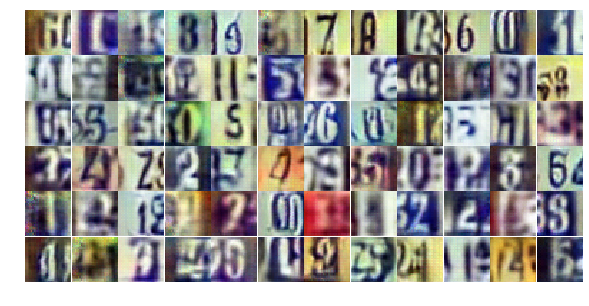

Epoch 19/25... Discriminator Loss: 1.1332... Generator Loss: 0.6327
Epoch 19/25... Discriminator Loss: 1.1685... Generator Loss: 0.6321
Epoch 19/25... Discriminator Loss: 1.2455... Generator Loss: 0.4949
Epoch 19/25... Discriminator Loss: 0.9563... Generator Loss: 0.8819
Epoch 19/25... Discriminator Loss: 0.8867... Generator Loss: 1.3212
Epoch 19/25... Discriminator Loss: 0.6907... Generator Loss: 1.0224
Epoch 19/25... Discriminator Loss: 1.2348... Generator Loss: 0.5967
Epoch 19/25... Discriminator Loss: 0.8395... Generator Loss: 1.1683
Epoch 19/25... Discriminator Loss: 1.2774... Generator Loss: 0.5773
Epoch 19/25... Discriminator Loss: 0.8199... Generator Loss: 1.0020


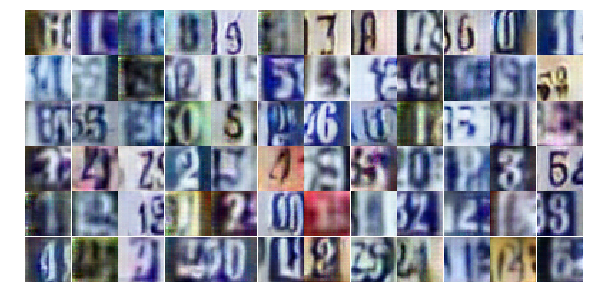

Epoch 19/25... Discriminator Loss: 1.4766... Generator Loss: 0.3909
Epoch 19/25... Discriminator Loss: 0.6531... Generator Loss: 1.4131
Epoch 19/25... Discriminator Loss: 0.1901... Generator Loss: 3.8060
Epoch 19/25... Discriminator Loss: 0.3911... Generator Loss: 1.4114
Epoch 19/25... Discriminator Loss: 0.6308... Generator Loss: 2.5978
Epoch 19/25... Discriminator Loss: 1.0675... Generator Loss: 0.7713
Epoch 19/25... Discriminator Loss: 1.6232... Generator Loss: 0.3469
Epoch 19/25... Discriminator Loss: 0.8116... Generator Loss: 1.1115
Epoch 20/25... Discriminator Loss: 1.2193... Generator Loss: 0.6224
Epoch 20/25... Discriminator Loss: 1.0150... Generator Loss: 0.7618


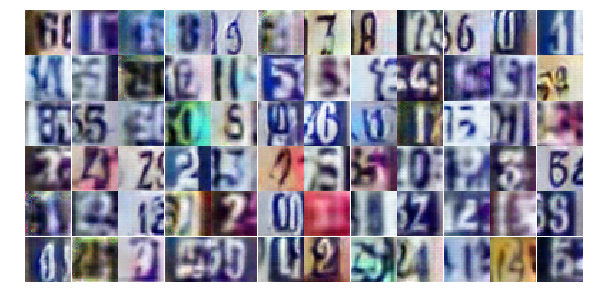

Epoch 20/25... Discriminator Loss: 1.0795... Generator Loss: 0.6413
Epoch 20/25... Discriminator Loss: 1.3975... Generator Loss: 0.4512
Epoch 20/25... Discriminator Loss: 1.3143... Generator Loss: 0.4394
Epoch 20/25... Discriminator Loss: 1.2314... Generator Loss: 0.5814
Epoch 20/25... Discriminator Loss: 0.9441... Generator Loss: 0.8534
Epoch 20/25... Discriminator Loss: 0.9548... Generator Loss: 0.8464
Epoch 20/25... Discriminator Loss: 1.1062... Generator Loss: 0.6160
Epoch 20/25... Discriminator Loss: 1.1769... Generator Loss: 1.5486
Epoch 20/25... Discriminator Loss: 0.8626... Generator Loss: 0.9694
Epoch 20/25... Discriminator Loss: 1.1776... Generator Loss: 0.5586


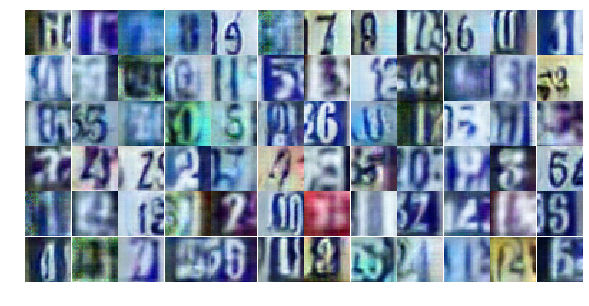

Epoch 20/25... Discriminator Loss: 1.4791... Generator Loss: 0.4636
Epoch 20/25... Discriminator Loss: 1.5560... Generator Loss: 0.3667
Epoch 20/25... Discriminator Loss: 1.9273... Generator Loss: 0.5395
Epoch 20/25... Discriminator Loss: 1.3093... Generator Loss: 0.5676
Epoch 20/25... Discriminator Loss: 1.3966... Generator Loss: 0.5633
Epoch 20/25... Discriminator Loss: 1.2988... Generator Loss: 0.5232
Epoch 20/25... Discriminator Loss: 1.3513... Generator Loss: 0.5813
Epoch 20/25... Discriminator Loss: 0.9386... Generator Loss: 0.8731
Epoch 20/25... Discriminator Loss: 1.0933... Generator Loss: 0.7733
Epoch 20/25... Discriminator Loss: 0.9227... Generator Loss: 0.7565


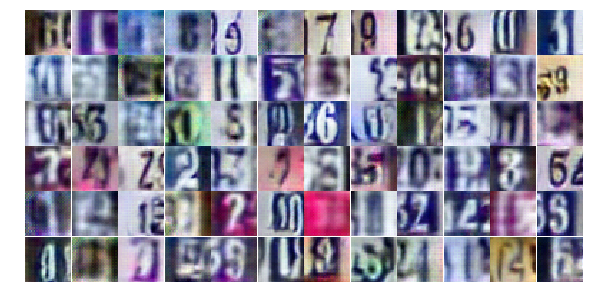

Epoch 20/25... Discriminator Loss: 0.5971... Generator Loss: 4.7324
Epoch 20/25... Discriminator Loss: 0.7592... Generator Loss: 0.8359
Epoch 20/25... Discriminator Loss: 0.1244... Generator Loss: 2.9551
Epoch 20/25... Discriminator Loss: 2.0875... Generator Loss: 0.2277
Epoch 20/25... Discriminator Loss: 0.1676... Generator Loss: 2.3514
Epoch 20/25... Discriminator Loss: 0.0952... Generator Loss: 2.8481
Epoch 20/25... Discriminator Loss: 1.0340... Generator Loss: 2.0400
Epoch 20/25... Discriminator Loss: 1.6714... Generator Loss: 0.3352
Epoch 20/25... Discriminator Loss: 1.8561... Generator Loss: 0.2990
Epoch 20/25... Discriminator Loss: 0.8713... Generator Loss: 1.1551


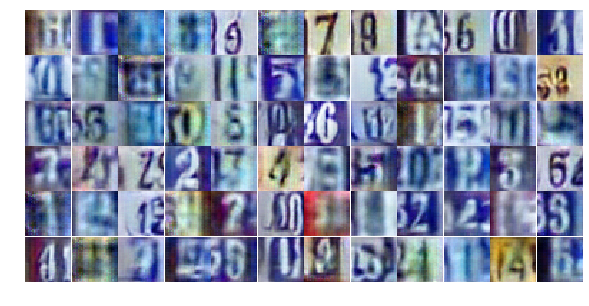

Epoch 20/25... Discriminator Loss: 0.8066... Generator Loss: 0.9013
Epoch 20/25... Discriminator Loss: 1.3557... Generator Loss: 0.5008
Epoch 20/25... Discriminator Loss: 1.3825... Generator Loss: 0.4995
Epoch 20/25... Discriminator Loss: 1.1165... Generator Loss: 1.3407
Epoch 20/25... Discriminator Loss: 1.1979... Generator Loss: 0.7440
Epoch 20/25... Discriminator Loss: 2.0689... Generator Loss: 0.2305
Epoch 20/25... Discriminator Loss: 1.1434... Generator Loss: 0.6755
Epoch 20/25... Discriminator Loss: 0.3394... Generator Loss: 1.9367
Epoch 20/25... Discriminator Loss: 1.3404... Generator Loss: 0.7890
Epoch 20/25... Discriminator Loss: 1.1802... Generator Loss: 0.7004


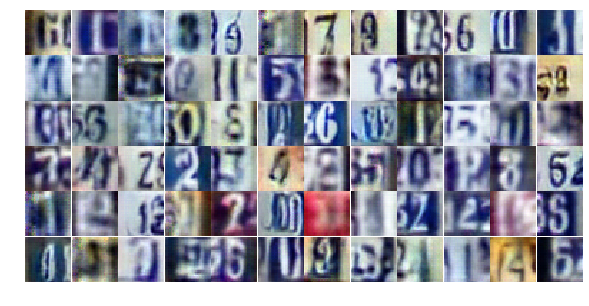

Epoch 20/25... Discriminator Loss: 1.1651... Generator Loss: 0.6172
Epoch 20/25... Discriminator Loss: 1.1960... Generator Loss: 0.6557
Epoch 20/25... Discriminator Loss: 0.9210... Generator Loss: 1.2475
Epoch 20/25... Discriminator Loss: 1.0380... Generator Loss: 0.7542
Epoch 20/25... Discriminator Loss: 0.8794... Generator Loss: 1.1858
Epoch 20/25... Discriminator Loss: 1.0480... Generator Loss: 0.6924
Epoch 20/25... Discriminator Loss: 1.3048... Generator Loss: 0.5191
Epoch 20/25... Discriminator Loss: 0.8765... Generator Loss: 0.9252
Epoch 20/25... Discriminator Loss: 1.2854... Generator Loss: 0.4794
Epoch 20/25... Discriminator Loss: 1.0405... Generator Loss: 0.7067


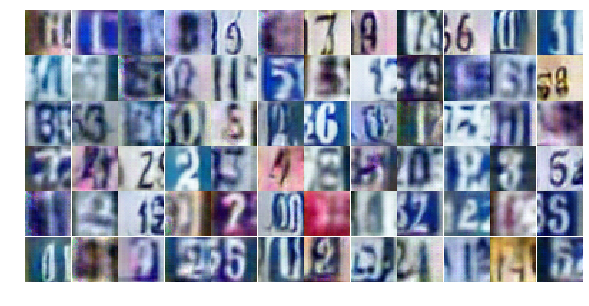

Epoch 20/25... Discriminator Loss: 1.2233... Generator Loss: 0.5283
Epoch 20/25... Discriminator Loss: 0.9408... Generator Loss: 0.8386
Epoch 20/25... Discriminator Loss: 0.6866... Generator Loss: 1.2897
Epoch 20/25... Discriminator Loss: 1.1871... Generator Loss: 1.1452
Epoch 20/25... Discriminator Loss: 1.0395... Generator Loss: 0.7649
Epoch 20/25... Discriminator Loss: 0.8511... Generator Loss: 0.8718
Epoch 21/25... Discriminator Loss: 1.3182... Generator Loss: 0.5031
Epoch 21/25... Discriminator Loss: 1.0122... Generator Loss: 0.6776
Epoch 21/25... Discriminator Loss: 1.2586... Generator Loss: 0.4691
Epoch 21/25... Discriminator Loss: 1.3803... Generator Loss: 0.4577


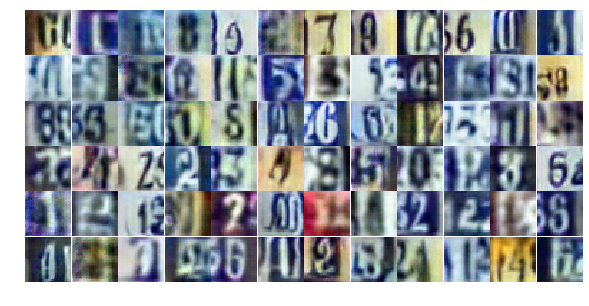

Epoch 21/25... Discriminator Loss: 0.8806... Generator Loss: 1.0054
Epoch 21/25... Discriminator Loss: 0.4749... Generator Loss: 1.7094
Epoch 21/25... Discriminator Loss: 1.3888... Generator Loss: 0.4442
Epoch 21/25... Discriminator Loss: 0.8870... Generator Loss: 0.8937
Epoch 21/25... Discriminator Loss: 1.0209... Generator Loss: 0.7370
Epoch 21/25... Discriminator Loss: 0.7355... Generator Loss: 1.0648
Epoch 21/25... Discriminator Loss: 1.1884... Generator Loss: 2.5683
Epoch 21/25... Discriminator Loss: 0.2866... Generator Loss: 2.7781
Epoch 21/25... Discriminator Loss: 1.2152... Generator Loss: 0.7475
Epoch 21/25... Discriminator Loss: 1.7553... Generator Loss: 0.2987


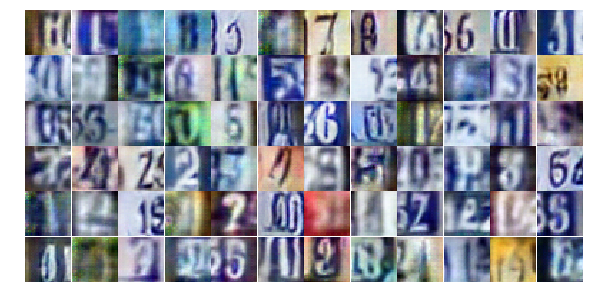

Epoch 21/25... Discriminator Loss: 0.5753... Generator Loss: 1.3899
Epoch 21/25... Discriminator Loss: 1.1342... Generator Loss: 0.5465
Epoch 21/25... Discriminator Loss: 1.0485... Generator Loss: 0.8125
Epoch 21/25... Discriminator Loss: 0.9122... Generator Loss: 0.7413
Epoch 21/25... Discriminator Loss: 0.7004... Generator Loss: 1.3216
Epoch 21/25... Discriminator Loss: 1.5447... Generator Loss: 0.3894
Epoch 21/25... Discriminator Loss: 1.6584... Generator Loss: 0.4279
Epoch 21/25... Discriminator Loss: 0.4084... Generator Loss: 3.5054
Epoch 21/25... Discriminator Loss: 0.7966... Generator Loss: 1.1185
Epoch 21/25... Discriminator Loss: 0.7884... Generator Loss: 1.0971


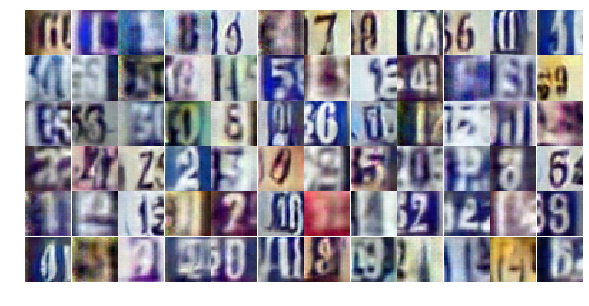

Epoch 21/25... Discriminator Loss: 1.1074... Generator Loss: 0.6941
Epoch 21/25... Discriminator Loss: 0.7475... Generator Loss: 0.9286
Epoch 21/25... Discriminator Loss: 0.5605... Generator Loss: 1.3089
Epoch 21/25... Discriminator Loss: 0.1375... Generator Loss: 2.8673
Epoch 21/25... Discriminator Loss: 1.5754... Generator Loss: 2.7894
Epoch 21/25... Discriminator Loss: 1.7816... Generator Loss: 0.3382
Epoch 21/25... Discriminator Loss: 0.3208... Generator Loss: 2.3804
Epoch 21/25... Discriminator Loss: 0.8269... Generator Loss: 0.8466
Epoch 21/25... Discriminator Loss: 1.2331... Generator Loss: 0.5242
Epoch 21/25... Discriminator Loss: 1.9954... Generator Loss: 0.2471


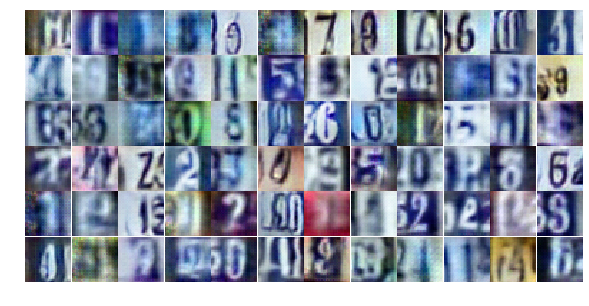

Epoch 21/25... Discriminator Loss: 0.5784... Generator Loss: 1.5193
Epoch 21/25... Discriminator Loss: 0.3310... Generator Loss: 1.6033
Epoch 21/25... Discriminator Loss: 2.0894... Generator Loss: 0.3778
Epoch 21/25... Discriminator Loss: 1.3172... Generator Loss: 0.6484
Epoch 21/25... Discriminator Loss: 0.9040... Generator Loss: 0.9601
Epoch 21/25... Discriminator Loss: 1.2044... Generator Loss: 0.5734
Epoch 21/25... Discriminator Loss: 1.3298... Generator Loss: 0.5041
Epoch 21/25... Discriminator Loss: 1.6041... Generator Loss: 0.4121
Epoch 21/25... Discriminator Loss: 1.0100... Generator Loss: 0.8064
Epoch 21/25... Discriminator Loss: 0.6539... Generator Loss: 1.5518


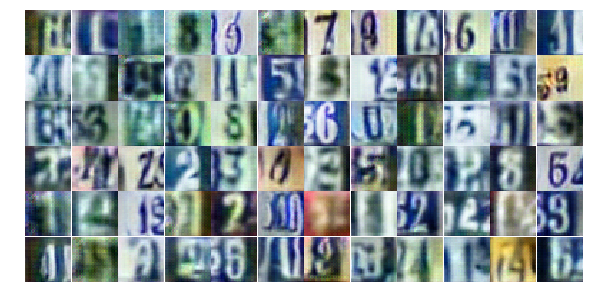

Epoch 21/25... Discriminator Loss: 1.2286... Generator Loss: 0.6014
Epoch 21/25... Discriminator Loss: 1.1982... Generator Loss: 0.6222
Epoch 21/25... Discriminator Loss: 0.8617... Generator Loss: 1.0088
Epoch 21/25... Discriminator Loss: 1.2518... Generator Loss: 0.5374
Epoch 21/25... Discriminator Loss: 0.7828... Generator Loss: 1.0923
Epoch 21/25... Discriminator Loss: 1.2074... Generator Loss: 0.5670
Epoch 21/25... Discriminator Loss: 1.4062... Generator Loss: 0.5214
Epoch 21/25... Discriminator Loss: 1.5018... Generator Loss: 0.5669
Epoch 21/25... Discriminator Loss: 0.6627... Generator Loss: 4.0799
Epoch 21/25... Discriminator Loss: 1.2880... Generator Loss: 0.5080


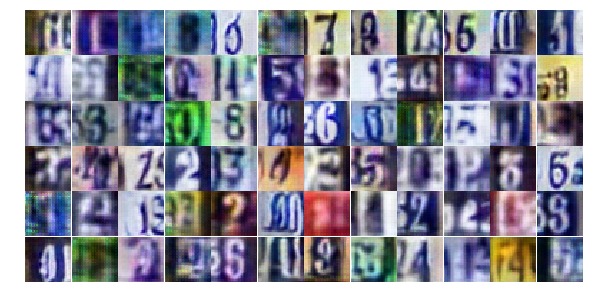

Epoch 21/25... Discriminator Loss: 0.7967... Generator Loss: 0.8184
Epoch 21/25... Discriminator Loss: 0.0815... Generator Loss: 4.1494
Epoch 21/25... Discriminator Loss: 1.0652... Generator Loss: 0.6138
Epoch 22/25... Discriminator Loss: 3.7038... Generator Loss: 1.4963
Epoch 22/25... Discriminator Loss: 1.1411... Generator Loss: 0.6648
Epoch 22/25... Discriminator Loss: 1.0350... Generator Loss: 0.5795
Epoch 22/25... Discriminator Loss: 1.3087... Generator Loss: 1.2820
Epoch 22/25... Discriminator Loss: 0.8564... Generator Loss: 2.0346
Epoch 22/25... Discriminator Loss: 1.5198... Generator Loss: 0.4062
Epoch 22/25... Discriminator Loss: 1.4879... Generator Loss: 0.4968


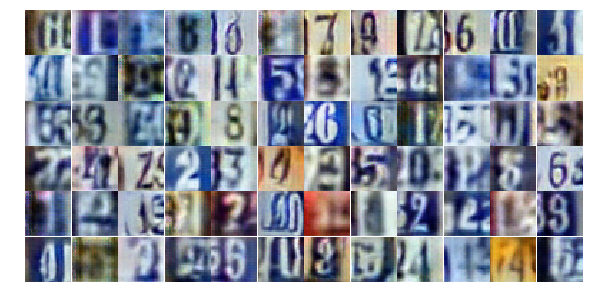

Epoch 22/25... Discriminator Loss: 1.1129... Generator Loss: 0.6652
Epoch 22/25... Discriminator Loss: 1.1143... Generator Loss: 0.7783
Epoch 22/25... Discriminator Loss: 1.6288... Generator Loss: 0.3173
Epoch 22/25... Discriminator Loss: 1.0561... Generator Loss: 1.0691
Epoch 22/25... Discriminator Loss: 1.1052... Generator Loss: 0.8076
Epoch 22/25... Discriminator Loss: 0.8765... Generator Loss: 0.7855
Epoch 22/25... Discriminator Loss: 1.2293... Generator Loss: 0.5384
Epoch 22/25... Discriminator Loss: 0.9751... Generator Loss: 1.1522
Epoch 22/25... Discriminator Loss: 0.9475... Generator Loss: 0.7468
Epoch 22/25... Discriminator Loss: 1.3674... Generator Loss: 0.5331


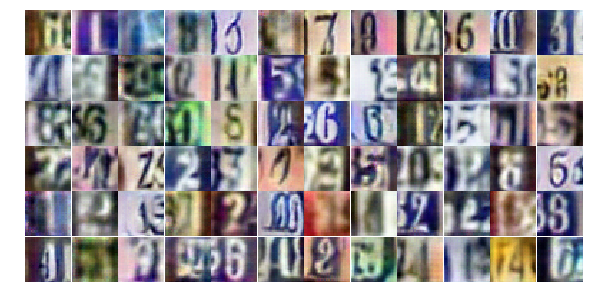

Epoch 22/25... Discriminator Loss: 0.6322... Generator Loss: 1.2460
Epoch 22/25... Discriminator Loss: 0.9811... Generator Loss: 0.7202
Epoch 22/25... Discriminator Loss: 1.0013... Generator Loss: 0.8352
Epoch 22/25... Discriminator Loss: 0.4994... Generator Loss: 1.6723
Epoch 22/25... Discriminator Loss: 0.3858... Generator Loss: 1.5850
Epoch 22/25... Discriminator Loss: 0.3058... Generator Loss: 5.4053
Epoch 22/25... Discriminator Loss: 0.9621... Generator Loss: 1.6799
Epoch 22/25... Discriminator Loss: 0.9386... Generator Loss: 0.8190
Epoch 22/25... Discriminator Loss: 1.0368... Generator Loss: 0.7453
Epoch 22/25... Discriminator Loss: 1.4370... Generator Loss: 0.4166


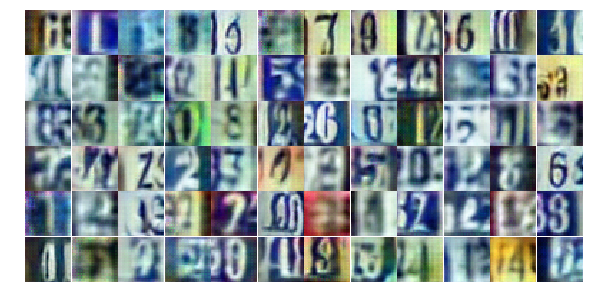

Epoch 22/25... Discriminator Loss: 0.6690... Generator Loss: 1.2614
Epoch 22/25... Discriminator Loss: 1.0328... Generator Loss: 0.9111
Epoch 22/25... Discriminator Loss: 1.1770... Generator Loss: 0.5658
Epoch 22/25... Discriminator Loss: 0.7799... Generator Loss: 0.9128
Epoch 22/25... Discriminator Loss: 0.9217... Generator Loss: 0.7360
Epoch 22/25... Discriminator Loss: 0.8348... Generator Loss: 0.8718
Epoch 22/25... Discriminator Loss: 0.9484... Generator Loss: 0.6652
Epoch 22/25... Discriminator Loss: 1.4165... Generator Loss: 0.8988
Epoch 22/25... Discriminator Loss: 0.7227... Generator Loss: 1.3986
Epoch 22/25... Discriminator Loss: 1.3750... Generator Loss: 0.6397


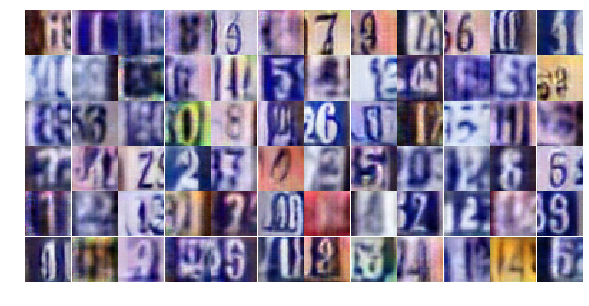

Epoch 22/25... Discriminator Loss: 1.0812... Generator Loss: 0.7994
Epoch 22/25... Discriminator Loss: 0.9348... Generator Loss: 1.1441
Epoch 22/25... Discriminator Loss: 0.8162... Generator Loss: 0.9295
Epoch 22/25... Discriminator Loss: 1.1617... Generator Loss: 0.6021
Epoch 22/25... Discriminator Loss: 0.8474... Generator Loss: 0.9999
Epoch 22/25... Discriminator Loss: 0.8311... Generator Loss: 0.8157
Epoch 22/25... Discriminator Loss: 0.8163... Generator Loss: 1.0126
Epoch 22/25... Discriminator Loss: 1.1574... Generator Loss: 0.6348
Epoch 22/25... Discriminator Loss: 1.1410... Generator Loss: 0.7770
Epoch 22/25... Discriminator Loss: 0.5094... Generator Loss: 1.2791


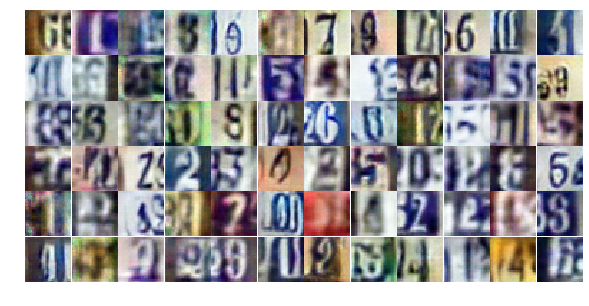

Epoch 22/25... Discriminator Loss: 1.4223... Generator Loss: 1.7383
Epoch 22/25... Discriminator Loss: 1.0456... Generator Loss: 0.7482
Epoch 22/25... Discriminator Loss: 1.2217... Generator Loss: 0.5454
Epoch 22/25... Discriminator Loss: 1.2333... Generator Loss: 0.6175
Epoch 22/25... Discriminator Loss: 1.1692... Generator Loss: 0.5223
Epoch 22/25... Discriminator Loss: 0.9139... Generator Loss: 1.2284
Epoch 22/25... Discriminator Loss: 1.4014... Generator Loss: 0.5381
Epoch 22/25... Discriminator Loss: 1.0330... Generator Loss: 0.7503
Epoch 22/25... Discriminator Loss: 1.2922... Generator Loss: 1.5758
Epoch 22/25... Discriminator Loss: 0.7541... Generator Loss: 0.9554


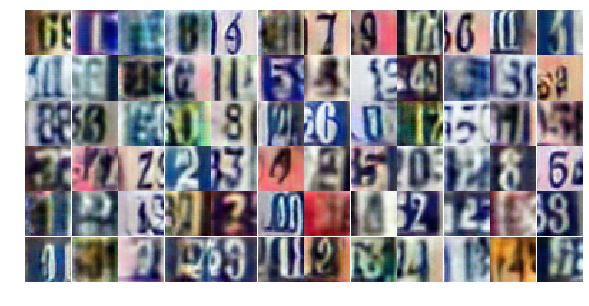

Epoch 23/25... Discriminator Loss: 0.6226... Generator Loss: 1.1013
Epoch 23/25... Discriminator Loss: 0.4254... Generator Loss: 1.6961
Epoch 23/25... Discriminator Loss: 1.2229... Generator Loss: 0.8493
Epoch 23/25... Discriminator Loss: 0.7404... Generator Loss: 1.4251
Epoch 23/25... Discriminator Loss: 0.9200... Generator Loss: 0.9893
Epoch 23/25... Discriminator Loss: 1.8789... Generator Loss: 0.2592
Epoch 23/25... Discriminator Loss: 1.8934... Generator Loss: 0.2776
Epoch 23/25... Discriminator Loss: 1.1810... Generator Loss: 0.6216
Epoch 23/25... Discriminator Loss: 1.1199... Generator Loss: 0.6213
Epoch 23/25... Discriminator Loss: 0.5102... Generator Loss: 1.8906


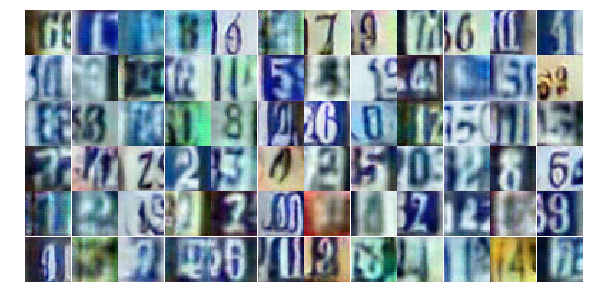

Epoch 23/25... Discriminator Loss: 0.5541... Generator Loss: 1.2057
Epoch 23/25... Discriminator Loss: 0.2616... Generator Loss: 1.7726
Epoch 23/25... Discriminator Loss: 0.1212... Generator Loss: 2.7456
Epoch 23/25... Discriminator Loss: 0.2430... Generator Loss: 1.9234
Epoch 23/25... Discriminator Loss: 0.0458... Generator Loss: 3.7508
Epoch 23/25... Discriminator Loss: 0.0318... Generator Loss: 5.7843
Epoch 23/25... Discriminator Loss: 0.1814... Generator Loss: 2.2098
Epoch 23/25... Discriminator Loss: 0.0665... Generator Loss: 3.4464
Epoch 23/25... Discriminator Loss: 0.0300... Generator Loss: 4.9114
Epoch 23/25... Discriminator Loss: 0.1019... Generator Loss: 3.2194


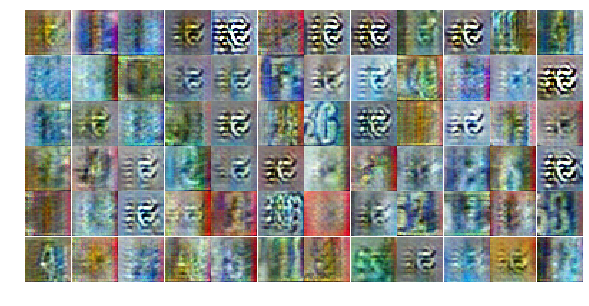

Epoch 23/25... Discriminator Loss: 0.0146... Generator Loss: 5.2362
Epoch 23/25... Discriminator Loss: 0.0603... Generator Loss: 3.9281
Epoch 23/25... Discriminator Loss: 0.0161... Generator Loss: 5.1497
Epoch 23/25... Discriminator Loss: 0.0071... Generator Loss: 6.0713
Epoch 23/25... Discriminator Loss: 0.0121... Generator Loss: 6.2139
Epoch 23/25... Discriminator Loss: 0.0174... Generator Loss: 5.3555
Epoch 23/25... Discriminator Loss: 0.0283... Generator Loss: 4.4006
Epoch 23/25... Discriminator Loss: 0.0263... Generator Loss: 4.5057
Epoch 23/25... Discriminator Loss: 0.0048... Generator Loss: 7.4695
Epoch 23/25... Discriminator Loss: 0.0356... Generator Loss: 4.8350


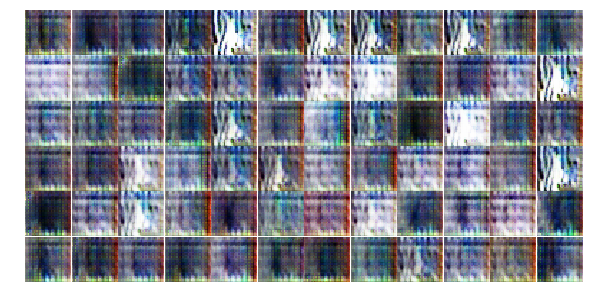

Epoch 23/25... Discriminator Loss: 0.0497... Generator Loss: 3.9377
Epoch 23/25... Discriminator Loss: 0.1139... Generator Loss: 6.5598
Epoch 23/25... Discriminator Loss: 1.6616... Generator Loss: 1.2139
Epoch 23/25... Discriminator Loss: 0.8969... Generator Loss: 1.2202
Epoch 23/25... Discriminator Loss: 0.3856... Generator Loss: 2.4080
Epoch 23/25... Discriminator Loss: 0.0402... Generator Loss: 4.6547
Epoch 23/25... Discriminator Loss: 0.7199... Generator Loss: 3.9339
Epoch 23/25... Discriminator Loss: 0.2327... Generator Loss: 2.6770
Epoch 23/25... Discriminator Loss: 0.2384... Generator Loss: 2.9529
Epoch 23/25... Discriminator Loss: 0.3124... Generator Loss: 2.0250


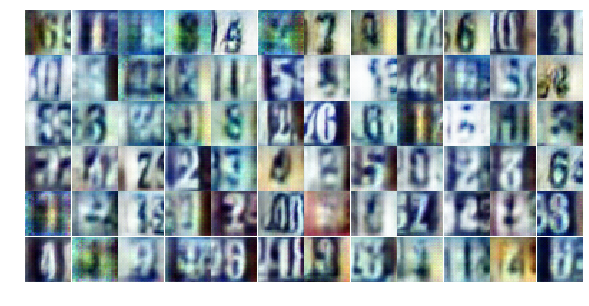

Epoch 23/25... Discriminator Loss: 0.7349... Generator Loss: 2.2748
Epoch 23/25... Discriminator Loss: 0.7991... Generator Loss: 1.0244
Epoch 23/25... Discriminator Loss: 0.6377... Generator Loss: 1.2520
Epoch 23/25... Discriminator Loss: 0.5250... Generator Loss: 1.4398
Epoch 23/25... Discriminator Loss: 0.7398... Generator Loss: 1.1256
Epoch 23/25... Discriminator Loss: 0.7266... Generator Loss: 1.2522
Epoch 23/25... Discriminator Loss: 0.6657... Generator Loss: 1.3357
Epoch 23/25... Discriminator Loss: 1.3649... Generator Loss: 0.4614
Epoch 23/25... Discriminator Loss: 0.6723... Generator Loss: 1.2440
Epoch 23/25... Discriminator Loss: 0.6217... Generator Loss: 1.1603


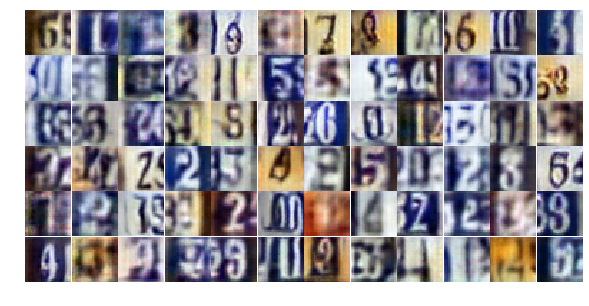

Epoch 23/25... Discriminator Loss: 1.4170... Generator Loss: 0.4086
Epoch 23/25... Discriminator Loss: 1.5853... Generator Loss: 0.3376
Epoch 23/25... Discriminator Loss: 1.2912... Generator Loss: 0.5144
Epoch 23/25... Discriminator Loss: 0.7094... Generator Loss: 1.7998
Epoch 23/25... Discriminator Loss: 1.1183... Generator Loss: 0.6109
Epoch 23/25... Discriminator Loss: 0.6263... Generator Loss: 1.1601
Epoch 23/25... Discriminator Loss: 0.4938... Generator Loss: 1.5982
Epoch 24/25... Discriminator Loss: 1.0341... Generator Loss: 0.8112
Epoch 24/25... Discriminator Loss: 1.7260... Generator Loss: 1.7769
Epoch 24/25... Discriminator Loss: 1.7636... Generator Loss: 0.2970


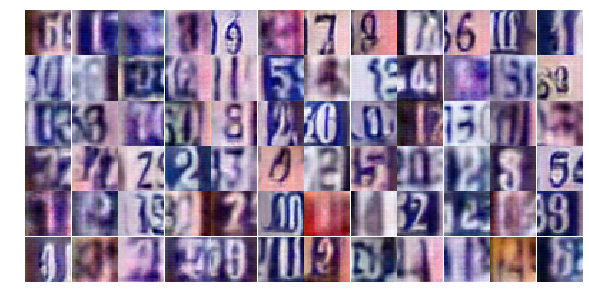

Epoch 24/25... Discriminator Loss: 0.8432... Generator Loss: 1.4220
Epoch 24/25... Discriminator Loss: 1.6200... Generator Loss: 3.7648
Epoch 24/25... Discriminator Loss: 0.7937... Generator Loss: 0.9717
Epoch 24/25... Discriminator Loss: 0.7343... Generator Loss: 1.9957
Epoch 24/25... Discriminator Loss: 0.9440... Generator Loss: 0.7962
Epoch 24/25... Discriminator Loss: 1.5284... Generator Loss: 0.3950
Epoch 24/25... Discriminator Loss: 0.9178... Generator Loss: 1.0509
Epoch 24/25... Discriminator Loss: 1.2084... Generator Loss: 0.5884
Epoch 24/25... Discriminator Loss: 0.5774... Generator Loss: 1.3974
Epoch 24/25... Discriminator Loss: 0.7516... Generator Loss: 1.2222


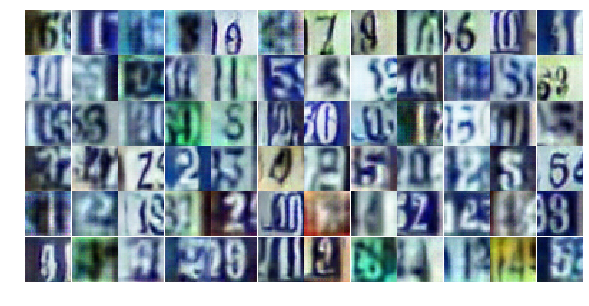

Epoch 24/25... Discriminator Loss: 1.0202... Generator Loss: 0.9997
Epoch 24/25... Discriminator Loss: 1.1394... Generator Loss: 0.8074
Epoch 24/25... Discriminator Loss: 1.5712... Generator Loss: 0.3440
Epoch 24/25... Discriminator Loss: 0.9914... Generator Loss: 0.6268
Epoch 24/25... Discriminator Loss: 0.8672... Generator Loss: 1.0468
Epoch 24/25... Discriminator Loss: 0.9186... Generator Loss: 1.2046
Epoch 24/25... Discriminator Loss: 0.7307... Generator Loss: 1.0974
Epoch 24/25... Discriminator Loss: 1.1408... Generator Loss: 0.7118
Epoch 24/25... Discriminator Loss: 1.0751... Generator Loss: 0.6806
Epoch 24/25... Discriminator Loss: 1.3485... Generator Loss: 0.4540


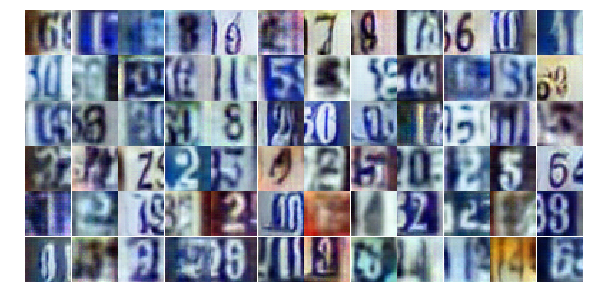

Epoch 24/25... Discriminator Loss: 0.2532... Generator Loss: 3.2634
Epoch 24/25... Discriminator Loss: 0.7291... Generator Loss: 1.2317
Epoch 24/25... Discriminator Loss: 1.0878... Generator Loss: 0.6730
Epoch 24/25... Discriminator Loss: 2.1007... Generator Loss: 0.2031
Epoch 24/25... Discriminator Loss: 0.4933... Generator Loss: 1.4981
Epoch 24/25... Discriminator Loss: 0.5696... Generator Loss: 1.4446
Epoch 24/25... Discriminator Loss: 0.7922... Generator Loss: 1.3331
Epoch 24/25... Discriminator Loss: 1.0687... Generator Loss: 0.6414
Epoch 24/25... Discriminator Loss: 0.7526... Generator Loss: 1.0731
Epoch 24/25... Discriminator Loss: 1.0827... Generator Loss: 0.8397


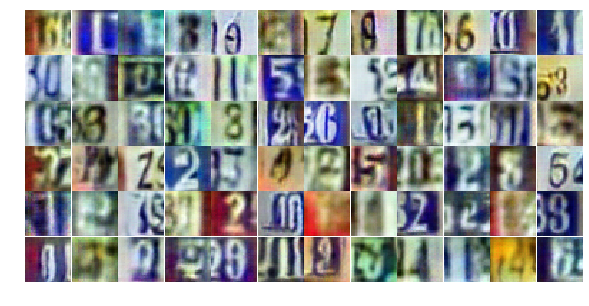

Epoch 24/25... Discriminator Loss: 0.2310... Generator Loss: 3.4680
Epoch 24/25... Discriminator Loss: 0.2743... Generator Loss: 1.8294
Epoch 24/25... Discriminator Loss: 0.2348... Generator Loss: 2.1314
Epoch 24/25... Discriminator Loss: 0.5692... Generator Loss: 1.2483
Epoch 24/25... Discriminator Loss: 0.3028... Generator Loss: 1.7891
Epoch 24/25... Discriminator Loss: 1.4748... Generator Loss: 0.4194
Epoch 24/25... Discriminator Loss: 1.4443... Generator Loss: 0.4243
Epoch 24/25... Discriminator Loss: 0.7662... Generator Loss: 1.0762
Epoch 24/25... Discriminator Loss: 0.9435... Generator Loss: 0.8367
Epoch 24/25... Discriminator Loss: 0.9706... Generator Loss: 0.9198


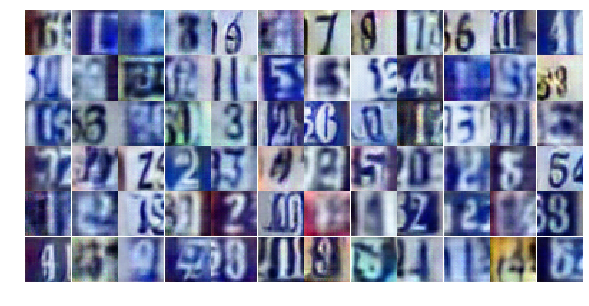

Epoch 24/25... Discriminator Loss: 0.9608... Generator Loss: 0.7888
Epoch 24/25... Discriminator Loss: 1.5622... Generator Loss: 0.3793
Epoch 24/25... Discriminator Loss: 1.4302... Generator Loss: 0.4688
Epoch 24/25... Discriminator Loss: 1.3923... Generator Loss: 0.5416
Epoch 24/25... Discriminator Loss: 1.2520... Generator Loss: 0.7919
Epoch 24/25... Discriminator Loss: 0.5758... Generator Loss: 2.9974
Epoch 24/25... Discriminator Loss: 1.4380... Generator Loss: 0.4671
Epoch 24/25... Discriminator Loss: 1.3899... Generator Loss: 0.4818
Epoch 24/25... Discriminator Loss: 1.2768... Generator Loss: 0.6300
Epoch 24/25... Discriminator Loss: 1.5429... Generator Loss: 0.4237


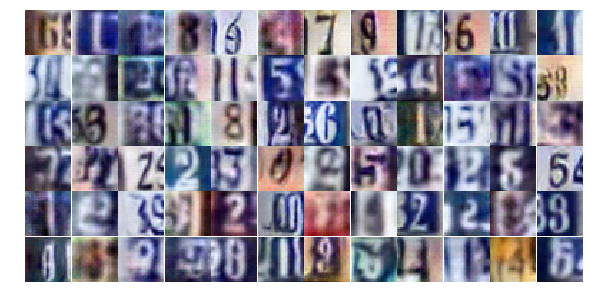

Epoch 24/25... Discriminator Loss: 1.0345... Generator Loss: 0.6704
Epoch 24/25... Discriminator Loss: 1.6260... Generator Loss: 0.4002
Epoch 24/25... Discriminator Loss: 1.3864... Generator Loss: 0.4664
Epoch 24/25... Discriminator Loss: 0.5336... Generator Loss: 1.8276
Epoch 24/25... Discriminator Loss: 0.7884... Generator Loss: 0.9515
Epoch 25/25... Discriminator Loss: 0.5273... Generator Loss: 1.4570
Epoch 25/25... Discriminator Loss: 0.3181... Generator Loss: 1.6328
Epoch 25/25... Discriminator Loss: 1.1180... Generator Loss: 0.6063
Epoch 25/25... Discriminator Loss: 1.6406... Generator Loss: 0.3913
Epoch 25/25... Discriminator Loss: 0.9476... Generator Loss: 0.8530


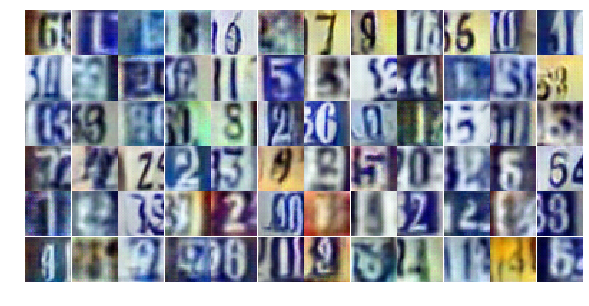

Epoch 25/25... Discriminator Loss: 0.7611... Generator Loss: 1.0812
Epoch 25/25... Discriminator Loss: 1.2108... Generator Loss: 0.5508
Epoch 25/25... Discriminator Loss: 0.1236... Generator Loss: 3.1762
Epoch 25/25... Discriminator Loss: 0.6358... Generator Loss: 1.5663
Epoch 25/25... Discriminator Loss: 0.0559... Generator Loss: 4.8369
Epoch 25/25... Discriminator Loss: 0.8163... Generator Loss: 1.0121
Epoch 25/25... Discriminator Loss: 1.1666... Generator Loss: 0.7422
Epoch 25/25... Discriminator Loss: 0.9335... Generator Loss: 0.8644
Epoch 25/25... Discriminator Loss: 0.9105... Generator Loss: 0.9179
Epoch 25/25... Discriminator Loss: 1.4452... Generator Loss: 0.4576


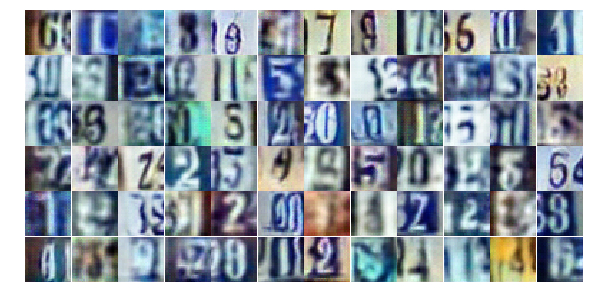

Epoch 25/25... Discriminator Loss: 0.8921... Generator Loss: 1.0102
Epoch 25/25... Discriminator Loss: 0.9218... Generator Loss: 2.2183
Epoch 25/25... Discriminator Loss: 1.4256... Generator Loss: 0.5427
Epoch 25/25... Discriminator Loss: 0.9958... Generator Loss: 0.7161
Epoch 25/25... Discriminator Loss: 0.9314... Generator Loss: 0.9756
Epoch 25/25... Discriminator Loss: 0.7578... Generator Loss: 1.1287
Epoch 25/25... Discriminator Loss: 1.1146... Generator Loss: 1.1647
Epoch 25/25... Discriminator Loss: 1.5538... Generator Loss: 0.8752
Epoch 25/25... Discriminator Loss: 0.9775... Generator Loss: 1.1540
Epoch 25/25... Discriminator Loss: 1.1324... Generator Loss: 0.7390


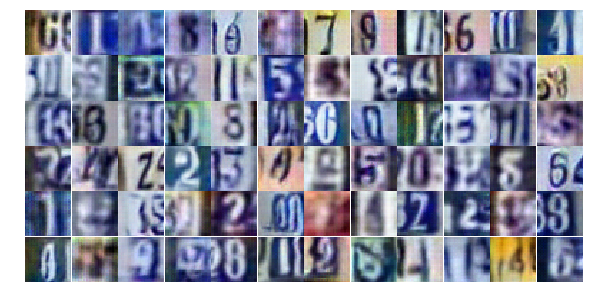

Epoch 25/25... Discriminator Loss: 1.2442... Generator Loss: 0.5921
Epoch 25/25... Discriminator Loss: 0.9029... Generator Loss: 0.7759
Epoch 25/25... Discriminator Loss: 1.9987... Generator Loss: 0.2458
Epoch 25/25... Discriminator Loss: 0.8807... Generator Loss: 1.2191
Epoch 25/25... Discriminator Loss: 1.0055... Generator Loss: 0.8404
Epoch 25/25... Discriminator Loss: 0.7958... Generator Loss: 0.9819
Epoch 25/25... Discriminator Loss: 1.0143... Generator Loss: 0.7319
Epoch 25/25... Discriminator Loss: 0.7406... Generator Loss: 0.9554
Epoch 25/25... Discriminator Loss: 1.2031... Generator Loss: 1.1279
Epoch 25/25... Discriminator Loss: 0.8178... Generator Loss: 1.1324


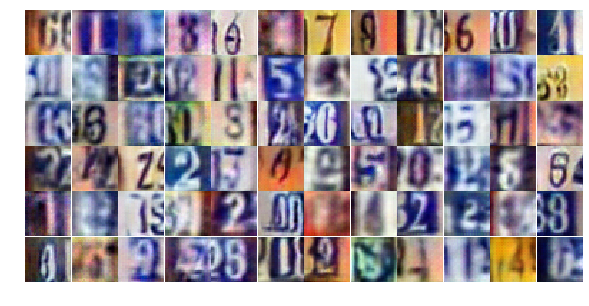

Epoch 25/25... Discriminator Loss: 1.0769... Generator Loss: 0.7209
Epoch 25/25... Discriminator Loss: 0.8831... Generator Loss: 0.8926
Epoch 25/25... Discriminator Loss: 0.6553... Generator Loss: 1.6626
Epoch 25/25... Discriminator Loss: 0.7168... Generator Loss: 1.1502
Epoch 25/25... Discriminator Loss: 0.9980... Generator Loss: 1.1564
Epoch 25/25... Discriminator Loss: 1.2787... Generator Loss: 0.9981
Epoch 25/25... Discriminator Loss: 1.2877... Generator Loss: 0.7175
Epoch 25/25... Discriminator Loss: 1.1006... Generator Loss: 0.7467
Epoch 25/25... Discriminator Loss: 2.4008... Generator Loss: 0.2131
Epoch 25/25... Discriminator Loss: 0.8213... Generator Loss: 0.8719


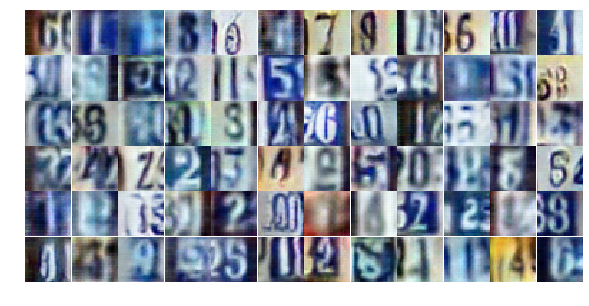

Epoch 25/25... Discriminator Loss: 1.2115... Generator Loss: 0.8467
Epoch 25/25... Discriminator Loss: 0.9539... Generator Loss: 0.8585
Epoch 25/25... Discriminator Loss: 0.3124... Generator Loss: 1.7529
Epoch 25/25... Discriminator Loss: 0.1006... Generator Loss: 3.1752
Epoch 25/25... Discriminator Loss: 1.2464... Generator Loss: 0.5305
Epoch 25/25... Discriminator Loss: 0.9281... Generator Loss: 0.8905
Epoch 25/25... Discriminator Loss: 1.2440... Generator Loss: 0.8334
Epoch 25/25... Discriminator Loss: 0.9926... Generator Loss: 0.8091
Epoch 25/25... Discriminator Loss: 1.2499... Generator Loss: 0.5491
Epoch 25/25... Discriminator Loss: 1.5196... Generator Loss: 0.4244


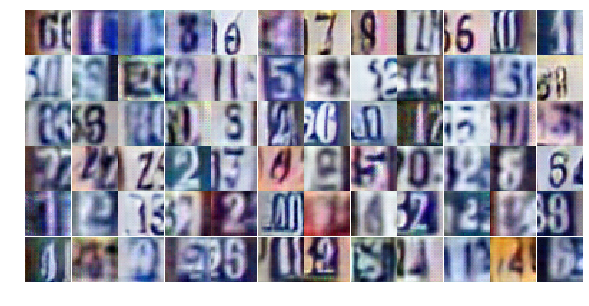

Epoch 25/25... Discriminator Loss: 0.6729... Generator Loss: 1.4264
Epoch 25/25... Discriminator Loss: 2.0914... Generator Loss: 0.2385


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

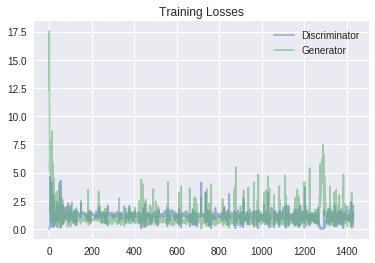

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

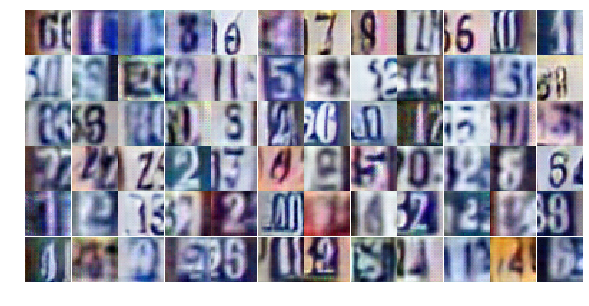

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))